In [5]:
cd C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1

C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1


In [6]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import glob
import os
import cv2
import h5py
import pickle
import sys
import scipy.io
from scipy.spatial import distance
%matplotlib inline

In [7]:
os.environ['COMPUTERNAME']

'CELLBIOAJE001'

In [8]:
currPath = os.getcwd()
if os.environ['COMPUTERNAME'] == 'DESKTOP-TM6H8BH': ## on home desktop
    sys.path.append(r'C:\Users\ajema\OneDrive\Documents\GitHub\analyzeMEA')
elif (os.environ['COMPUTERNAME'] == 'CELLBIOAJE001') or (os.environ['COMPUTERNAME'] == 'CELLBIOAJE005'):
    sys.path.append(r'C:\Users\ajemanu\Documents\GitHub\analyzeMEA')
else:
    sys.path.append('C://Users/Alan/Documents/Github/analyzeMEA')
import analyzeMEA

In [9]:
## LFP analyses

LFPs = np.load('gratings_221216_115347/LFPs.npy')
LFPs *= 0.195 ## converting to microVolts
stims = np.load('gratings_221216_115347/stims.npy')
meanPower500_5000s = np.load('gratings_221216_115347/meanPower500_5000s.npy')
sweepOnsetArray = np.load('gratings_221216_115347/sweepOnsetArray.npy') #  sweepOnsets - ndarray with downsampled samples at which trigger signal turned on
depthIndex = np.load(r"C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\poly2_depthIndex.npy")
channelOrders = np.load(r"C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\poly2_channelOrders.npy")

In [12]:
deg_files = glob.glob('*predictions.csv')
deg_files.sort(key=lambda x: x[-35:])
print(deg_files)
ffDict = analyzeMEA.wheel.find_footfalls_DEG(deg_files)
footfalls = ffDict['footfalls_filtered']

['s1-12162022115204-0000_predictions.csv', 's2-12162022115854-0000_predictions.csv', 's3-12162022120441-0000_predictions.csv', 's4-12162022120956-0000_predictions.csv', 's5-12162022121715-0000_predictions.csv', 's6-12162022122324-0000_predictions.csv', 's7-12162022122839-0000_predictions.csv', 's8-12162022123449-0000_predictions.csv', 's9-12162022125049-0000_predictions.csv', 's10-12162022125643-0000_predictions.csv']
foot in contact at beginning of recording
foot not in contact at end of recording


In [14]:
matFiles = glob.glob('*[0-9].mat')
matFiles.sort(key=os.path.getmtime)
ventralCamTrigger_sweeps = []
for file in matFiles:
    ventralCamTrigger_sweeps.append(scipy.io.loadmat(file)['ventralcameratrigger'])
frameSamples_sweeps_ds = [] ## downsampling to match LFP sampling rate
for sweep in ventralCamTrigger_sweeps:
    frameSamples_sweeps_ds.append(np.int32(np.where(sweep[1:] > sweep[:-1])[0]/10))

In [16]:
## aligning LFPs to contact events
LFPs_ffs = np.zeros([32, 1000,len(footfalls)])
for i, ff in enumerate(footfalls):
    sweep = sum(ffDict['labels']['Unnamed: 0'][:ff] == 0) - 1
    frame = ffDict['labels']['Unnamed: 0'][ff]
    
    
    if sweep < 4:
        start = int(frameSamples_sweeps_ds[sweep][frame] + sweepOnsetArray[sweep] - 500)
        end = int(frameSamples_sweeps_ds[sweep][frame] + sweepOnsetArray[sweep] + 500)
        #print(start,end)
        LFPs_ffs[:,:,i] = LFPs[:,start:end]
    #print(frameSamples_sweeps_ds[sweep][frame])

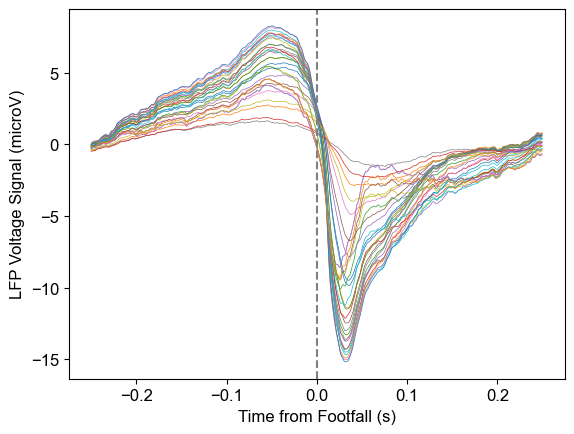

In [19]:
for ch in range(32):
    plt.plot(np.arange(-0.25,0.25,1/2000),LFPs_ffs[ch,:,:].mean(-1),lw=0.5)
plt.xlabel('Time from Footfall (s)')
plt.ylabel('LFP Voltage Signal (microV)')
plt.axvline(0,ls='--',color='gray')

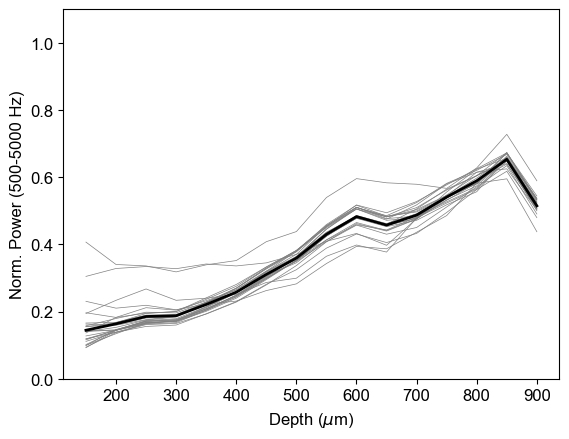

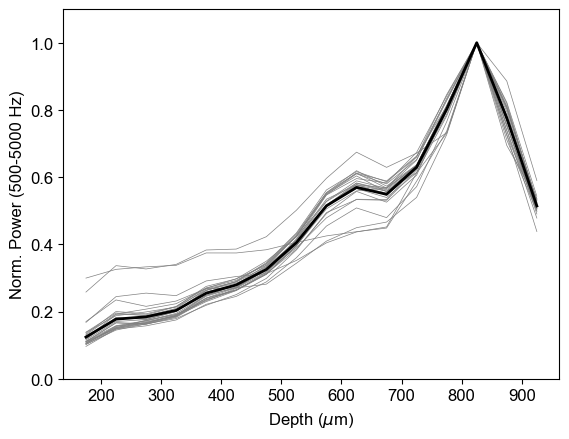

In [20]:
depthOfTopSite = 150 # microns

meanMeanPower = np.mean(meanPower500_5000s,axis=1)[depthIndex]
plt.plot(np.array(channelOrders)[depthIndex][0::2]*25+depthOfTopSite,meanMeanPower[0::2]/np.max(meanMeanPower),linewidth=2,color='k')
for i, spectrum in enumerate(np.transpose(meanPower500_5000s)):
    plt.plot(np.array(channelOrders)[depthIndex][0::2]*25+depthOfTopSite,
             np.array(spectrum)[depthIndex][0::2]/np.max(spectrum),color='gray',linewidth=0.5,zorder=-1)
plt.ylim([0,1.1])
plt.ylabel('Norm. Power (500-5000 Hz)')
plt.xlabel('Depth ($\\mu$m)')
plt.savefig('500-5kPower_right.png',dpi=300)
plt.show()
plt.close()

meanMeanPower = np.mean(meanPower500_5000s,axis=1)[depthIndex]
plt.plot(np.array(channelOrders)[depthIndex][1::2]*25+depthOfTopSite,meanMeanPower[1::2]/np.max(meanMeanPower),linewidth=2,color='k')
for i, spectrum in enumerate(np.transpose(meanPower500_5000s)):
    plt.plot(np.array(channelOrders)[depthIndex][1::2]*25+depthOfTopSite,
             np.array(spectrum)[depthIndex][1::2]/np.max(spectrum),color='gray',linewidth=0.5,zorder=-1)
plt.ylim([0,1.1])
plt.ylabel('Norm. Power (500-5000 Hz)')
plt.xlabel('Depth ($\\mu$m)')
plt.savefig('500-5kPower_left.png',dpi=300)
plt.show()
plt.close()

In [21]:
LFPs_ffs.shape

(32, 1000, 2450)

Text(0.5, 1.0, 'Right Channels')

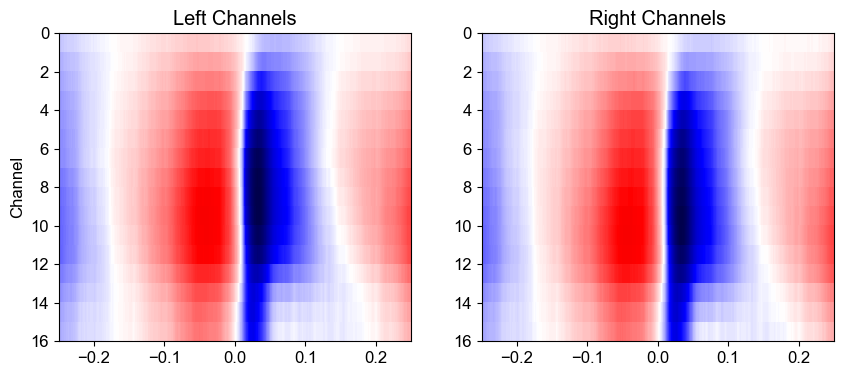

In [22]:



f, ax = plt.subplots(1,2,figsize=[10,4])
meanLFP_left = np.mean(LFPs_ffs[depthIndex[1::2],:,:],axis=-1)
meanLFP_left_detrended = scipy.signal.detrend(meanLFP_left,axis=1)
meanLFP_left_normed = meanLFP_left_detrended / np.max(np.abs(meanLFP_left_detrended))
ax[0].imshow(meanLFP_left_normed,aspect='auto',cmap='seismic',clim=[-1,1],interpolation='none',extent=[-0.25,0.25,16,0])
ax[0].set_title('Left Channels')
ax[0].set_ylabel('Channel')

meanLFP_right = np.mean(LFPs_ffs[depthIndex[::2],:,:],axis=-1)
meanLFP_right_detrended = scipy.signal.detrend(meanLFP_right,axis=1)
meanLFP_right_normed = meanLFP_right_detrended / np.max(np.abs(meanLFP_right_detrended))
ax[1].imshow(meanLFP_right_normed,aspect='auto',cmap='seismic',clim=[-1,1],interpolation='none',extent=[-0.25,0.25,16,0])
ax[1].set_title('Right Channels')


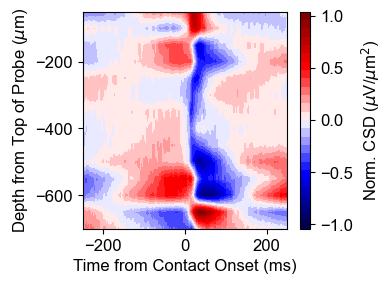

In [23]:
## for right array
meanLFPs = {}
detrend = True
X = np.arange(-250,250,1/2)
Y = -np.arange(50,750,50)

meanLFP = np.mean(LFPs_ffs[depthIndex[0::2],:,:],axis=-1)
if detrend:
    meanLFP = scipy.signal.detrend(meanLFP,axis=1)

csd = np.diff(meanLFP*-1,n=2,axis=0)
csdMax = np.max(np.abs(csd))

plt.figure(figsize=[4,3])

plt.contourf(X,Y,csd/csdMax,25,vmin=-1,vmax=1,cmap='seismic',origin='upper')
cb = plt.colorbar()
cb.set_ticks([-1,-0.5,0,0.5,1])
cb.set_label('Norm. CSD ($\mu$V/$\mu$m$^{2}$)')
plt.ylabel('Depth from Top of Probe ($\mu$m)')
plt.xlabel('Time from Contact Onset (ms)')

plt.tight_layout()
plt.savefig('Right_CSD.png',dpi=300,transparent=True)
plt.show()
plt.close() 
    

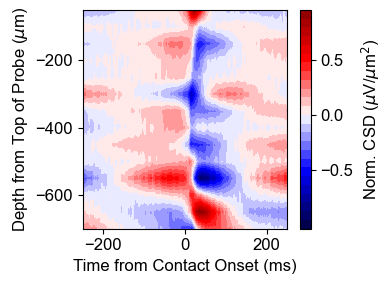

In [25]:
## for left array
meanLFPs = {}
detrend = True
X = np.arange(-250,250,1/2)
Y = -np.arange(50,750,50)

meanLFP = np.mean(LFPs_ffs[depthIndex[1::2],:,:],axis=-1)
if detrend:
    meanLFP = scipy.signal.detrend(meanLFP,axis=1)

csd = np.diff(meanLFP*-1,n=2,axis=0)
csdMax = np.max(np.abs(csd))

plt.figure(figsize=[4,3])

plt.contourf(X,Y,csd/csdMax,25,vmin=-1,vmax=1.0,cmap='seismic',origin='upper')
cb = plt.colorbar()
cb.set_ticks([-0.5,0,0.5])
cb.set_label('Norm. CSD ($\mu$V/$\mu$m$^{2}$)')
plt.ylabel('Depth from Top of Probe ($\mu$m)')
plt.xlabel('Time from Contact Onset (ms)')

plt.tight_layout()
plt.savefig('Left_CSD.png',dpi=300,transparent=True)
plt.show()
plt.close() 
    

meta NOT subset; don't know how to subset; dropped


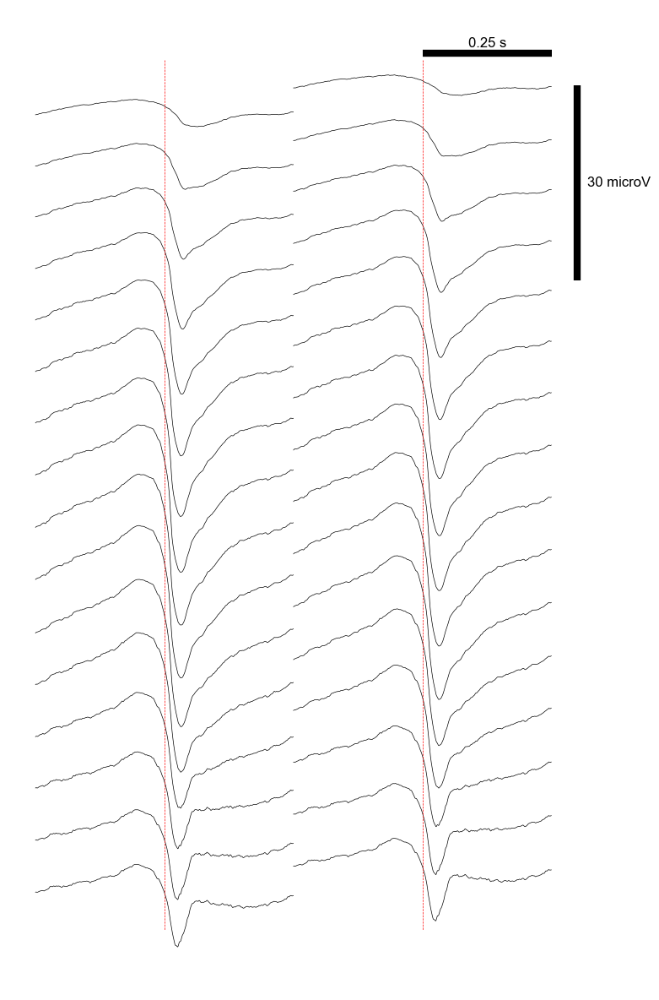

In [26]:
import matplotlib
matplotlib.rcParams['font.sans-serif'] = 'Arial'
plt.figure(figsize=(8,12))
ax = plt.axes()
yscale = 50
for i, channel in  enumerate(depthIndex):
    if i % 2 == 0:
        ax.plot(np.arange(-0.25,0.25,1/2000),np.mean(LFPs_ffs[channel,:,:]*yscale-200*i,axis=-1),linewidth=0.5,color='k')
    else:
        ax.plot(np.arange(-0.25,0.25,1/2000)-0.5,np.mean(LFPs_ffs[channel,:,:]*yscale-200*i,axis=-1),linewidth=0.5,color='k')
ll = ax.plot([0.3,0.3],np.array([0,-30*yscale]),scalex=False,color='k',linewidth=6,solid_capstyle='butt')
ll[0].set_clip_on(False)
ll_time = ax.plot([0,0.25],[yscale*5,yscale*5],scalex=False,scaley=False,color='k',linewidth=6,solid_capstyle='butt')
ll_time_text = ax.text(0.125,yscale*5.5,'0.25 s',ha='center',verticalalignment='bottom')
llText = ax.text(0.32,-30*yscale/2,'30 microV',horizontalalignment='left',verticalalignment='center') ## this is actually microV
ax.plot([0,0],[200,-6500],color='r',linestyle='--',linewidth=0.5)
ax.plot([-0.5,-0.5],[200,-6500],color='r',linestyle='--',linewidth=0.5)
for spine in ax.spines:
    ax.spines[spine].set_visible(False)
ax.set_xticks([])
ax.set_yticks([])
plt.tight_layout()
plt.savefig('LFP_ffs.pdf',transparent=True)

(0.0, 300.0)

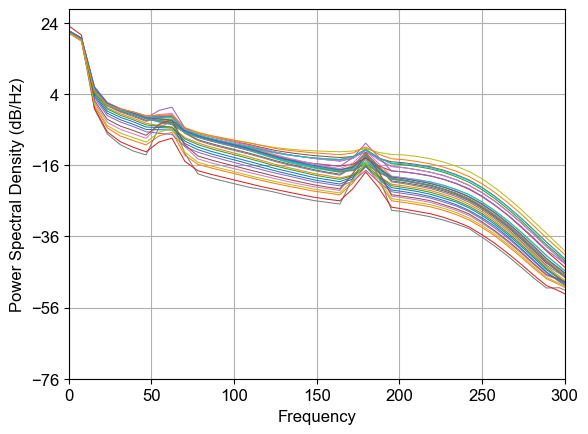

In [31]:
for ch in range(32):
    plt.psd(LFPs[ch,:],Fs=2000,scale_by_freq=True,lw=0.75,)
plt.xlim([0,300])

In [8]:
### saving parameters for gait analyses


videos_ventral = glob.glob('v*.avi')
videos_ventral.sort(key=os.path.getmtime) ## sort by modification time -- use regular expressions if mtime is changed
dlcFiles_ventral = []
for video in videos_ventral:
    dlcFiles_ventral.append(glob.glob(video[:-4]+'*filtered.h5'))
dlcFiles_ventral = np.concatenate(dlcFiles_ventral)



deg_files = glob.glob('*predictions.csv')
deg_files.sort(key=lambda x: x[-35:])
print(deg_files)
ffDict = analyzeMEA.wheel.find_footfalls_DEG(deg_files)
footfalls = ffDict['footfalls_filtered']
RFPposition = []
LFPposition = []
for i, file in enumerate(dlcFiles_ventral):
    print('loading paw positions, file {}'.format(file))
    DLCmodel = pd.read_hdf(file).keys()[0][0]
    RFPposition.append(pd.read_hdf(file)[DLCmodel]['rightForepaw'])
    LFPposition.append(pd.read_hdf(file)[DLCmodel]['leftForepaw'])
RFPposition = np.concatenate(RFPposition)
LFPposition = np.concatenate(LFPposition)


ffDict['RFPpositions_ff_filtered'] = RFPposition[footfalls]
ffDict['LFPpositions_ff_filtered'] = LFPposition[footfalls]
ffDict['RFP-LFP_distance'] = np.array([distance.euclidean(x,y) for x,y in zip(ffDict['RFPpositions_ff_filtered'], ffDict['LFPpositions_ff_filtered'])])

### loading orientations
allOrientations = np.zeros(len(footfalls))
orientations = np.load('gratingClassifications_AE.npy')
# this is a gratings-first recording
allOrientations[:] = np.append(orientations,orientations[-1])
ffDict['orientations'] = allOrientations
with open('ffDict.pickle','wb') as file:
    pickle.dump(ffDict,file)
print('finished')

['s1-12162022115204-0000_predictions.csv', 's2-12162022115854-0000_predictions.csv', 's3-12162022120441-0000_predictions.csv', 's4-12162022120956-0000_predictions.csv', 's5-12162022121715-0000_predictions.csv', 's6-12162022122324-0000_predictions.csv', 's7-12162022122839-0000_predictions.csv', 's8-12162022123449-0000_predictions.csv', 's9-12162022125049-0000_predictions.csv', 's10-12162022125643-0000_predictions.csv']
foot in contact at beginning of recording
foot not in contact at end of recording
loading paw positions, file v10-12162022125649-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_filtered.h5
loading paw positions, file v1-12162022115202-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_filtered.h5
loading paw positions, file v2-12162022115855-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_filtered.h5
loading paw positions, file v3-12162022120445-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_filtered.h5
loading paw positions, file v4-1216

In [5]:
def rotate_image(image, angle):
    image_center = tuple(np.array(image.shape[1::-1]) / 2)
    rot_mat = cv2.getRotationMatrix2D(image_center, angle, 1.0)
    result = cv2.warpAffine(image, rot_mat, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    return result
def rotate_point(center,angle,point):
    s = np.sin(angle/360*2*np.pi)
    c = np.cos(angle/360*2*np.pi)

    # translate point back to origin:
    point[0] -= center[0]
    point[1] -= center[1]

    # rotate point
    xnew = point[0] * c - point[1] * s
    ynew = point[0] * s + point[1] * c

    # translate point back:
    p = np.zeros(2)
    p[0] = xnew + center[0]
    p[1] = ynew + center[1]
    return p

def rotate_points(center,angle,points):
   
    theta = angle/360*2*np.pi # convert to radians
    A = [[np.cos(theta), -np.sin(theta)],
         [np.sin(theta),  np.cos(theta)]]
    
    temp = points - center
    
    temp = np.matmul(temp,A)
    return temp + center

In [6]:
# bumpData = r'Z:/HarveyLab/Tier1/Alan/Data/20220831/sparse_bumps_wheel_v2_220712_data.mat'
# gratingsData = r'Z:/HarveyLab/Tier1/Alan/Data/20220831/gratings_wheel_v2_220715_data.mat'
# ## extract depth map from 3D printer data
# depthMap = np.array(h5py.File(bumpData,'r')['top_depth_map'])[300:-300,:]
# depthMap_gratings = np.array(h5py.File(gratingsData,'r')['top_depth_map'])[300:-300,:]
# ## scale depth map values to image values
# depthMap = depthMap * 255/0.75
# depthMap_gratings = depthMap_gratings * 255/0.7

In [7]:
# plt.imshow(depthMap)
# plt.xlim([8000,10000])

In [8]:
# plt.figure(figsize=[30,10])
# plt.imshow(depthMap,cmap='gray')
# plt.xticks([])
# plt.yticks([])

In [9]:
## find behavior video names
videos_ventral = glob.glob('v*.avi')
videos_ventral.sort(key=lambda x: x[-23:]) ## sorting by file name timestamp

videos_side = glob.glob('s*.avi')
videos_side.sort(key=lambda x: x[-23:])  ## sorting by file name timestamp

In [10]:
## find keypoint intensity files
kpFiles_ventral = []
for video in videos_ventral: ## ensuring same order as videos
    kpFiles_ventral.append(glob.glob(video[:-4]+'*_keypointIntensities.h5'))
kpFiles_ventral = np.concatenate(kpFiles_ventral)

kpFiles_side = []
for video in videos_side: ## ensuring same order as videos
    kpFiles_side.append(glob.glob(video[:-4]+'*_keypointIntensities.h5'))
kpFiles_side = np.concatenate(kpFiles_side)

In [11]:
kpFiles_ventral

array(['v1-12162022115202-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_keypointIntensities.h5',
       'v2-12162022115855-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_keypointIntensities.h5',
       'v3-12162022120445-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_keypointIntensities.h5',
       'v4-12162022120959-0000DLC_resnet50_wheel_mirror_gratingsSep19shuffle1_361000_keypointIntensities.h5',
       'v5-12162022121716-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_keypointIntensities.h5',
       'v6-12162022122320-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_keypointIntensities.h5',
       'v7-12162022122844-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_keypointIntensities.h5',
       'v8-12162022123455-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_keypointIntensities.h5',
       'v9-12162022125057-0000DLC_resnet50_WideGratingsFeb24shuffle1_1000000_keypointIntensities.h5',
       'v10-12162022125649-0000DLC_resnet50_WideGr

In [12]:
## find deeplabcut files
dlcFiles_ventral = []
for video in videos_ventral:
    dlcFiles_ventral.append(glob.glob(video[:-4]+'*000_filtered.h5'))
dlcFiles_ventral = np.concatenate(dlcFiles_ventral)

dlcFiles_side = []
for video in videos_side:
    dlcFiles_side.append(glob.glob(video[:-4]+'*0000.h5'))
dlcFiles_side = np.concatenate(dlcFiles_side)

In [13]:
## extract RFP intensities from keypoint intensity files
RFPintensity = []
videoIndex = []
for i,file in enumerate(kpFiles_ventral):
    
    RFP = np.array([n[0] for n in pd.read_hdf(file)['rightForepaw']])
    RFPintensity.append(RFP)
    videoIndex.append(np.ones(len(RFP))*i)
RFPintensity = np.concatenate(RFPintensity)
videoIndex = np.concatenate(videoIndex)

In [14]:
## extract paw positions from ventral dlc files
LFPposition = []
RFPposition = []
RHPposition = []
D3position = []
for i, file in enumerate(dlcFiles_ventral):
    DLCmodel = pd.read_hdf(file).keys()[0][0]#[0]
    LFPposition.append(pd.read_hdf(file)[DLCmodel]['leftForepaw'])
    RFPposition.append(pd.read_hdf(file)[DLCmodel]['rightForepaw'])
    RHPposition.append(pd.read_hdf(file)[DLCmodel]['rightHindpaw'])
    D3position.append(pd.read_hdf(file)[DLCmodel]['digit3'])
LFPposition = np.concatenate(LFPposition)
RFPposition = np.concatenate(RFPposition)
RHPposition = np.concatenate(RHPposition)
D3position = np.concatenate(D3position)

In [15]:
import importlib
importlib.reload(analyzeMEA.wheel)

<module 'analyzeMEA.wheel' from 'C:\\Users\\ajemanu\\Documents\\GitHub\\analyzeMEA\\analyzeMEA\\wheel.py'>

In [16]:
RFPposition_side = []
for i, file in enumerate(dlcFiles_side):
    DLCmodel = pd.read_hdf(file).keys()[0][0]
    RFPposition_side.append(pd.read_hdf(file)[DLCmodel]['RFP'])
RFPposition_side = np.concatenate(RFPposition_side)

In [17]:
RFPposition_side

array([[345.05096436, 103.1543808 ,   1.        ],
       [342.74667358, 103.8657608 ,   1.        ],
       [340.28735352, 103.93928528,   1.        ],
       ...,
       [311.06726074, 108.48193359,   0.99990034],
       [308.60910034, 110.0120697 ,   0.99971908],
       [304.08126831, 111.14201355,   0.99528778]])

In [18]:
cap = cv2.VideoCapture(videos_side[0])
f, im = cap.read()

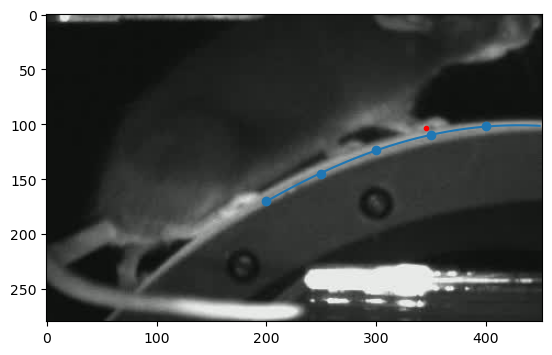

In [18]:
plt.imshow(im)

x = np.arange(200,450)
#plt.plot(x,250*-np.sin((1/290)*x)+330)
xs = [200,250,300,350,400]
ys = [170,145,123,110,102]

plt.scatter(xs,ys)


def func(x, a, b, c):
    return -a*np.sin((1/b)*x)+c
import scipy.optimize as optimization

fit_results = optimization.curve_fit(func, xs, ys, [150,300,275])
plt.plot(x,-fit_results[0][0]*np.sin((1/fit_results[0][1])*x)+fit_results[0][2])
plt.plot(RFPposition_side[0][0],RFPposition_side[0][1],'.',color='r')

import shapely.geometry as geom
dists = []
for pos in RFPposition_side:
    line = geom.LineString(np.array([x,func(x,fit_results[0][0],fit_results[0][1],fit_results[0][2])]).T)
    point = geom.Point(pos)
    dists.append(point.distance(line))

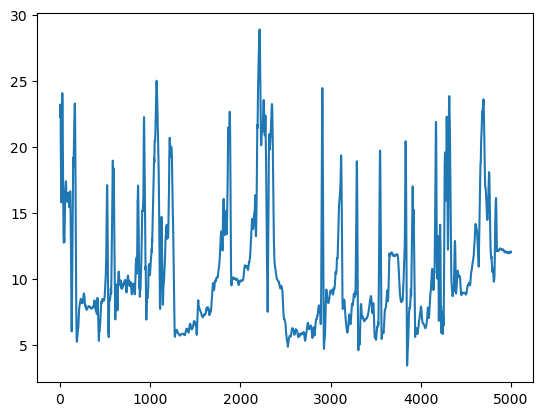

In [19]:
from scipy.signal import savgol_filter
#plt.plot(dists[0:1500])
dists_smoothed = savgol_filter(dists, 25, 3) ## consider making these parameters accessible as inputs
plt.plot(dists_smoothed[-203000:-198000])#55*200])

In [20]:
dists_thresh = np.array(dists_smoothed) > 18
footfalls_side = np.where(dists_thresh[1:] < dists_thresh[:-1])[0]
footrises_side = np.where(dists_thresh[1:] > dists_thresh[:-1])[0]

In [21]:
footrises_side[0], footfalls_side[0]

(14, 25)

In [22]:
durations_side = footrises_side[1:] - footfalls_side[:-1]
durations_side = np.insert(durations_side, len(durations_side), np.array(np.nan))

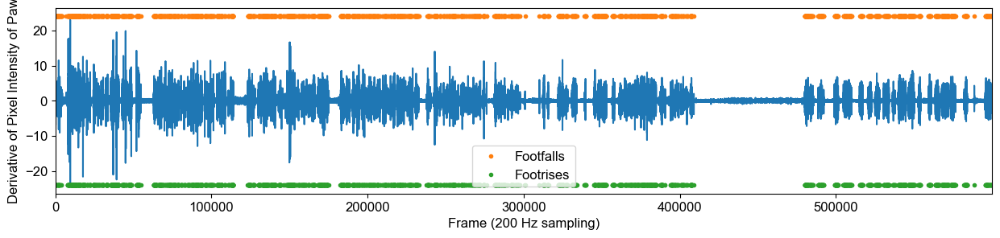

In [19]:
footfalls,footrises = analyzeMEA.wheel.find_footfalls(RFPintensity,plot=True)

In [20]:
# importing labeling of side video using deepethogram

In [21]:
deg_files = glob.glob('*labels.csv')
deg_files.sort(key=lambda x: x[-30:])
deg_files_predict = glob.glob('*predictions.csv')
deg_files_predict.sort(key=lambda x: x[-35:])

In [22]:
deg_files

['s1-12162022115204-0000_labels.csv',
 's2-12162022115854-0000_labels.csv',
 's3-12162022120441-0000_labels.csv',
 's4-12162022120956-0000_labels.csv',
 's5-12162022121715-0000_labels.csv',
 's6-12162022122324-0000_labels.csv',
 's7-12162022122839-0000_labels.csv',
 's8-12162022123449-0000_labels.csv',
 's9-12162022125049-0000_labels.csv',
 's10-12162022125643-0000_labels.csv']

In [23]:
labels = []
for file in deg_files:
    labels.append(pd.read_csv(file))
labels = pd.concat(labels,ignore_index=True)
labelsP = []

for file in deg_files_predict:
    labelsP.append(pd.read_csv(file))
labelsP = pd.concat(labelsP,ignore_index=True)


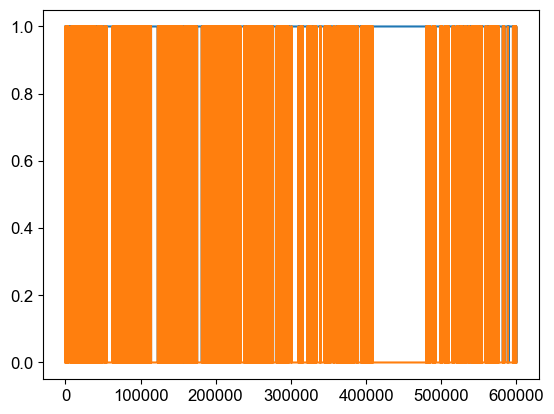

In [24]:
plt.plot(labels['contact'])
plt.plot(labels['partialContact'])
#plt.xlim([-1000,-1])

In [25]:
contact = np.bool8(labels['contact']+labels['partialContact'] > 0)
contactP = np.bool8(labelsP['contact']+labelsP['partialContact'] > 0)

In [26]:
footfalls_DE = np.where(contact[1:] > contact[:-1])[0]
footrises_DE = np.where(contact[1:] < contact[:-1])[0]

footfalls_DE_P = np.where(contactP[1:] > contactP[:-1])[0]
footrises_DE_P = np.where(contactP[1:] < contactP[:-1])[0]

In [27]:
footfalls_DE[-1], footrises_DE[-1]

(599858, 599957)

In [28]:
try:
    stepLength_DE = footfalls_DE - footrises_DE
except ValueError:
    stepLength_DE = footfalls_DE - footrises_DE[:-1]
try:
    stepLength_DE_P = footfalls_DE_P - footrises_DE_P
except ValueError: ## length of arrays is not the same
    stepLength_DE_P = footfalls_DE_P - footrises_DE_P[:-1]

stepLengthInd = np.argsort(stepLength_DE)
stepLengthInd_P = np.argsort(stepLength_DE_P)


durations_DE = footrises_DE[1:-1] - footfalls_DE[:-1]
durations_DE_P = footrises_DE_P[1:-1] - footfalls_DE_P[:-1]
durations_DE_P = np.append(durations_DE_P,-1)
durInd = np.argsort(durations_DE)
durInd_P = np.argsort(durations_DE_P)

In [29]:
footfallMatrix = np.zeros([len(footfalls_DE),300])
for i, plant in enumerate(footfalls_DE):
    if (plant > 100) and (plant < labels.shape[0]-200):
        
        footfallMatrix[i,:] += 1* np.array(labels['partialContact'])[plant-100:plant+200]
        footfallMatrix[i,:] += 2* np.array(labels['contact'])[plant-100:plant+200]
        footfallMatrix[i, footfallMatrix[i,:] == 3] = 2
        
        
        
footfallMatrix_P = np.zeros([len(footfalls_DE_P),300])
for i, plant in enumerate(footfalls_DE_P):
    if (plant > 100) and (plant < labels.shape[0]-200):
        
        footfallMatrix_P[i,:] += 1* np.array(labelsP['partialContact'])[plant-100:plant+200]
        footfallMatrix_P[i,:] += 2* np.array(labelsP['contact'])[plant-100:plant+200]
        footfallMatrix_P[i, footfallMatrix_P[i,:] == 3] = 2
        
footfallMatrix_P2 = np.zeros([len(footfalls_DE),300])
for i, plant in enumerate(footfalls_DE):
    if (plant > 100) and (plant < labels.shape[0]-200):
        
        footfallMatrix_P2[i,:] += 1* np.array(labelsP['partialContact'])[plant-100:plant+200]
        footfallMatrix_P2[i,:] += 2* np.array(labelsP['contact'])[plant-100:plant+200]
        footfallMatrix_P2[i, footfallMatrix_P2[i,:] == 3] = 2
        
footfallMatrix_M2 = np.zeros([len(footfalls_DE_P),300])
for i, plant in enumerate(footfalls_DE_P):
    if (plant > 100) and (plant < labels.shape[0]-200):
        
        footfallMatrix_M2[i,:] += 1* np.array(labels['partialContact'])[plant-100:plant+200]
        footfallMatrix_M2[i,:] += 2* np.array(labels['contact'])[plant-100:plant+200]
        footfallMatrix_M2[i, footfallMatrix_M2[i,:] == 3] = 2

In [30]:
np.array(labels['contact'])[plant-100:plant+200] + 2* np.array(labels['partialContact'])[plant-100:plant+200]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0], dtype=int64)

In [31]:
footfallMatrix.shape

(2852, 300)

Text(0.5, 1.0, 'Manual Annotation')

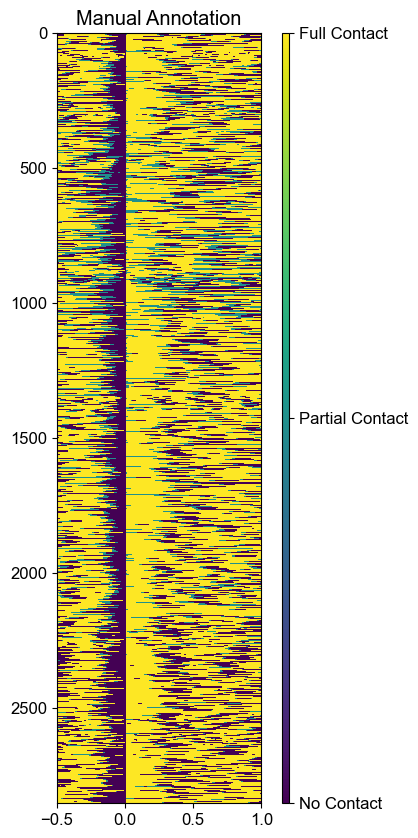

In [32]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix[:,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Manual Annotation')

Text(0.5, 1.0, 'Prediction')

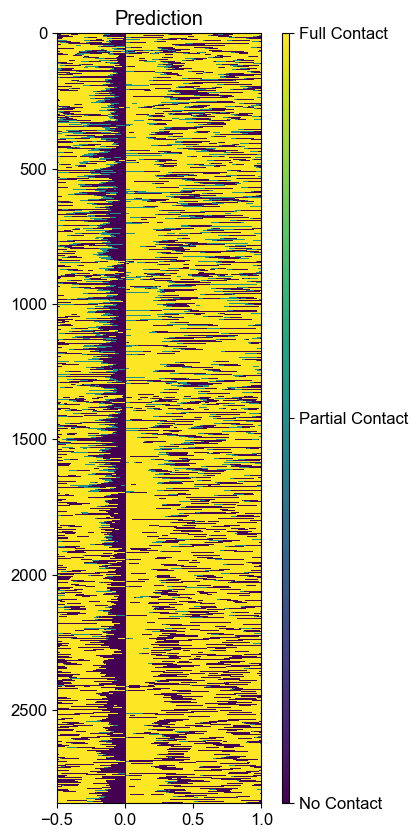

In [33]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix_P[:,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix_P),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Prediction')

Text(0.5, 1.0, 'Prediction, aligned to manual')

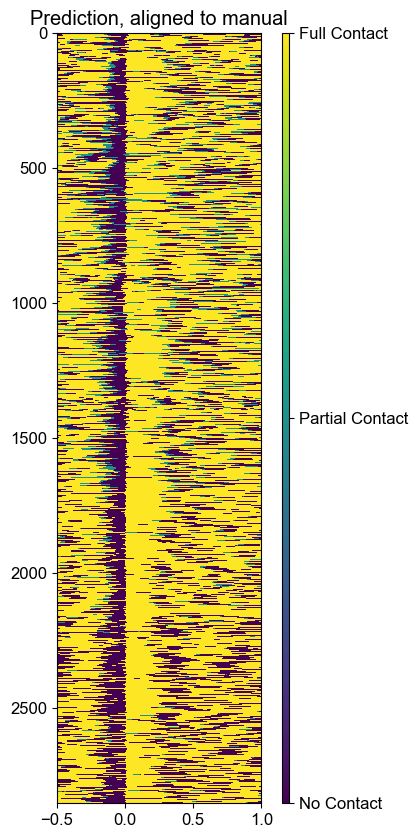

In [34]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix_P2[:,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix_P2),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Prediction, aligned to manual')

#ax[0].set_xlim([-0.25,0.25])
#ax[0].set_yticks(np.arange(0,3000,100))

meta NOT subset; don't know how to subset; dropped


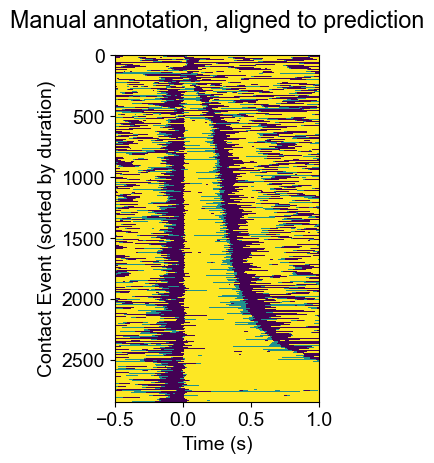

In [35]:
import matplotlib
oldSize = matplotlib.rcParams['font.size']
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['font.sans-serif'] = 'Arial'


f, ax = plt.subplots(1,2,figsize=[3,4.5],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix_M2[durInd_P,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix_M2),0])
ax[1].set_visible(False)
# cb = plt.colorbar(im, ax[1])
# cb.set_ticks([0,1,2])
# cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Manual annotation, aligned to prediction',pad=20)

ax[0].set_xlabel('Time (s)')
ax[0].set_ylabel('Contact Event (sorted by duration)')
#ax[0].set_xlim([-0.25,0.25])
#ax[0].set_yticks(np.arange(0,3000,100))

plt.savefig(r'C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Conferences\2023 SFN\Gait\Contact_Manual_v_Prediction.pdf',
           bbox_inches='tight',dpi=600,transparent=True)

Text(0, 0.5, 'Duration (frames)')

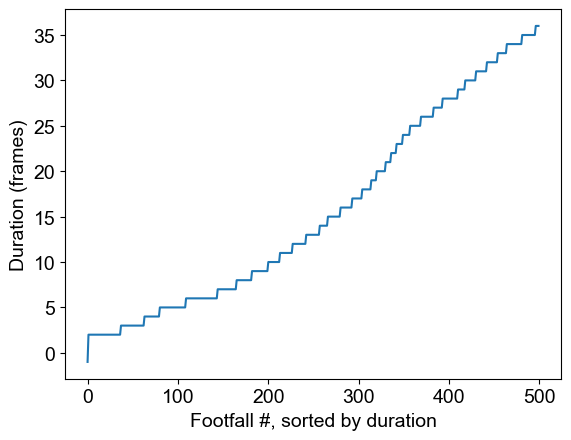

In [36]:
plt.plot(np.sort(durations_DE_P)[:500])
plt.xlabel('Footfall #, sorted by duration')
plt.ylabel('Duration (frames)')

Text(0, 0.5, 'Duration (frames)')

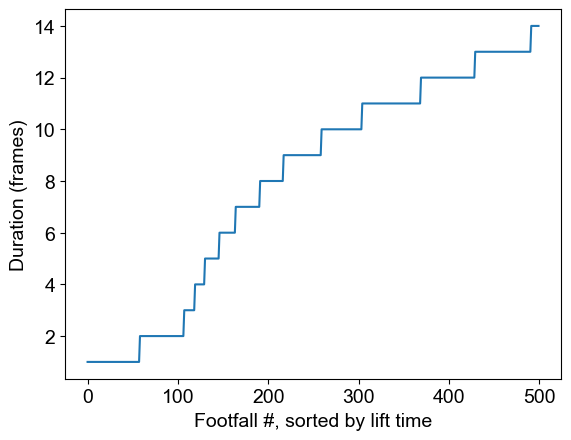

In [37]:
plt.plot(np.sort(stepLength_DE_P)[:500])
plt.xlabel('Footfall #, sorted by lift time')
plt.ylabel('Duration (frames)')

(-0.25, 0.25)

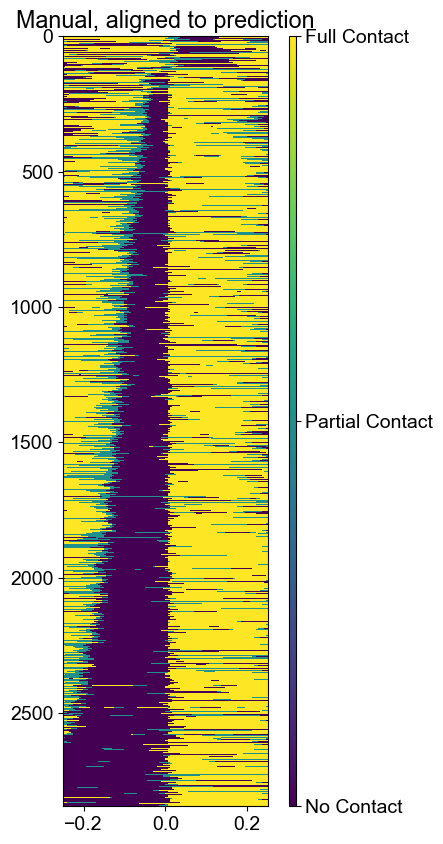

In [38]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix_M2[stepLengthInd_P,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix_M2),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Manual, aligned to prediction')

ax[0].set_xlim([-0.25,0.25])
#ax[0].set_yticks(np.arange(0,3000,100))

Text(0.5, 1.0, 'Prediction, aligned to manual')

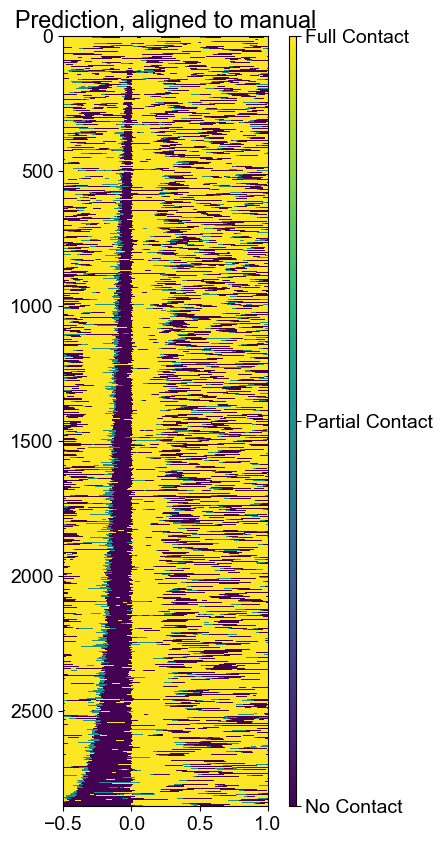

In [39]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix_P2[stepLengthInd,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix_P2),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Prediction, aligned to manual')

#ax[0].set_xlim([-0.25,0.25])
#ax[0].set_yticks(np.arange(0,3000,100))

In [40]:
stepLength_DE_P.shape
#durations_DE_P.shape
#footfalls_DE_P.shape
footrises_DE_P.shape

(2845,)

In [41]:
ind = (durations_DE_P > 15) & (stepLength_DE_P > 8)
footfalls_DE_P = footfalls_DE_P[ind]
footrises_DE_P = footrises_DE_P[:-1][ind]
durations_DE_P = durations_DE_P[ind]
stepLength_DE_P = stepLength_DE_P[ind]

In [42]:
np.median(stepLength_DE_P/200)

0.13

In [43]:
len(footfalls_DE_P), len(footrises_DE_P), len(durations_DE_P)

(2449, 2449, 2449)

Text(0.5, 1.0, 'Sorted by Duration of Lift')

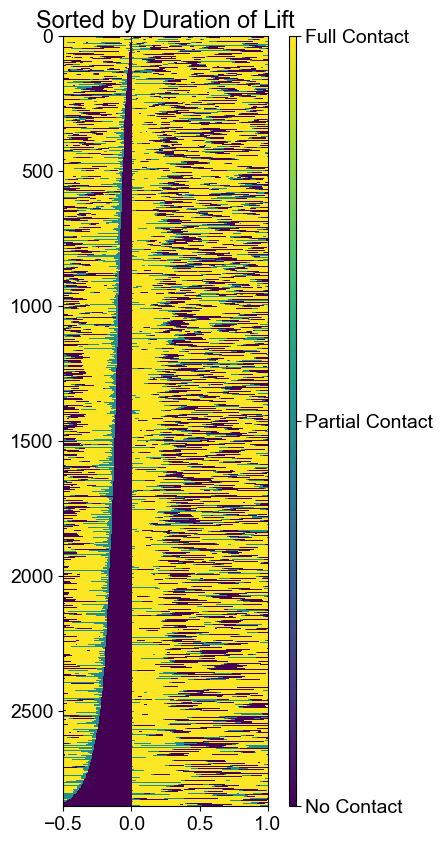

In [44]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix[stepLengthInd,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Sorted by Duration of Lift')

Text(0.5, 1.0, 'Sorted by Duration of Contact')

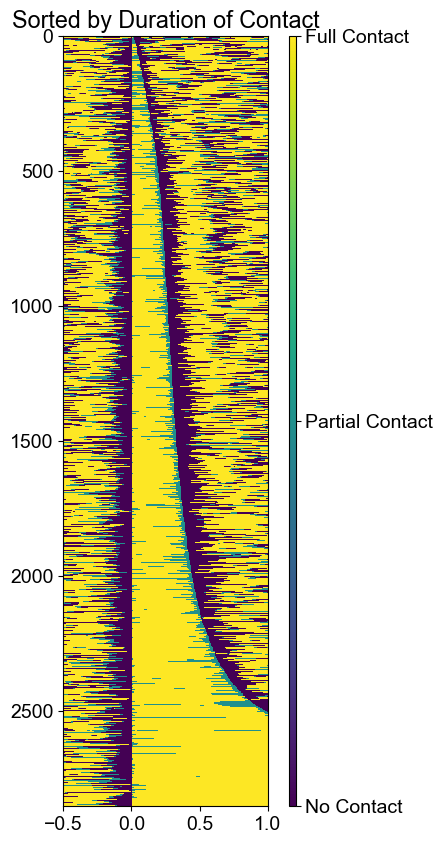

In [45]:
f, ax = plt.subplots(1,2,figsize=[3,10],gridspec_kw={'width_ratios':[30,1]})
im = ax[0].imshow(footfallMatrix[durInd,:],interpolation='none',aspect='auto',extent=[-0.5,1,len(footfallMatrix),0])
cb = plt.colorbar(im, ax[1])
cb.set_ticks([0,1,2])
cb.set_ticklabels(['No Contact','Partial Contact','Full Contact'])
ax[0].set_title('Sorted by Duration of Contact')

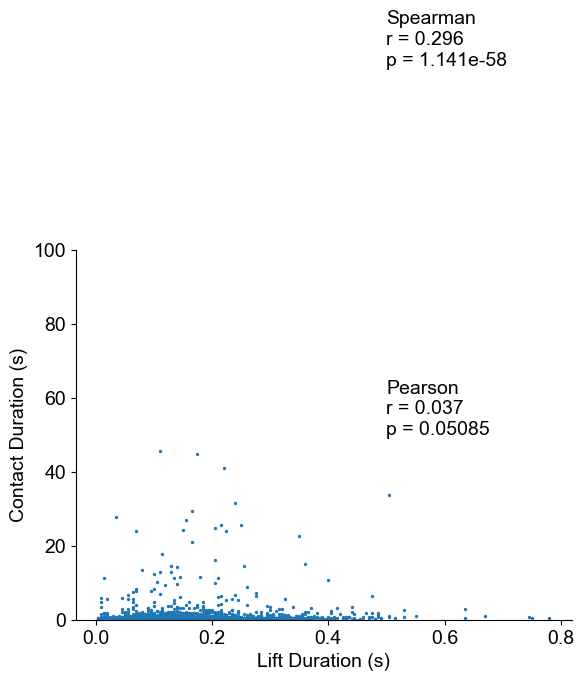

In [94]:
plt.scatter(stepLength_DE[:-1]/200,durations_DE/200,2)
plt.xlabel('Lift Duration (s)')
plt.ylabel('Contact Duration (s)')
r, p = scipy.stats.spearmanr(stepLength_DE[:-1]/200,durations_DE/200)
plt.text(0.5,150,'Spearman\nr = {0:0.3f}\np = {1:0.4}'.format(r,p))

r, p = scipy.stats.pearsonr(stepLength_DE[:-1]/200,durations_DE/200)
plt.text(0.5,50,'Pearson\nr = {0:0.3f}\np = {1:0.4}'.format(r,p))
plt.ylim([0,100])

import seaborn as sns
sns.despine()


In [46]:
from scipy.signal import savgol_filter, find_peaks
diff = np .diff(RFPintensity)
diff_smoothed = savgol_filter(diff, 17, 3) ## consider making these parameters accessible as inputs
diff_smoothed = np.insert(diff_smoothed,0,0)
peak_height = [2*np.std(diff_smoothed),np.max(diff_smoothed)+1]
frame_rate = 200

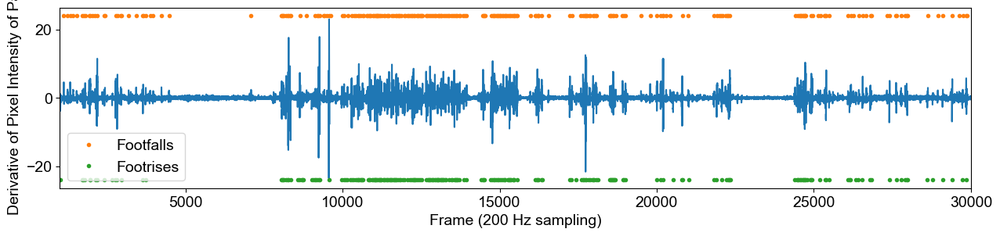

In [47]:
plt.figure(figsize=[15,3])
plt.plot(diff_smoothed)
#plt.plot(LFPintensity)
plt.plot(footfalls,np.ones(len(footfalls))*peak_height[1],'.',label='Footfalls')
plt.plot(footrises,-np.ones(len(footrises))*peak_height[1],'.',label='Footrises')
#plt.xlim([150000,153000])
plt.ylabel('Derivative of Pixel Intensity of Paw')
plt.xlabel('Frame ({} Hz sampling)'.format(frame_rate))
plt.xlim([1000,30000])
plt.legend()
plt.show()
plt.close()

In [48]:
durations = []
for ff in footfalls:
    try:
        fr = footrises[footrises > ff][0] # first rise after ff
        durations.append(fr-ff)
    except:
        durations.append(np.nan)
durations = np.array(durations)

In [49]:
footfallPositions = RFPposition[footfalls,:2] ## using ventrally defined footfalls for this recording -- need to troubleshoot side view
footfallPositions_P = RFPposition[footfalls_DE_P+8,:2] ## using ventrally defined footfalls for this recording -- need to troubleshoot side view

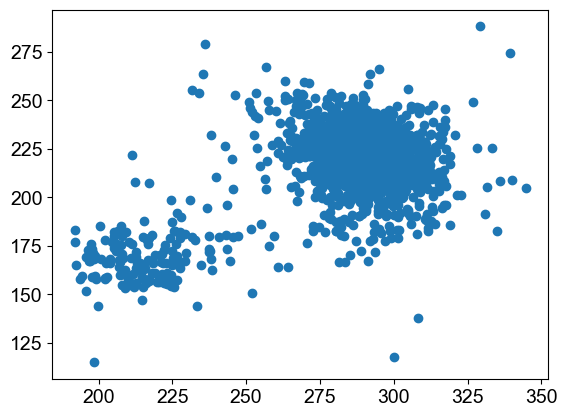

In [50]:
plt.scatter(footfallPositions_P[:,0],footfallPositions_P[:,1])

In [51]:
footfallImages_P = []
for i, video in enumerate(videos_ventral):
    print("on video {} of {}".format(i+1,len(videos_ventral)))
    ffs = footfalls_DE_P[videoIndex[footfalls_DE_P] == i]
    print('first footfall is {}'.format(len(footfallImages_P)))
    firstFrame = np.where(videoIndex == i)[0][0] ## find first frame of video
    ffs = ffs-firstFrame
    cap = cv2.VideoCapture(video)
    
    for ff in ffs:
        cap.set(cv2.CAP_PROP_POS_FRAMES,ff+8)### addding 8 frames here to ensure capture paw in contact
        f, im = cap.read()
        footfallImages_P.append(im)

on video 1 of 10
first footfall is 0
on video 2 of 10
first footfall is 335
on video 3 of 10
first footfall is 626
on video 4 of 10
first footfall is 874
on video 5 of 10
first footfall is 1135
on video 6 of 10
first footfall is 1433
on video 7 of 10
first footfall is 1606
on video 8 of 10
first footfall is 1890
on video 9 of 10
first footfall is 1890
on video 10 of 10
first footfall is 2176


In [52]:
#plt.imshow(footfallImages_P[1])

In [53]:
footfallImages_narrowGratings = footfallImages[:1780]

NameError: name 'footfallImages' is not defined

In [54]:
# basePathEmoryOneDrive = r'C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\GratingClassification\\'
# folderName = os.path.split(os.path.split(os.path.split(os.getcwd())[0])[0])[1] + '_' + os.path.split(os.path.split(os.getcwd())[0])[1]
# os.mkdir(basePathEmoryOneDrive + folderName)
# np.save(basePathEmoryOneDrive + folderName + '\\images_P.npy',np.array(footfallImages_P))
# np.save(basePathEmoryOneDrive + folderName + '\\positions_P.npy',footfallPositions_P)

In [55]:
## delte grating_classification.npy
# os.remove('grating_classification.npy')

In [56]:
# firstImages = []
# for video in videos_ventral:
#     cap = cv2.VideoCapture(video)
#     f, im = cap.read()
#     firstImages.append(im)
#     cap.release()

In [57]:
# ## estimating rotation and scale factors for first images in each video -- bumps

# rotFactor_estimate = 0
# scaleFactor_estimate = 0.210
# sfs = np.arange(0.2,0.25,0.001)
# rots = np.arange(rotFactor_estimate-5,rotFactor_estimate+5,0.2)

# coeffs = np.zeros([len(firstImages),len(rots)])

# scaleFactor = 0.210
# for j, image in enumerate(firstImages):
# #     plt.figure()
# #     plt.imshow(image)
# #     plt.show()
# #     plt.close()
#     if j % 10 == 0:
#         print(j)
#     corrCoefs = []


    
#     for rotFactor in rots:
        
        
#         cropped_im = rotate_image(image,rotFactor)[80:250,10:325]
#         croppedFrame = cv2.cvtColor(cropped_im, cv2.COLOR_BGR2GRAY)
#         croppedFrame_thresh = cv2.adaptiveThreshold(croppedFrame,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
#                                                     cv2.THRESH_BINARY,35,-25)


#         D_shrunk = cv2.flip(cv2.resize(np.uint8(depthMap),(0,0),fx=scaleFactor,fy=scaleFactor),1)
#         D_shrunk_cat = np.concatenate([D_shrunk,D_shrunk[:,:croppedFrame.shape[1]]],axis=1)
#         result = cv2.matchTemplate(D_shrunk_cat,croppedFrame_thresh,cv2.TM_CCORR_NORMED)
        
#         corrCoefs.append(np.max(result))
#     coeffs[j,:] = corrCoefs
# plt.figure()
# plt.plot(rots,coeffs.T)
# plt.show()
# plt.close()

In [58]:
# plt.figure(figsize=[2,2])
# ax = plt.axes()
# ax.plot(rots,coeffs.T)
# ax.set_xlabel('Rotation (deg)')
# ax.set_ylabel('Max. Corr. Coefficient')
# ax.spines['top'].set_visible(False)
# ax.spines['right'].set_visible(False)
# plt.show()
# plt.close()

In [59]:
# rotFactors = []
# for coeff in coeffs:
#     rotFactors.append(rots[np.argmax(coeff)])

In [60]:
# center = np.array(image.shape[:2])/2
# footfallPositions = RFPposition[footfalls_side,:-1]
# plt.plot(footfallPositions[:,0],footfallPositions[:,1],'.')
# points_rot = rotate_points(center,-1,footfallPositions)
# plt.plot(points_rot[:,0],points_rot[:,1],'.')

In [61]:
# scaleFactor = 0.210 ##

# maxLoc = []

# bumps = np.bool8([1,1,0,0])#[True, True, False, False, True, False]


# for j, image in enumerate(footfallImages):
# #     plt.figure()
# #     plt.imshow(image)
# #     plt.show()
# #     plt.close()
#     if j % 50 == 0:
#         print(j)
    
#     videoInd = int(videoIndex[footfalls_side[j]])
    
#     if bumps[videoInd]: ## adjust rotFactor depending on video of origin
#         rotFactor = rotFactors[videoInd] 
#         rotated_im = cv2.cvtColor(rotate_image(image,rotFactor),cv2.COLOR_BGR2GRAY)
#         croppedFrame = rotated_im[80:250,10:326]
#         croppedFrame_thresh = cv2.adaptiveThreshold(croppedFrame,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
#                                                         cv2.THRESH_BINARY,35,-25)


#         D_shrunk = cv2.flip(cv2.resize(np.uint8(depthMap),(0,0),fx=scaleFactor,fy=scaleFactor),1)
#         D_shrunk_cat = np.concatenate([D_shrunk,D_shrunk[:,:croppedFrame.shape[1]]],axis=1)
#         result = cv2.matchTemplate(D_shrunk_cat,croppedFrame_thresh,cv2.TM_CCORR_NORMED)

#         resultMax = np.where(result == np.max(result))
#         #print(np.max(result))
#         maxLoc.append([resultMax[0][0],resultMax[1][0]])
#     else:
#         maxLoc.append([np.nan,np.nan])
    
    
    
# maxLoc = np.array(maxLoc)

In [62]:
# maxLoc[:50]

In [63]:
import analyzeMEA
spikeDict = analyzeMEA.importdata.importKS(currPath+'\\alldata\\')#,depth=1050)

goodSamples = spikeDict['goodSamples']
goodSpikes = spikeDict['goodSpikes']
goodTimes = spikeDict['goodTimes']
sampleRate = spikeDict['sampleRate']

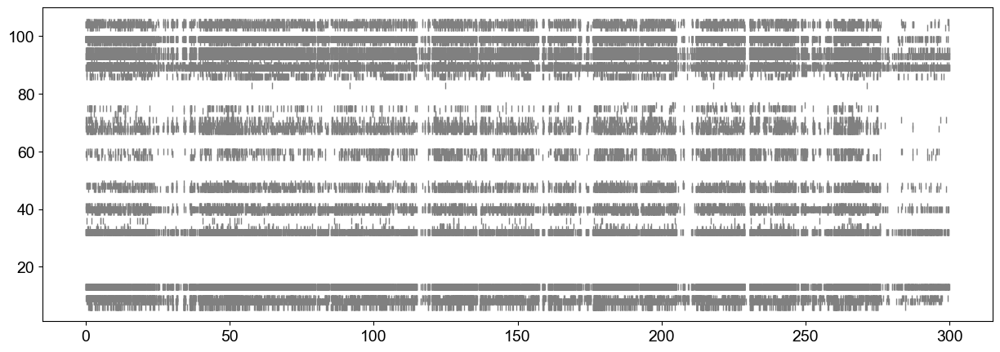

In [64]:
ltime = 0 # in seconds
rtime = 300 # in seconds

#plt.plot(goodtimes,goodspikes,'|')
plt.figure(figsize=(15,5))
plt.plot(goodTimes[(goodTimes > ltime) & (goodTimes < rtime)],goodSpikes[(goodTimes > ltime) & (goodTimes < rtime)],'|',color='gray')

In [65]:
## Sorting DigitalInput.mat files by time in filename

digInputs = analyzeMEA.importdata.importDImat(currPath+'\\')

C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115347DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115447DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115547DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115647DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115747DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115847DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_115934DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\gratings_221216_120034DigitalInputs.mat
C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Data\20221216\ALT1\p1\grati

meta NOT subset; don't know how to subset; dropped


0.6984717059066501

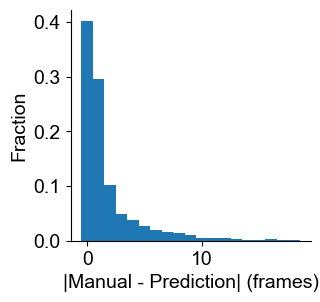

In [66]:
#plt.scatter(footfalls[:400],footfalls_DE[:400])

ffdiff = []

for footfall in footfalls_DE_P:
    ffdiff.append(np.min(np.abs(footfalls_DE - footfall)))
    
f = plt.figure(figsize=[3.1,3])
ax = plt.axes()
h = ax.hist(ffdiff,np.arange(20),align='left',density=True)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
f.set_clip_on(False)
ax.set_xlabel('|Manual - Prediction| (frames)')
ax.set_ylabel('Fraction')
plt.savefig(r'C:\Users\ajemanu\OneDrive - Emory University\1 - Lab\Conferences\2023 SFN\Gait\hist_ffdiff_ALT1.pdf',dpi=600,
           bbox_inches='tight',transparent=True)
h[0][0]+h[0][1]#/len(footfalls_DE_P)

In [67]:
intan_trigger = digInputs[0,:]
#intan_camera = digInputs[1,:]
#frameTimes = np.where(intan_camera[1:] > intan_camera[:-1])[0]

In [68]:
matFiles = glob.glob('*[0-9].mat')
matFiles.sort(key=lambda x: x[-18:])

In [69]:
matFiles

['acquireIntanDualCamera_221216 1204 31.mat',
 'acquireIntanDualCamera_221216 1204 34.mat',
 'acquireIntanDualCamera_221216 1209 52.mat',
 'acquireIntanDualCamera_221216 1215 08.mat',
 'acquireIntanDualCamera_221216 1223 16.mat',
 'acquireIntanDualCamera_221216 1228 32.mat',
 'acquireIntanDualCamera_221216 1233 52.mat',
 'acquireIntanDualCamera_221216 1240 00.mat',
 'acquireIntanDualCamera_221216 1256 02.mat',
 'acquireIntanDualCamera_221216 1301 54.mat']

In [70]:
matTrigger = []
matVentralTrigger = []
matSideTrigger = []

for file in matFiles:
    temp = scipy.io.loadmat(file)
    matTrigger.append(temp['trigger'].reshape(-1))
    matVentralTrigger.append(temp['ventralcameratrigger'].reshape(-1))
    matSideTrigger.append(temp['sidecameratrigger'].reshape(-1))
matTrigger = np.concatenate(matTrigger)
matVentralTrigger = np.concatenate(matVentralTrigger)
matSideTrigger = np.concatenate(matSideTrigger)

In [71]:
matlab_starts = np.where(matTrigger[1:] > matTrigger[:-1])[0]
matlab_ends = np.where(matTrigger[1:] < matTrigger[:-1])[0]
intan_starts = np.where(intan_trigger[1:] > intan_trigger[:-1])[0]
intan_ends = np.where(intan_trigger[1:] < intan_trigger[:-1])[0]

In [72]:
len(intan_starts), len(matlab_starts)

(10, 10)

In [73]:
print(matlab_ends - matlab_starts)
print(intan_ends - intan_starts)

[5999998 5999998 5999998 5999998 5999998 5999998 5999998 5999998 5999998
 5999998]
[5999998 5999998 5999998 5999998 5999998 5999998 5999998 5999998 5999998
 5999998]


In [74]:
goodsamples_sweeps = []
goodspikes_sweeps = []
ventralTrigger_sweeps = []
frameSamples_sweeps = []
for i in range(len(matlab_starts)):
    print(intan_starts[i],matlab_starts[i])
    spikeIndex = (goodSamples > intan_starts[i]) & (goodSamples < intan_ends[i])
    goodsamples_sweeps.append(goodSamples[spikeIndex] - intan_starts[i])
    goodspikes_sweeps.append(goodSpikes[spikeIndex])
    ventralTrigger_sweeps.append(matVentralTrigger[matlab_starts[i]:matlab_ends[i]])
    frameSamples_sweeps.append(np.where(ventralTrigger_sweeps[i][1:] > ventralTrigger_sweeps[i][:-1])[0])
    

20080 0
6060195 6000000
12100375 12000000
18140490 18000000
24180562 24000000
30220666 30000000
36260777 36000000
42300866 42000000
48340907 48000000
54381010 54000000


In [75]:
len(footfalls_DE_P),len(footrises_DE_P)

(2449, 2449)

C:\Users\ajemanu\Documents\GitHub\analyzeMEA\analyzeMEA\rastPSTH.py:131: RuntimeWarning: divide by zero encountered in divide
  psths_z[i] = psths_bs[i]/tempStDev
C:\Users\ajemanu\Documents\GitHub\analyzeMEA\analyzeMEA\rastPSTH.py:131: RuntimeWarning: invalid value encountered in divide
  psths_z[i] = psths_bs[i]/tempStDev


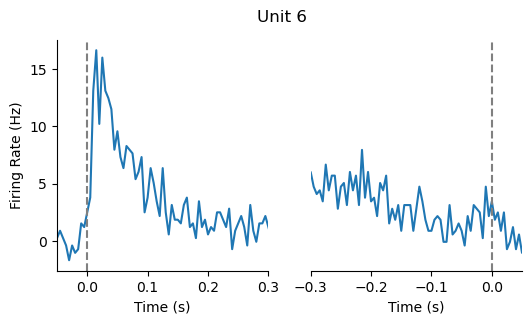

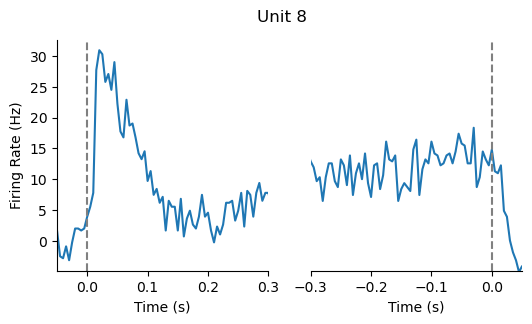

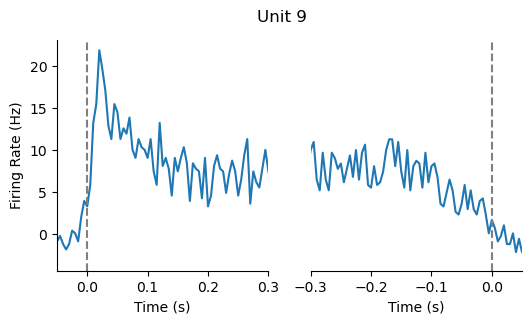

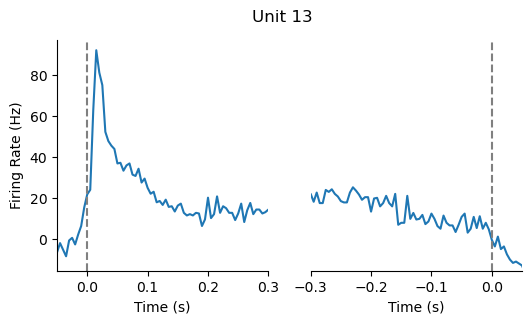

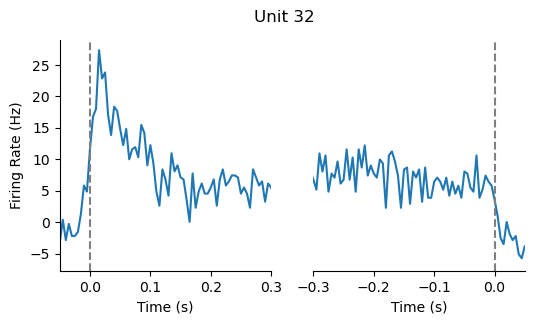

...

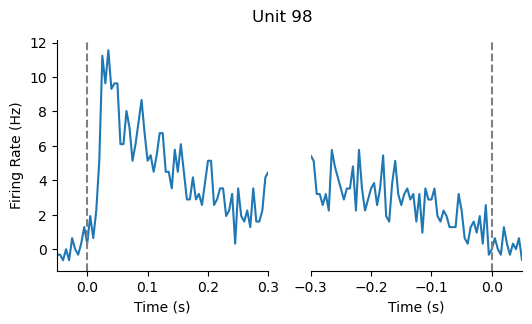

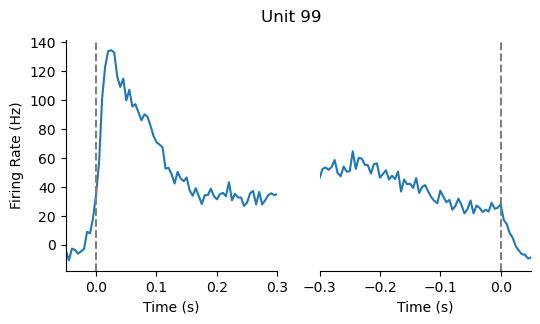

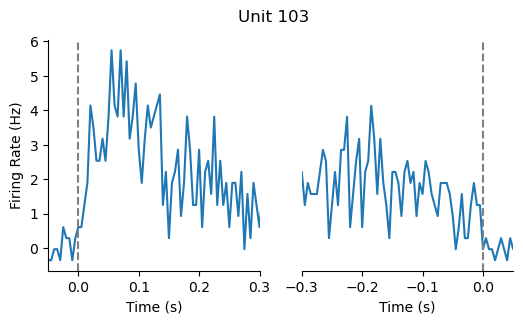

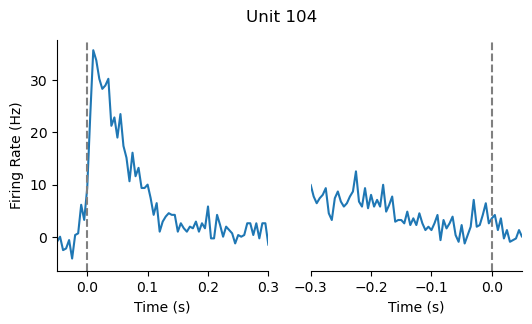

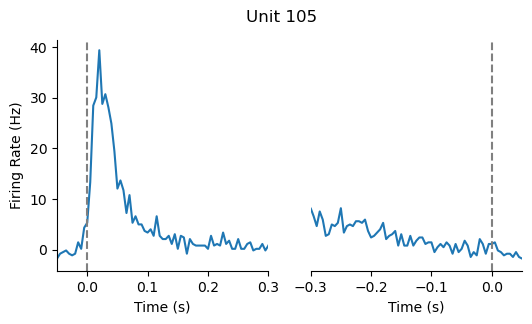

In [95]:
analyzeMEA.wheel.plot_onset_offset(footfalls_DE_P,footrises_DE_P,durations_DE_P,frameSamples_sweeps,
                                   goodsamples_sweeps,goodspikes_sweeps)


In [76]:
[len(n) for n in frameSamples_sweeps]

[59998, 59998, 59998, 59998, 59998, 59998, 59998, 59998, 59998, 59998]

In [77]:
footfalls_sweeps = []
footfalls_sweeps_DE = []
footfalls_sweeps_DE_P = []
footrises_sweeps = []
footrises_sweeps_DE = []
footrises_sweeps_DE_P = []

cumulative_frames = 0
for sweep in range(len(frameSamples_sweeps)):
    numFrames = len(frameSamples_sweeps[sweep])
    footfalls_sweeps_DE.append(footfalls_DE[footfalls_DE > cumulative_frames] - cumulative_frames)
    footfalls_sweeps_DE[-1] = footfalls_sweeps_DE[-1][footfalls_sweeps_DE[-1] < numFrames]
    footfalls_sweeps_DE_P.append(footfalls_DE_P[footfalls_DE_P > cumulative_frames] - cumulative_frames)
    footfalls_sweeps_DE_P[-1] = footfalls_sweeps_DE_P[-1][footfalls_sweeps_DE_P[-1] < numFrames]
    
    
    footrises_sweeps_DE.append(footrises_DE[footrises_DE > cumulative_frames] - cumulative_frames)
    footrises_sweeps_DE[-1] = footrises_sweeps_DE[-1][footrises_sweeps_DE[-1] < numFrames]
    footrises_sweeps_DE_P.append(footrises_DE_P[footrises_DE_P > cumulative_frames] - cumulative_frames)
    footrises_sweeps_DE_P[-1] = footrises_sweeps_DE_P[-1][footrises_sweeps_DE_P[-1] < numFrames]
    
    cumulative_frames += numFrames

In [78]:
footfalls_samples = []
footfalls_samples_DE = []
footfalls_samples_DE_P = []

footrises_samples = []
footrises_samples_DE = []
for sweep in range(len(frameSamples_sweeps)):
    footfalls_samples_DE.append(frameSamples_sweeps[sweep][footfalls_sweeps_DE[sweep]])
    footfalls_samples_DE_P.append(frameSamples_sweeps[sweep][footfalls_sweeps_DE_P[sweep]])
    footrises_samples_DE.append(frameSamples_sweeps[sweep][footrises_sweeps_DE[sweep]])

In [79]:
## for all sweeps
goodspikes_footfalls = []
goodsamples_footfalls = []

goodspikes_footfalls_DE = []
goodsamples_footfalls_DE = []

goodspikes_footfalls_DE_P = []
goodsamples_footfalls_DE_P = []

goodspikes_footrises = []
goodsamples_footrises = []

goodspikes_footrises_DE = []
goodsamples_footrises_DE = []

for sweep in range(len(footfalls_sweeps_DE)):
#     for footfall in footfalls_samples[sweep]:
#         gs = goodsamples_sweeps[sweep]
#         gsp = goodspikes_sweeps[sweep]
#         lastSample = frameSamples_sweeps[sweep][-1]
#         if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
#             goodsamples_footfalls.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
#             goodspikes_footfalls.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
    for footfall in footfalls_samples_DE[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
            goodsamples_footfalls_DE.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
            goodspikes_footfalls_DE.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
    for footfall in footfalls_samples_DE_P[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
            goodsamples_footfalls_DE_P.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
            goodspikes_footfalls_DE_P.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
#     for footrise in footrises_samples[sweep]:
#         gs = goodsamples_sweeps[sweep]
#         gsp = goodspikes_sweeps[sweep]
#         lastSample = frameSamples_sweeps[sweep][-1]
#         if ((footrise > 40000) & (footrise < lastSample-40000)): ## only consider those at least 2 s after start of recording and 2s before end
#             goodsamples_footrises.append(gs[(gs > footrise - 40000) & (gs < footrise +40000)] - footrise)
#             goodspikes_footrises.append(gsp[(gs > footrise - 40000) & (gs < footrise +40000)])
    for footrise in footrises_samples_DE[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footrise > 40000) & (footrise < lastSample-40000)): ## only consider those at least 2 s after start of recording and 2s before end
            goodsamples_footrises_DE.append(gs[(gs > footrise - 40000) & (gs < footrise +40000)] - footrise)
            goodspikes_footrises_DE.append(gsp[(gs > footrise - 40000) & (gs < footrise +40000)])

Text(0, 0.5, 'Firing Rate (Hz)')

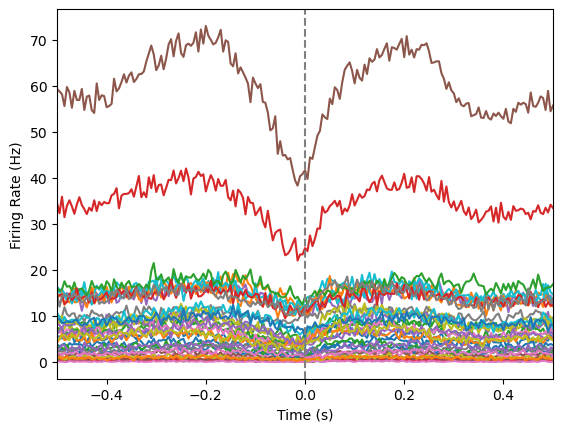

In [107]:
footfall_psth = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footfalls,goodspikes_footfalls,units=np.unique(goodSpikes),bs_window=[-1,-0.5])
plt.plot(footfall_psth['xaxis'],footfall_psth['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footfall_psth.png',dpi=600,bbox_inches='tight')

Text(0, 0.5, 'Firing Rate (Hz)')

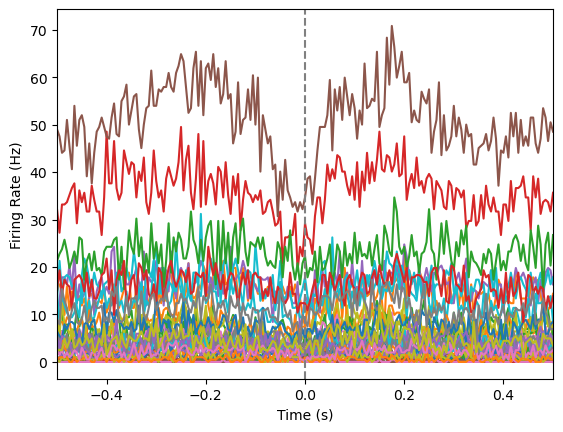

In [108]:
footfall_psth_ventral = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footfalls[:404],goodspikes_footfalls[:404],units=np.unique(goodSpikes),bs_window=[-1,-0.5])
plt.plot(footfall_psth_ventral['xaxis'],footfall_psth_ventral['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footfall_psth_ventral.png',dpi=600,bbox_inches='tight')

Text(0, 0.5, 'Firing Rate (Hz)')

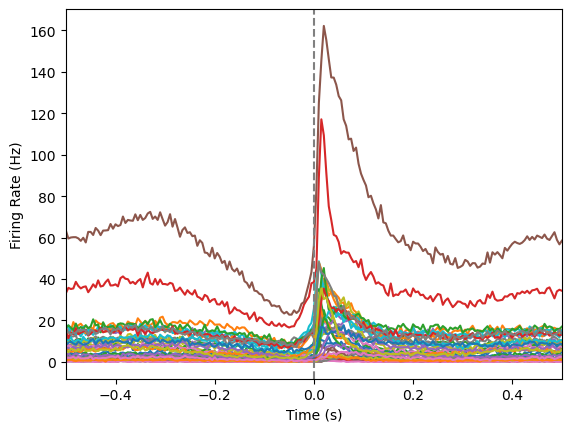

In [109]:
footfall_psth_DE = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footfalls_DE,goodspikes_footfalls_DE,units=np.unique(goodSpikes),bs_window=[-1,-0.5])
plt.plot(footfall_psth_DE['xaxis'],footfall_psth_DE['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footfall_psth_DE.png',dpi=600,bbox_inches='tight')

Text(0, 0.5, 'Firing Rate (Hz)')

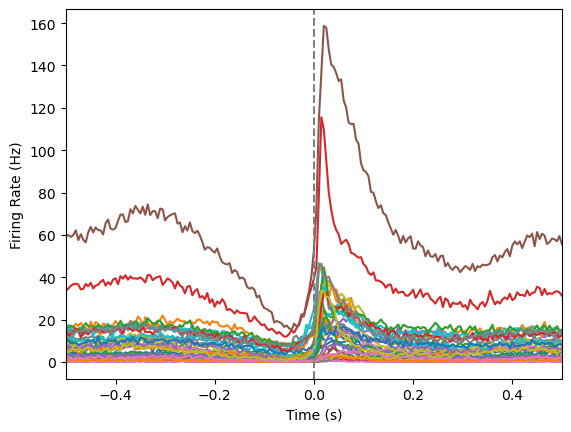

In [74]:
footfall_psth_DE_P = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footfalls_DE_P,goodspikes_footfalls_DE_P,units=np.unique(goodSpikes),bs_window=[-1,-0.5])
plt.plot(footfall_psth_DE_P['xaxis'],footfall_psth_DE_P['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footfall_psth_DE_P.png',dpi=600,bbox_inches='tight')

Text(0, 0.5, 'Firing Rate (Hz)')

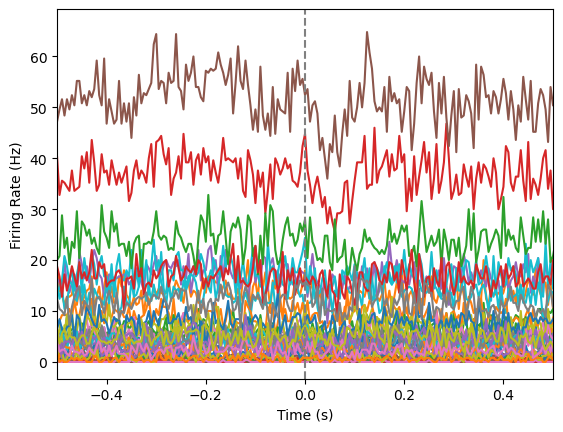

In [111]:
footrise_psth = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footrises[:500],goodspikes_footrises[:500],units=np.unique(goodSpikes),bs_window=[1,2])
plt.plot(footrise_psth['xaxis'],footrise_psth['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footrise_psth.png',dpi=600,bbox_inches='tight')

Text(0, 0.5, 'Firing Rate (Hz)')

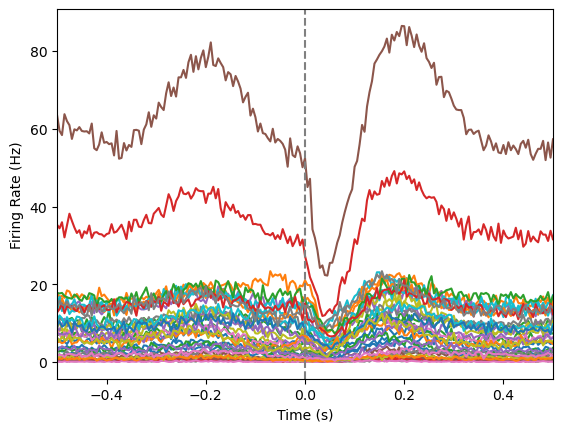

In [112]:
footrise_psth_DE = analyzeMEA.rastPSTH.makeSweepPSTH(0.005,goodsamples_footrises_DE,goodspikes_footrises_DE,units=np.unique(goodSpikes),bs_window=[-1,-0.5])
plt.plot(footrise_psth_DE['xaxis'],footrise_psth_DE['psths'])
plt.axvline(0,ls='--',color='gray')
plt.xlim([-0.5,0.5])
plt.xlabel('Time (s)')
plt.ylabel('Firing Rate (Hz)')
#plt.savefig('footrise_psth_DE.png',dpi=600,bbox_inches='tight')

In [113]:
footfall_psth['psths_z'].shape

(1200, 39)

Text(0.5, 0, 'Time (s; relative to footfall)')

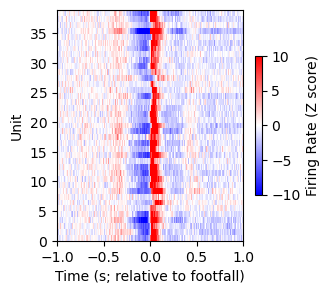

In [114]:
plt.figure(figsize=[3,3])
plt.imshow(footfall_psth_DE['psths_z'][:400,:].T,aspect='auto',cmap='bwr',clim=[-10,10],
           extent=[-1,1,0,len(np.unique(goodSpikes))],origin='lower',interpolation='none')
cb = plt.colorbar(shrink=0.6)
cb.set_label('Firing Rate (Z score)')
plt.ylabel('Unit')
plt.xlabel('Time (s; relative to footfall)')

In [115]:
## for all sweeps -- footfalls from ventral view; excluding borders
goodspikes_footfalls = []
goodsamples_footfalls = []

goodspikes_footrises = []
goodsamples_footrises = []
i = 0
durInd = []
sweepInd = []

for sweep in range(len(footfalls_sweeps)):
    for footfall in footfalls_samples[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
            goodsamples_footfalls.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
            goodspikes_footfalls.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
            durInd.append(i)
            sweepInd.append(sweep)
        else:
            print('excluded footfall {} from sweep {}'.format(i,sweep))
        i += 1

excluded footfall 0 from sweep 0
excluded footfall 1 from sweep 0
excluded footfall 2 from sweep 0
excluded footfall 3 from sweep 0
excluded footfall 1772 from sweep 3
excluded footfall 1773 from sweep 3
excluded footfall 1774 from sweep 3
excluded footfall 1775 from sweep 3
excluded footfall 1776 from sweep 3
excluded footfall 1777 from sweep 3
excluded footfall 1778 from sweep 3
excluded footfall 1779 from sweep 3
excluded footfall 1780 from sweep 4
excluded footfall 2652 from sweep 8
excluded footfall 2653 from sweep 8
excluded footfall 2654 from sweep 8
excluded footfall 2655 from sweep 8
excluded footfall 2971 from sweep 8
excluded footfall 2972 from sweep 8
excluded footfall 2973 from sweep 9
excluded footfall 2974 from sweep 9
excluded footfall 2975 from sweep 9
excluded footfall 2976 from sweep 9
excluded footfall 2977 from sweep 9
excluded footfall 3353 from sweep 9
excluded footfall 3354 from sweep 9
excluded footfall 3355 from sweep 9
excluded footfall 3356 from sweep 9
excl

In [116]:
## for all sweeps -- footfalls from DE; excluding borders
goodspikes_footfalls_DE = []
goodsamples_footfalls_DE = []

goodspikes_footrises_DE = []
goodsamples_footrises_DE = []
i = 0
durInd_DE = []
sweepInd_DE = []

for sweep in range(len(footfalls_sweeps_DE)):
    for footfall in footfalls_samples_DE[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
            goodsamples_footfalls_DE.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
            goodspikes_footfalls_DE.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
            durInd_DE.append(i)
            sweepInd_DE.append(sweep)
        else:
            print('excluded footfall {} from sweep {}'.format(i,sweep))
        i += 1
        
durations_includedInSweeps = durations_DE[durInd_DE]

excluded footfall 0 from sweep 0
excluded footfall 1 from sweep 0
excluded footfall 2 from sweep 0
excluded footfall 3 from sweep 0
excluded footfall 1339 from sweep 3
excluded footfall 1340 from sweep 3
excluded footfall 1341 from sweep 4
excluded footfall 1342 from sweep 4
excluded footfall 2175 from sweep 8
excluded footfall 2176 from sweep 8
excluded footfall 2518 from sweep 8
excluded footfall 2519 from sweep 8
excluded footfall 2520 from sweep 9
excluded footfall 2521 from sweep 9
excluded footfall 2844 from sweep 9
excluded footfall 2845 from sweep 9
excluded footfall 2846 from sweep 9
excluded footfall 2847 from sweep 9
excluded footfall 2848 from sweep 9
excluded footfall 2849 from sweep 9
excluded footfall 2850 from sweep 9
excluded footfall 2851 from sweep 9


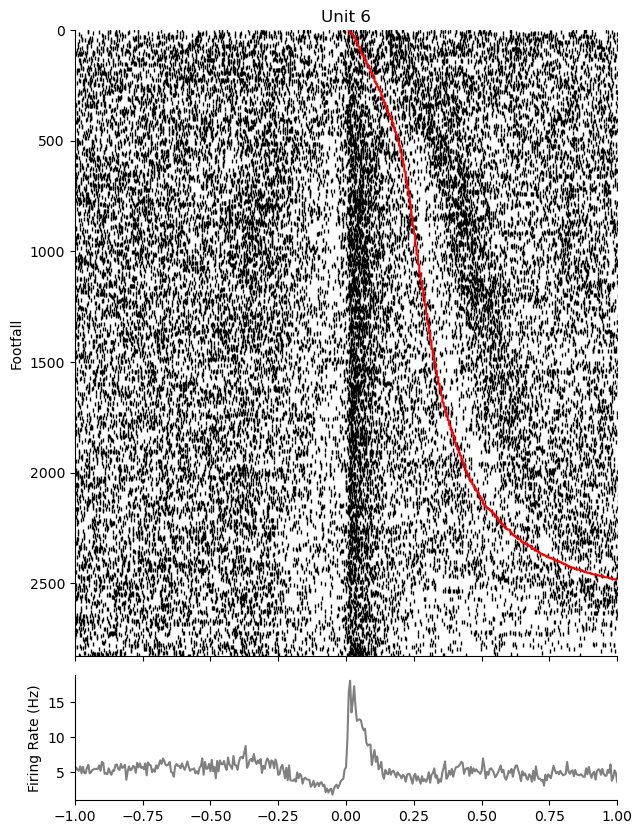

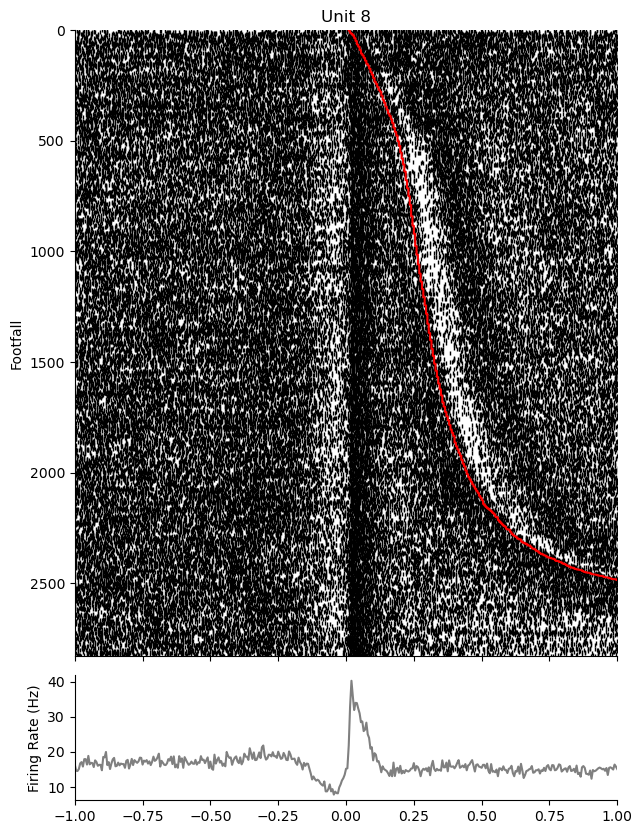

KeyboardInterrupt: 

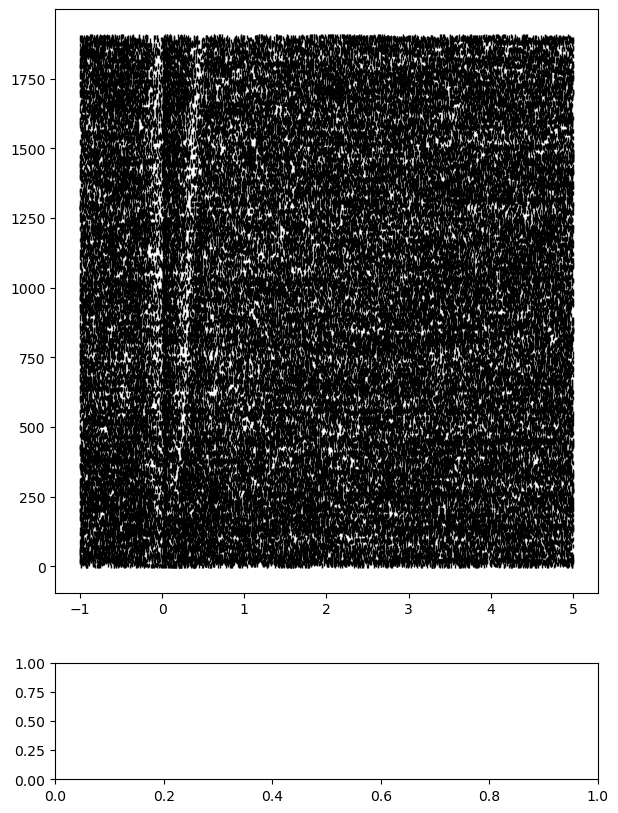

In [80]:
## sort by duration -- manual

for i, unit in enumerate(np.unique(goodSpikes)):
    f,ax = plt.subplots(2,1,gridspec_kw={'height_ratios':[5,1]},figsize=[7,10])
    for j, ind in enumerate(np.argsort(durations_includedInSweeps)):
        unitIndex = goodspikes_footfalls_DE[ind] == unit
        ax[0].plot(goodsamples_footfalls_DE[ind][unitIndex]/20000,np.ones(sum(unitIndex))+j,'|',lw=0.3,ms=3,color='k')
    ax[0].plot(np.sort(durations_includedInSweeps)/200,np.arange(len(durations_includedInSweeps)),color='r')
    ax[1].plot(footfall_psth_DE['xaxis'],footfall_psth_DE['psths'][:,i],color='gray')
    ax[0].set_title('Unit {}'.format(unit))
    
    ax[0].set_xlim([-1,1])
    ax[1].set_xlim([-1,1])
    ax[0].set_xticklabels([])
    
    ax[0].spines['right'].set_visible(False)
    ax[0].spines['top'].set_visible(False)
    ax[1].spines['right'].set_visible(False)
    ax[1].spines['top'].set_visible(False)
    
    ax[1].set_ylabel('Firing Rate (Hz)')
    ax[0].set_ylabel('Footfall')
    
    ax[0].set_ylim([0,len(goodsamples_footfalls_DE)])
    ax[0].invert_yaxis()
    plt.subplots_adjust(hspace=0.05)
    plt.show()
    plt.close()

In [82]:
## for all sweeps -- footfalls from DE prediction; excluding borders
goodspikes_footfalls_DE_P = []
goodsamples_footfalls_DE_P = []

goodspikes_footrises_DE_P = []
goodsamples_footrises_DE_P = []
i = 0
durInd_DE_P = []
sweepInd_DE_P = []

for sweep in range(len(footfalls_sweeps_DE_P)):
    for footfall in footfalls_samples_DE_P[sweep]:
        gs = goodsamples_sweeps[sweep]
        gsp = goodspikes_sweeps[sweep]
        lastSample = frameSamples_sweeps[sweep][-1]
        if ((footfall > 20000) & (footfall < lastSample-100000)): ## only consider those at least 1 s after start of recording and 5s before end
            goodsamples_footfalls_DE_P.append(gs[(gs > footfall - 20000) & (gs < footfall +100000)] - footfall)
            goodspikes_footfalls_DE_P.append(gsp[(gs > footfall - 20000) & (gs < footfall +100000)])
            durInd_DE_P.append(i)
            sweepInd_DE_P.append(sweep)
        else:
            print('excluded footfall {} from sweep {}'.format(i,sweep))
        i += 1
        
durations_includedInSweeps = durations_DE_P[durInd_DE_P]

excluded footfall 0 from sweep 0
excluded footfall 1 from sweep 0
excluded footfall 2 from sweep 0
excluded footfall 1133 from sweep 3
excluded footfall 1134 from sweep 3
excluded footfall 1135 from sweep 4
excluded footfall 1136 from sweep 4
excluded footfall 1890 from sweep 8
excluded footfall 1891 from sweep 8
excluded footfall 2175 from sweep 8
excluded footfall 2176 from sweep 9
excluded footfall 2177 from sweep 9
excluded footfall 2178 from sweep 9
excluded footfall 2443 from sweep 9
excluded footfall 2444 from sweep 9
excluded footfall 2445 from sweep 9
excluded footfall 2446 from sweep 9
excluded footfall 2447 from sweep 9
excluded footfall 2448 from sweep 9


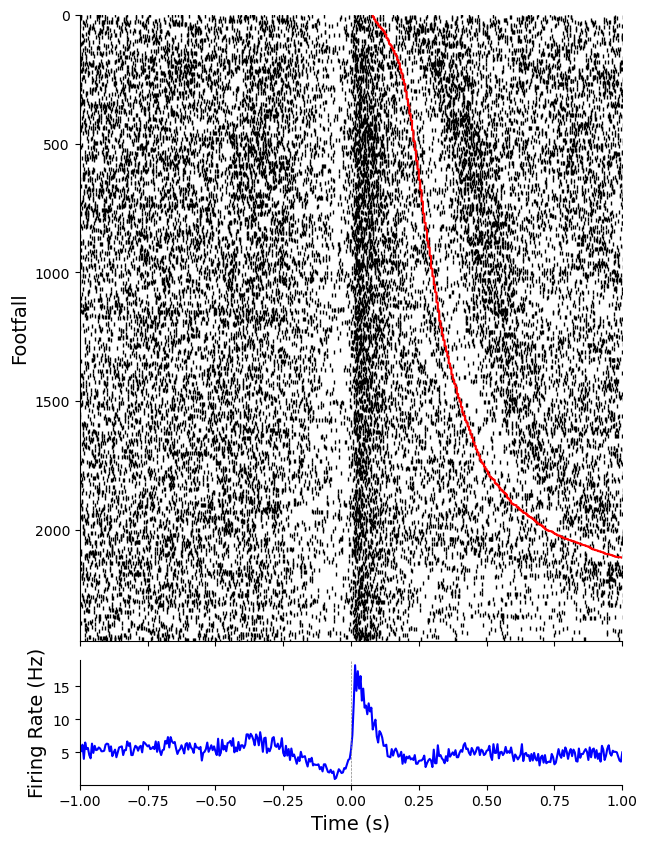

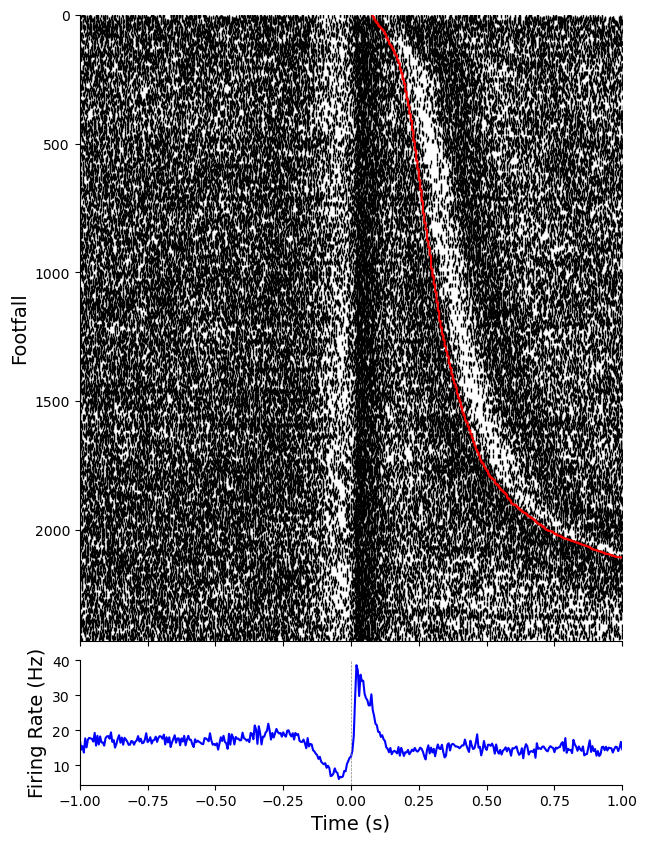

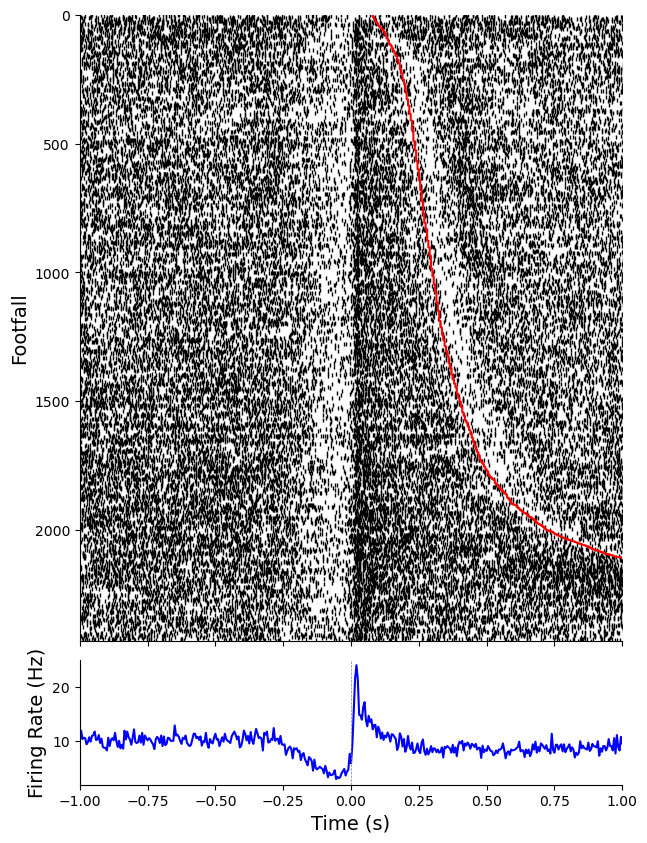

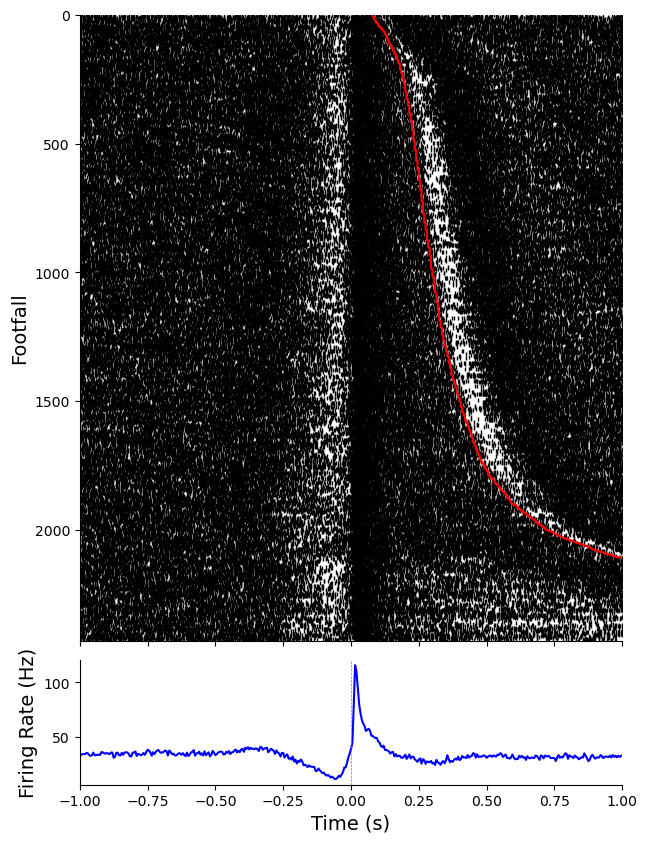

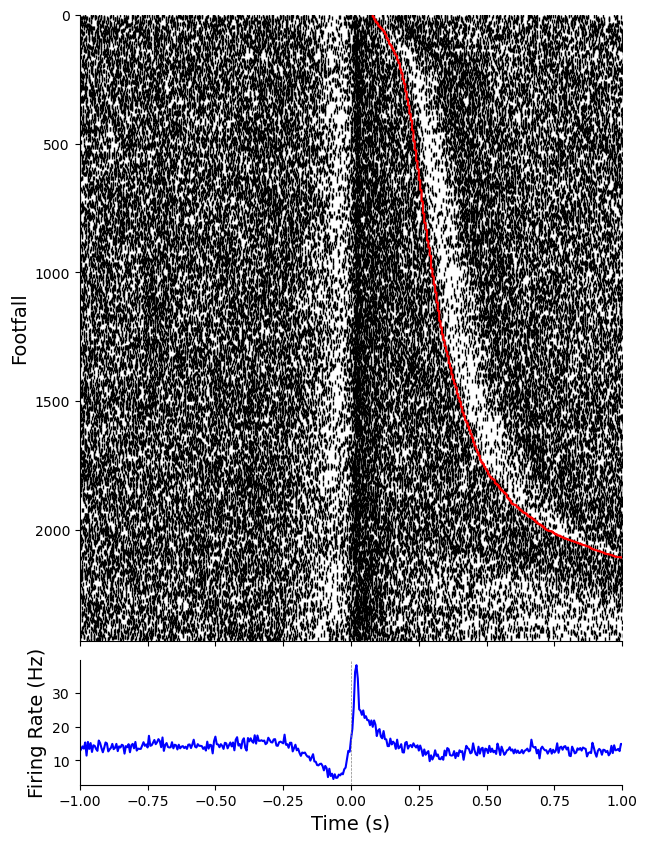

...

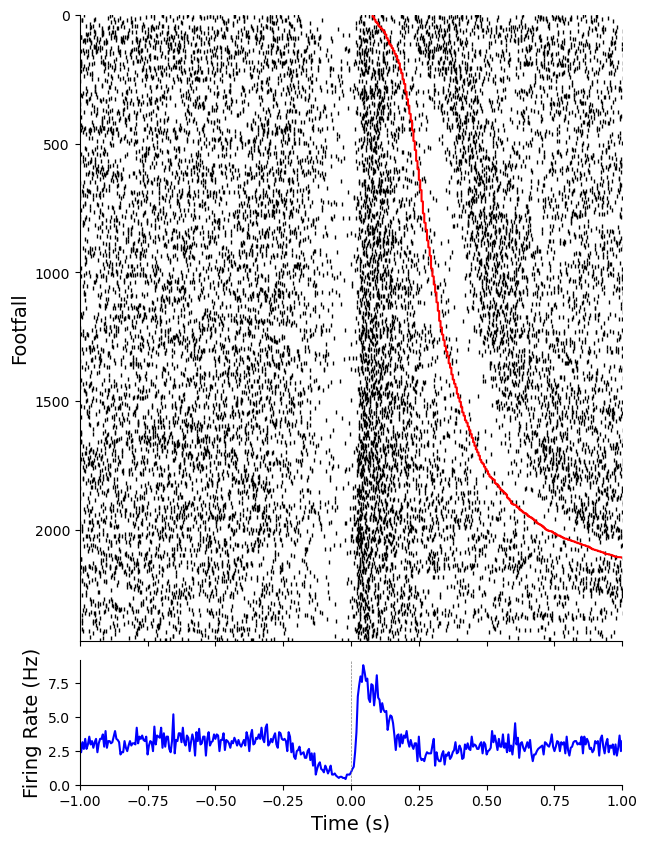

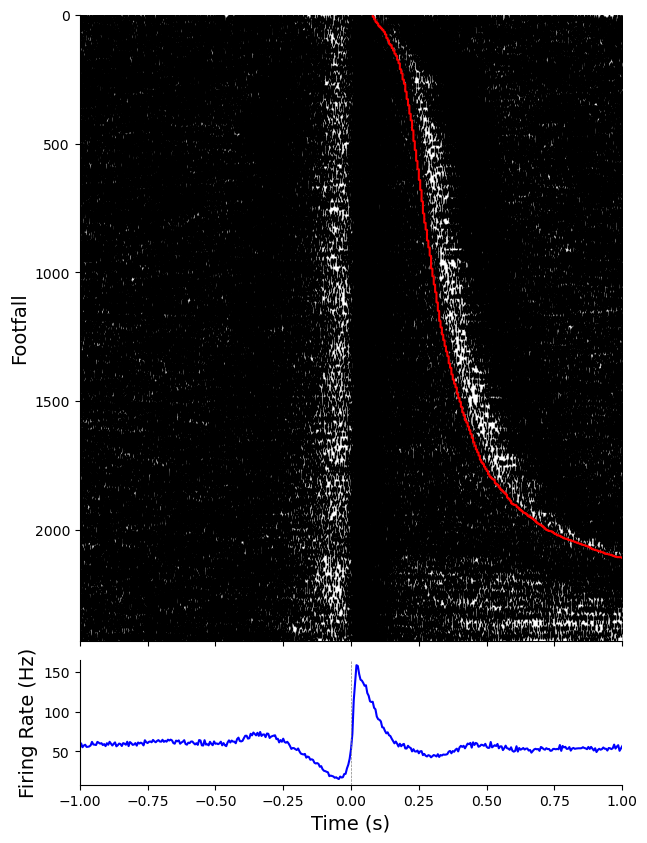

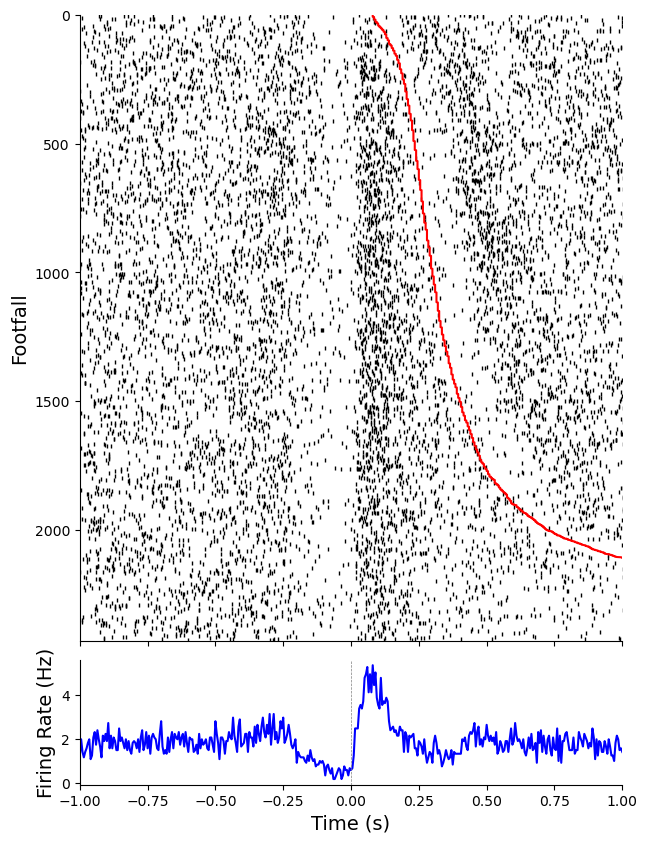

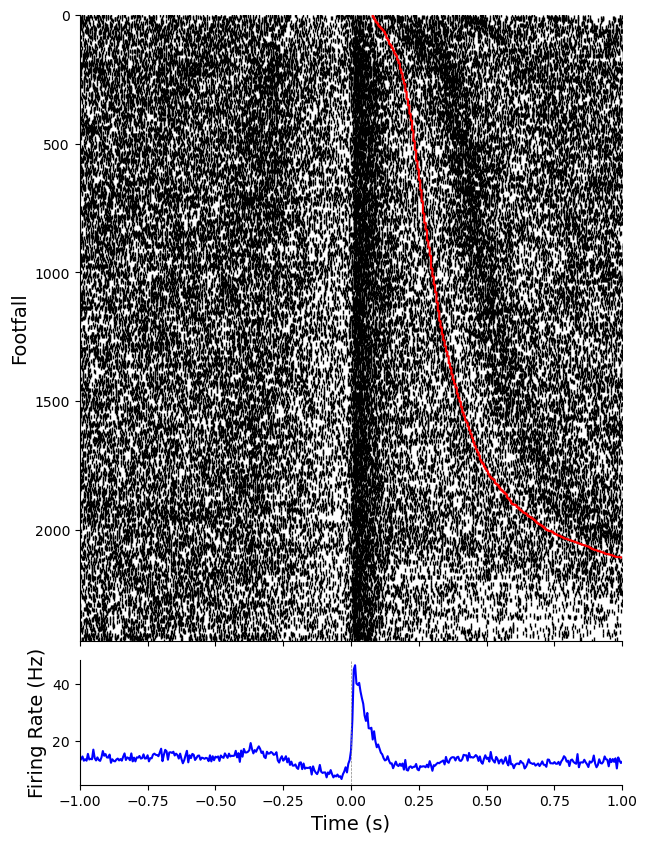

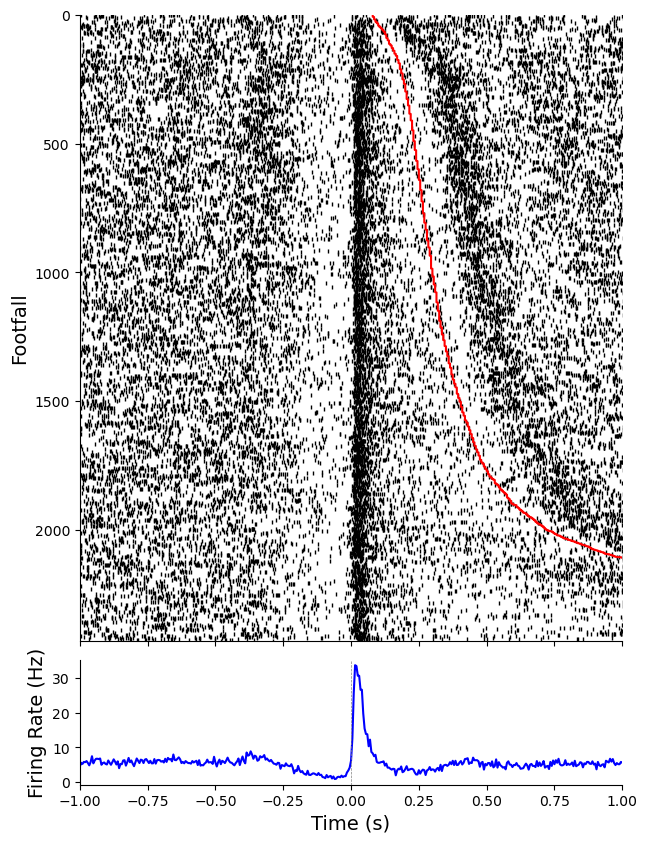

In [125]:
## sort by duration -- predictions

for i, unit in enumerate(np.unique(goodSpikes)):
    f,ax = plt.subplots(2,1,gridspec_kw={'height_ratios':[5,1]},figsize=[7,10])
    for j, ind in enumerate(np.argsort(durations_includedInSweeps)):
        unitIndex = goodspikes_footfalls_DE_P[ind] == unit
        ax[0].plot(goodsamples_footfalls_DE_P[ind][unitIndex]/20000,np.ones(sum(unitIndex))+j,'|',lw=0.3,ms=3,color='k')
    ax[0].plot(np.sort(durations_includedInSweeps)/200,np.arange(len(durations_includedInSweeps)),color='r')
    ax[1].plot(footfall_psth_DE_P['xaxis'],footfall_psth_DE_P['psths'][:,i],color='blue')
    ax[1].axvline(0,ls='--',lw=0.5,color='gray')
    #ax[0].set_title('Unit {}'.format(unit))
    
    ax[0].set_xlim([-1,1])
    ax[1].set_xlim([-1,1])
    ax[0].set_xticklabels([])
    
    ax[0].spines['right'].set_visible(False)
    ax[0].spines['top'].set_visible(False)
    ax[1].spines['right'].set_visible(False)
    ax[1].spines['top'].set_visible(False)
    
    ax[1].set_ylabel('Firing Rate (Hz)',fontsize=14)
    ax[1].set_xlabel('Time (s)',fontsize=14)
    ax[0].set_ylabel('Footfall',fontsize=14)
    
    ax[0].set_ylim([0,len(goodsamples_footfalls_DE_P)])
    ax[0].invert_yaxis()
    
    plt.subplots_adjust(hspace=0.05)
    plt.show()
    plt.close()

In [83]:
orientations = np.load('gratingClassifications_AE.npy')
print(len(orientations))

2449


In [84]:
sweepInd_DE_P = np.array(sweepInd_DE_P)

orientations_includedInSweeps = orientations[np.array(durInd_DE_P)]


goodsamples_footfalls_ori = [goodsamples_footfalls_DE_P[n] for n in np.arange(len(sweepInd_DE_P))[sweepInd_DE_P<4]]
goodspikes_footfalls_ori = [goodspikes_footfalls_DE_P[n] for n in np.arange(len(sweepInd_DE_P))[sweepInd_DE_P<4]]

goodsamples_footfalls_oriWide = [goodsamples_footfalls_DE_P[n] for n in np.arange(len(sweepInd_DE_P))[sweepInd_DE_P>3]]
goodspikes_footfalls_oriWide = [goodspikes_footfalls_DE_P[n] for n in np.arange(len(sweepInd_DE_P))[sweepInd_DE_P>3]]

In [85]:
len(goodsamples_footfalls_ori)# + len(goodsamples_footfalls_oriWide)

1130

In [86]:
orientations_includedInSweeps_narrow = orientations_includedInSweeps[:1130]#.shape
orientations_includedInSweeps_wide = orientations_includedInSweeps[1130:]

In [87]:
## creating orientation-dependent psths

psth_orient_narrow = {}

for ori in [1,2,3,4]:
    ind = np.where(orientations_includedInSweeps_narrow == ori)[0]
    psth_orient_narrow[ori] = analyzeMEA.rastPSTH.singleSweepPSTH(0.02,[goodsamples_footfalls_ori[n]+20000 for n in ind],
                                       [goodspikes_footfalls_ori[n] for n in ind],
                                        units=np.unique(goodSpikes),bs_window=[0,0.5])

psth_orient_wide = {}

for ori in [1,2,3,4]:
    ind = np.where(orientations_includedInSweeps_wide == ori)[0]
    psth_orient_wide[ori] = analyzeMEA.rastPSTH.singleSweepPSTH(0.02,[goodsamples_footfalls_oriWide[n]+20000 for n in ind],
                                       [goodspikes_footfalls_oriWide[n] for n in ind],
                                        units=np.unique(goodSpikes),bs_window=[0,0.5])
    

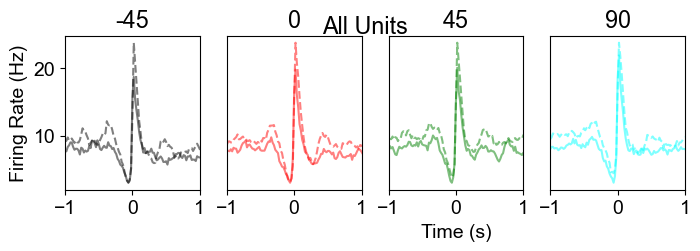

In [88]:
colors=['k','r','g','cyan']
f, ax = plt.subplots(1,4,figsize=[8,2])
plt.suptitle('All Units')
oris = [-45, 0, 45, 90]
for ori in [1,2,3,4]:
    ax[ori-1].plot(psth_orient_narrow[ori]['xaxis']-1,psth_orient_narrow[ori]['psths_mean'].mean(-1),label=ori,color=colors[ori-1],alpha=0.5)
    ax[ori-1].plot(psth_orient_wide[ori]['xaxis']-1,psth_orient_wide[ori]['psths_mean'].mean(-1),label=ori,color=colors[ori-1],alpha=0.5,ls='--')
    
    ax[ori-1].set_xlim([-1,1])
    #ax[ori-1].set_ylim([1,7])
    ax[ori-1].set_title(oris[ori-1])
    if ori >1:
        ax[ori-1].set_yticks([])
ax[2].set_xlabel('Time (s)')
ax[0].set_ylabel('Firing Rate (Hz)')
plt.show()
plt.close()

In [89]:
psth_orient_narrow[1]['xaxis'][20:22]

array([0.4 , 0.42])

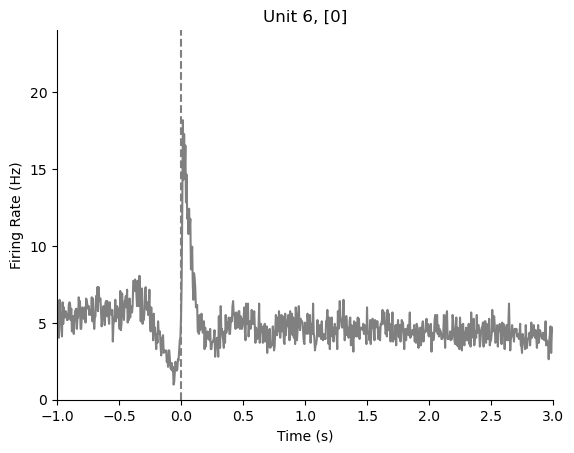

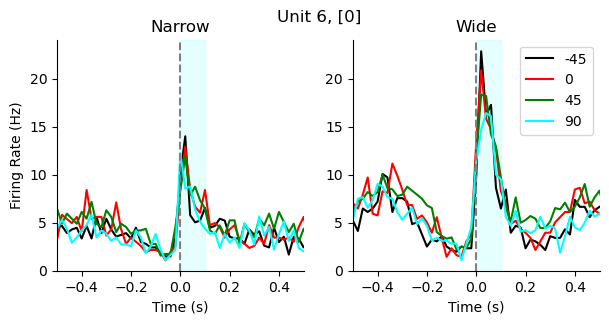

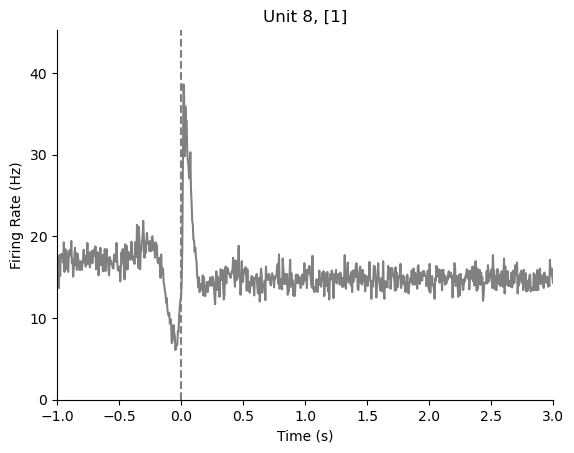

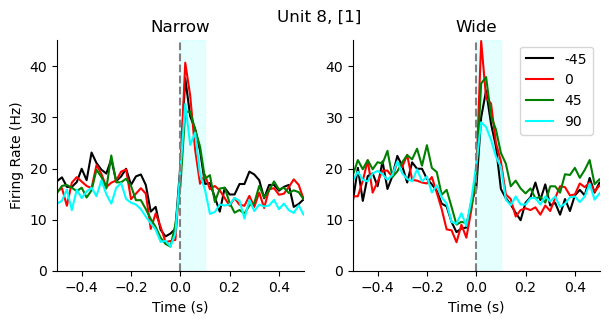

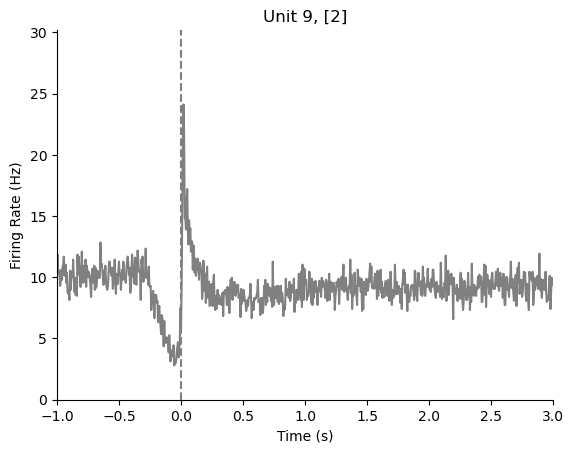

...

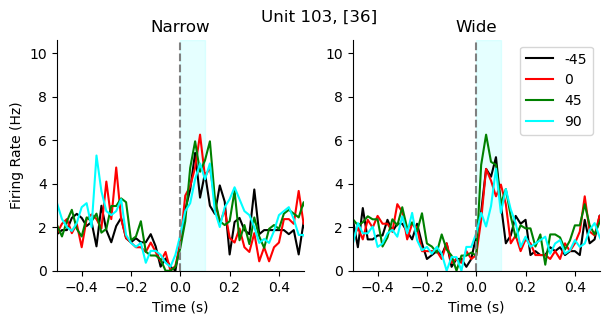

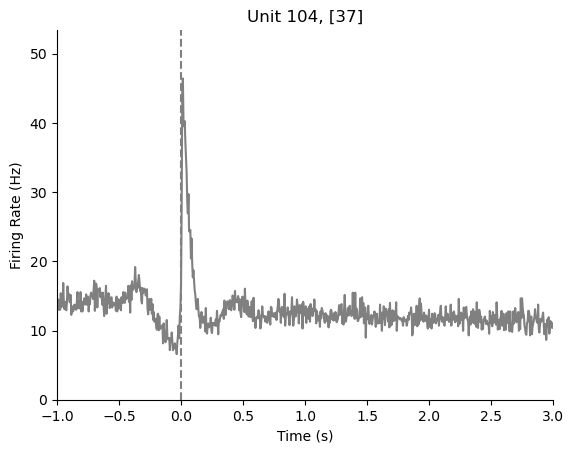

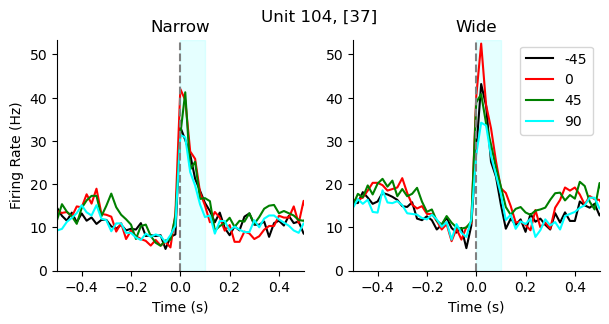

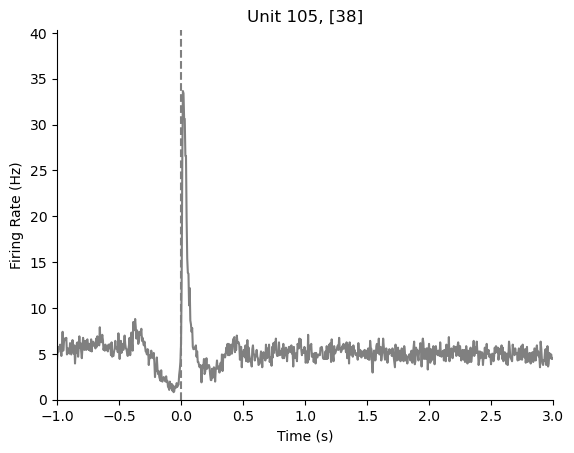

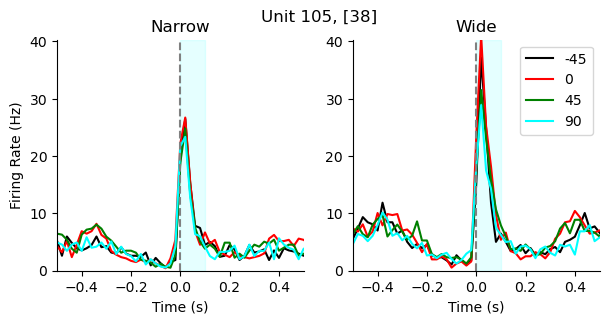

In [123]:
import seaborn as sns
colors=['k','r','g','cyan']
orientations = [-45, 0, 45, 90]
for unit in range(len(np.unique(goodSpikes))):
    plt.figure()
    plt.title('Unit {}, [{}]'.format(np.unique(goodSpikes)[unit],unit))
    plt.plot(footfall_psth_DE_P['xaxis'],footfall_psth_DE_P['psths'][:,unit],color='gray')
    plt.axvline(0,color='gray',ls='--')
    plt.xlabel('Time (s)')
    plt.xlim([-1,3])
    y_max = plt.ylim()[1] + 5
    plt.ylim([0,y_max])
    plt.ylabel('Firing Rate (Hz)')
    sns.despine()
    plt.show()
    plt.close()
    
    
    
    f,ax = plt.subplots(1,2,figsize=[7,3])
    f.suptitle('Unit {}, [{}]'.format(np.unique(goodSpikes)[unit],unit))
    for ori in [1,2,3,4]:
        ax[0].plot(psth_orient_narrow[ori]['xaxis']-1,psth_orient_narrow[ori]['psths_mean'][:,unit],label=orientations[ori-1],color=colors[ori-1])
        ax[1].plot(psth_orient_wide[ori]['xaxis']-1,psth_orient_wide[ori]['psths_mean'][:,unit],label=orientations[ori-1],color=colors[ori-1])
    
    for a in range(len(ax)):
        ax[a].axvline(0,color='gray',ls='--')
        ax[a].axvspan(0,0.1,color='cyan',alpha=0.1)
        ax[a].set_xlabel('Time (s)')
        ax[a].set_xlim([-0.5,0.5])
        ax[a].set_ylim([0,y_max])
    ax[0].set_ylabel('Firing Rate (Hz)')
    ax[1].legend()
    ax[0].set_title('Narrow')
    ax[1].set_title('Wide')
    sns.despine()
    plt.show()
    plt.close()
    
    
    

In [95]:
window = [19,25]

trialRates_narrow = {}
trialRates_wide = {}
for ori in [1,2,3,4]:
    trialRates_narrow[ori] = psth_orient_narrow[ori]['psths'][window[0]:window[1],:,:].mean(0)
    trialRates_wide[ori] = psth_orient_wide[ori]['psths'][window[0]:window[1],:,:].mean(0)

In [107]:
trialRates_narrow[4][:,0]

array([ 0.        ,  8.33333333,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  8.33333333,  0.        ,  8.33333333,
        8.33333333,  0.        ,  8.33333333, 25.        ,  0.        ,
        8.33333333,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        , 16.66666667,  0.        ,
        0.        ,  8.33333333,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  8.33333333,  8.33333333,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        , 33.33333333,
        0.        ,  0.        , 16.66666667,  8.33333333,  0.        ,
        0.        , 16.66666667,  0.        ,  8.33333333,  0.        ,
        0.        ,  8.33333333,  0.        ,  0.        ,  8.33333333,
        0.        ,  8.33333333,  0.        ,  0.        , 25.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.  

In [96]:
import importlib
importlib.reload(analyzeMEA.wheel)

<module 'analyzeMEA.wheel' from 'C:\\Users\\ajemanu\\Documents\\GitHub\\analyzeMEA\\analyzeMEA\\wheel.py'>

Without multiple comparison correction:
6 of 39 units are OS
Units [ 8  9 33 49 68 86]

With HS correction:
1 of 39 units are OS
Units [9]


meta NOT subset; don't know how to subset; dropped


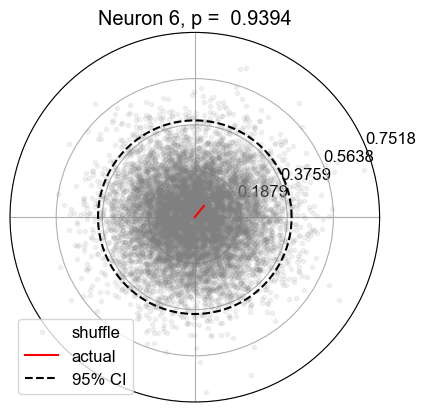

meta NOT subset; don't know how to subset; dropped


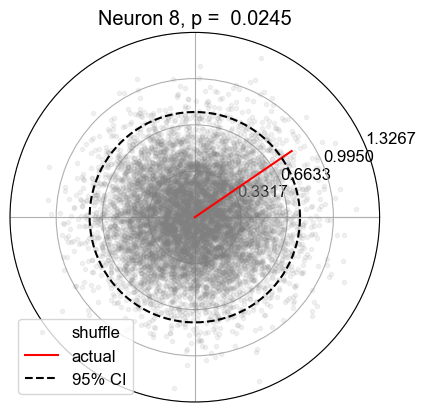

meta NOT subset; don't know how to subset; dropped


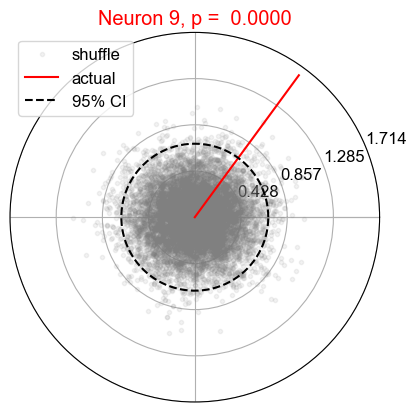

meta NOT subset; don't know how to subset; dropped


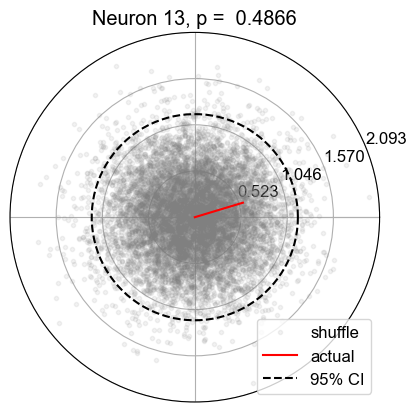

meta NOT subset; don't know how to subset; dropped


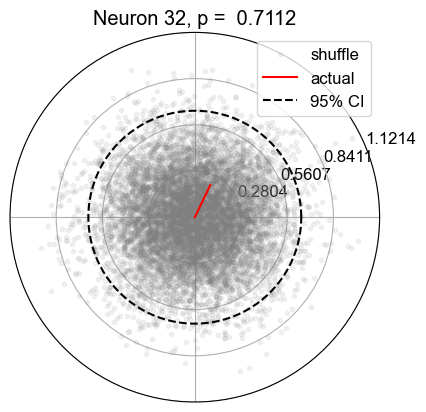

meta NOT subset; don't know how to subset; dropped


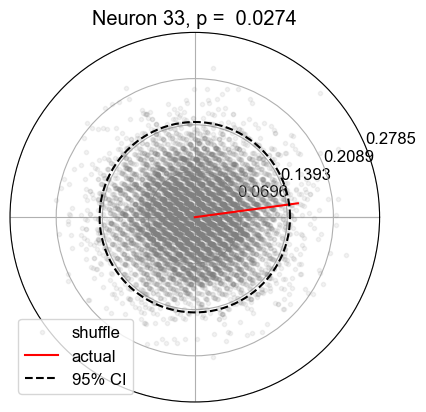

meta NOT subset; don't know how to subset; dropped


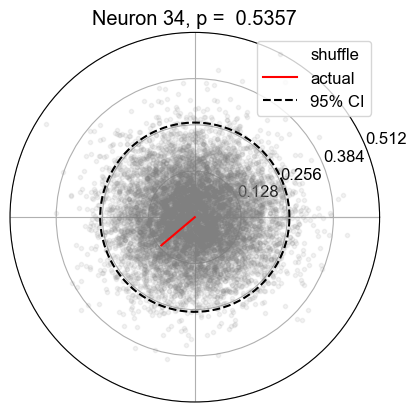

meta NOT subset; don't know how to subset; dropped


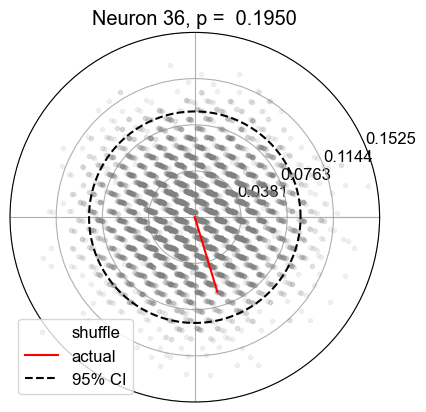

meta NOT subset; don't know how to subset; dropped


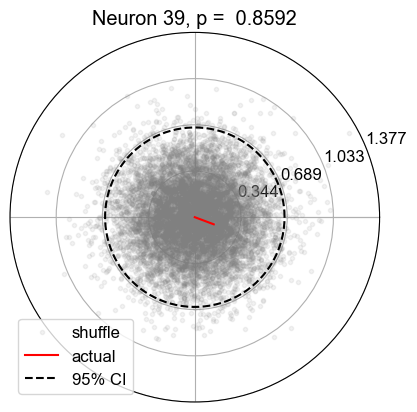

meta NOT subset; don't know how to subset; dropped


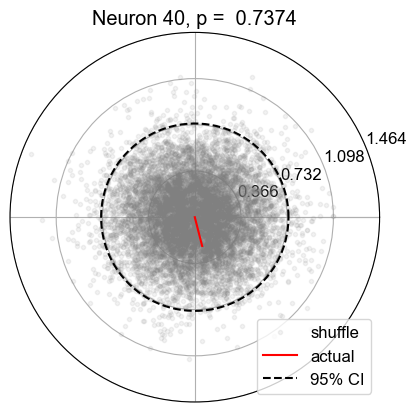

meta NOT subset; don't know how to subset; dropped


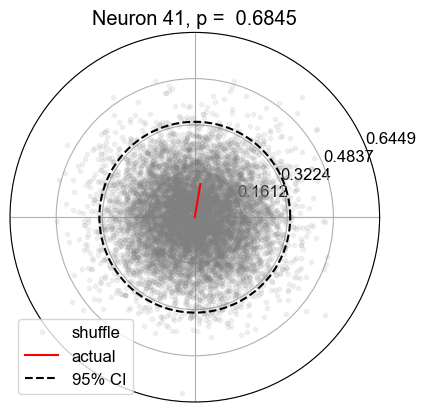

meta NOT subset; don't know how to subset; dropped


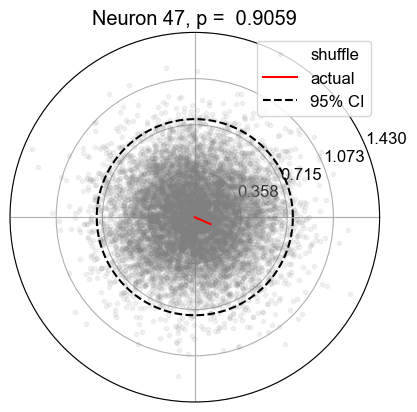

meta NOT subset; don't know how to subset; dropped


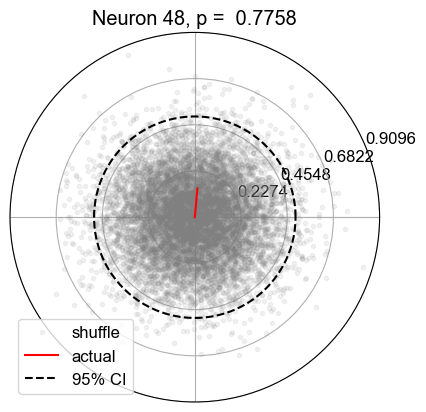

meta NOT subset; don't know how to subset; dropped


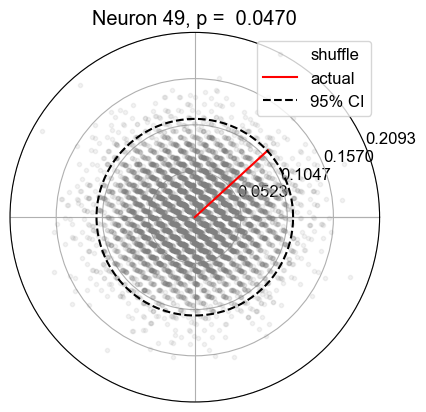

meta NOT subset; don't know how to subset; dropped


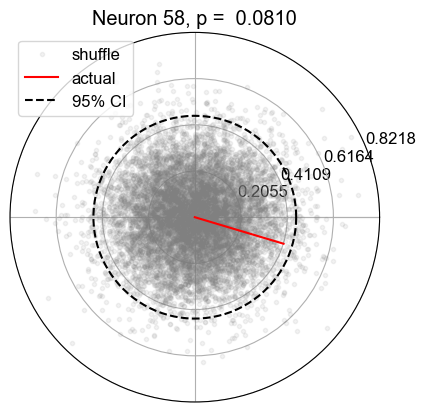

meta NOT subset; don't know how to subset; dropped


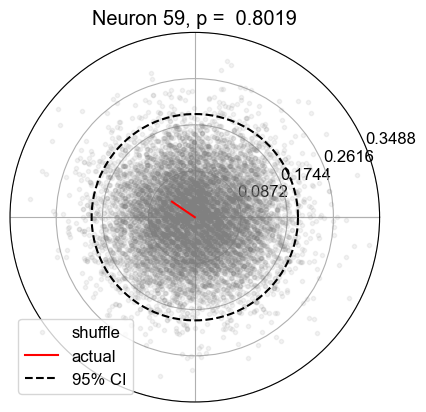

meta NOT subset; don't know how to subset; dropped


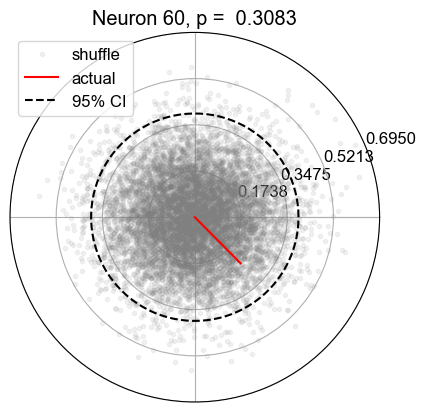

meta NOT subset; don't know how to subset; dropped


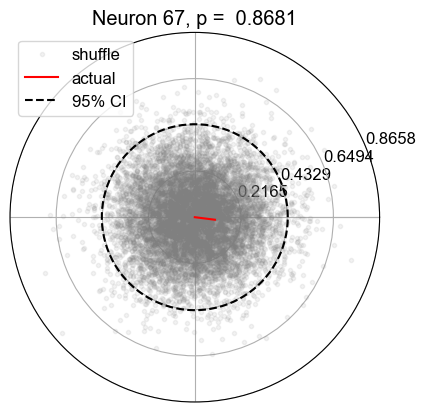

meta NOT subset; don't know how to subset; dropped


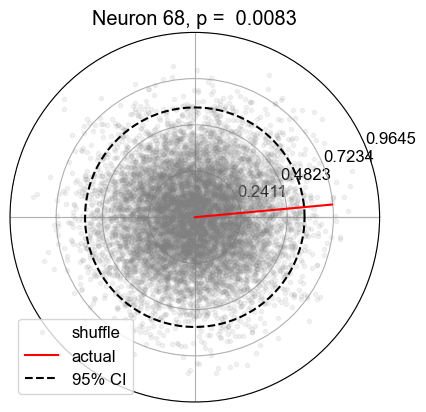

meta NOT subset; don't know how to subset; dropped


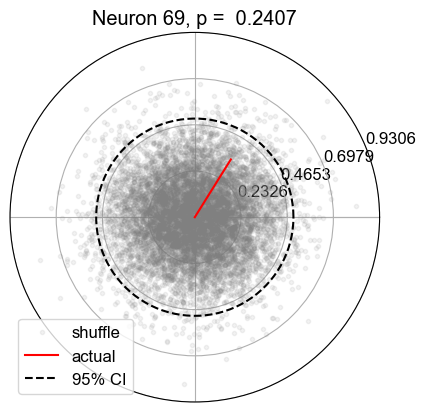

meta NOT subset; don't know how to subset; dropped


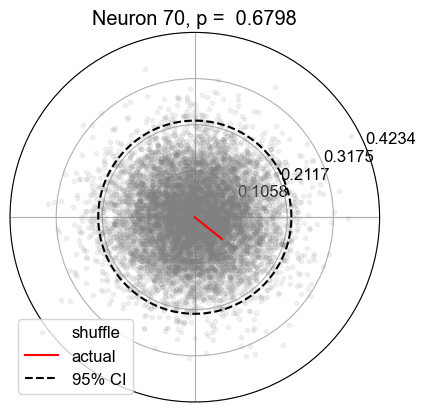

meta NOT subset; don't know how to subset; dropped


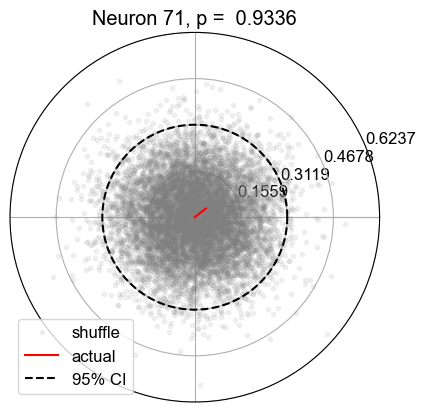

meta NOT subset; don't know how to subset; dropped


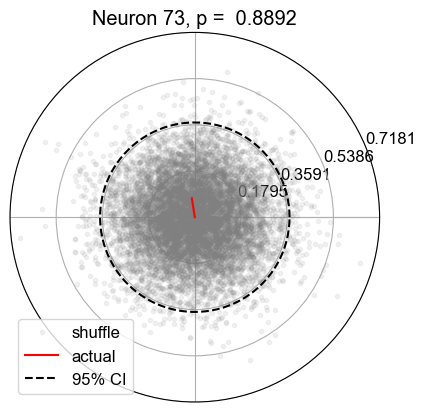

meta NOT subset; don't know how to subset; dropped


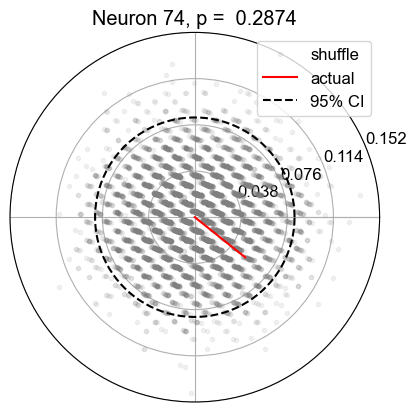

meta NOT subset; don't know how to subset; dropped


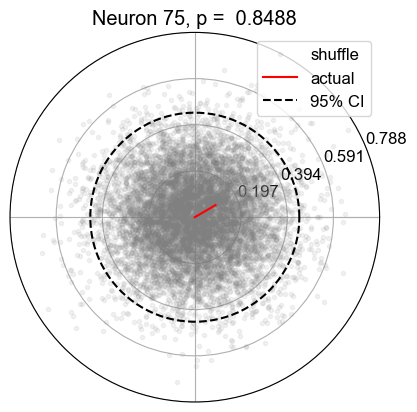

meta NOT subset; don't know how to subset; dropped


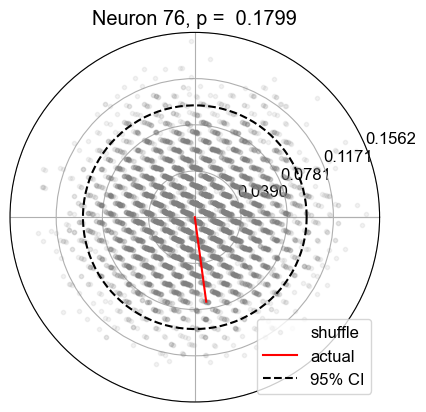

meta NOT subset; don't know how to subset; dropped


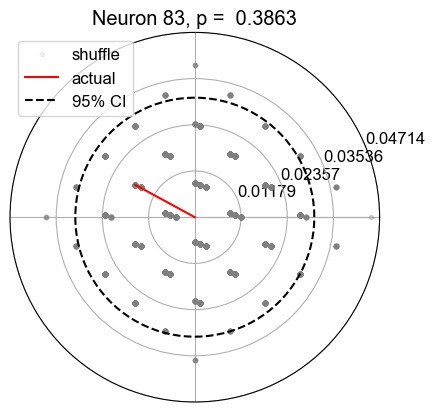

meta NOT subset; don't know how to subset; dropped


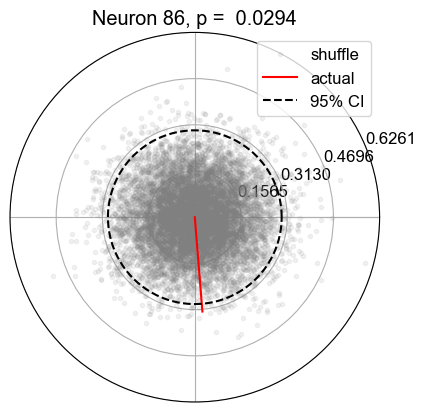

meta NOT subset; don't know how to subset; dropped


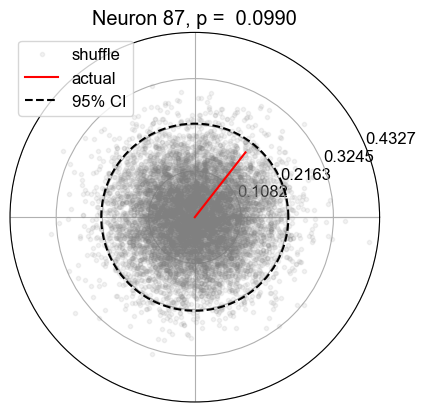

meta NOT subset; don't know how to subset; dropped


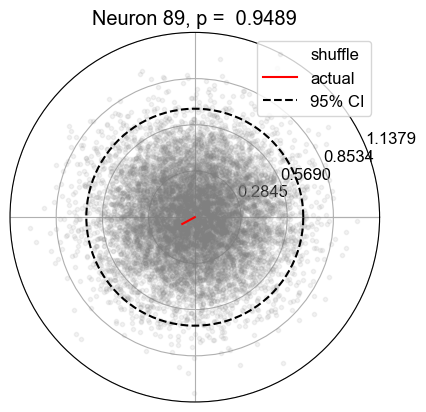

meta NOT subset; don't know how to subset; dropped


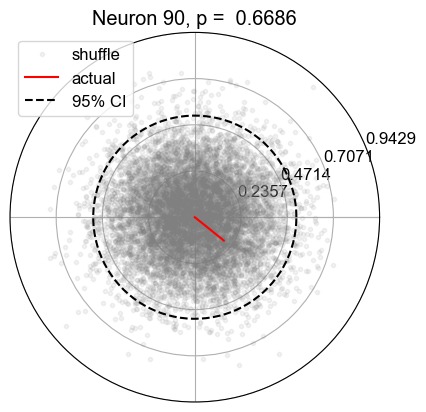

meta NOT subset; don't know how to subset; dropped


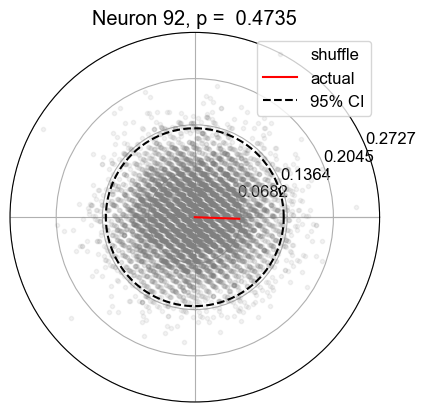

meta NOT subset; don't know how to subset; dropped


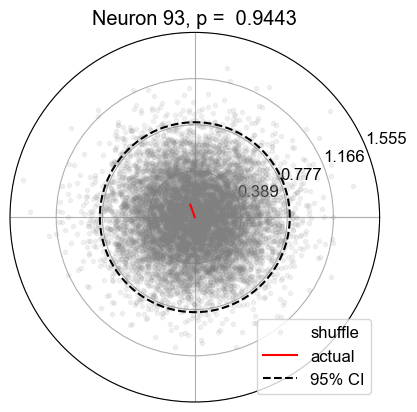

meta NOT subset; don't know how to subset; dropped


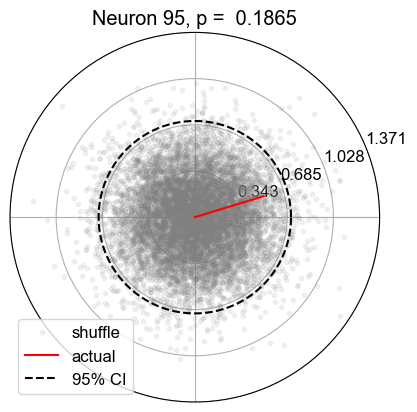

meta NOT subset; don't know how to subset; dropped


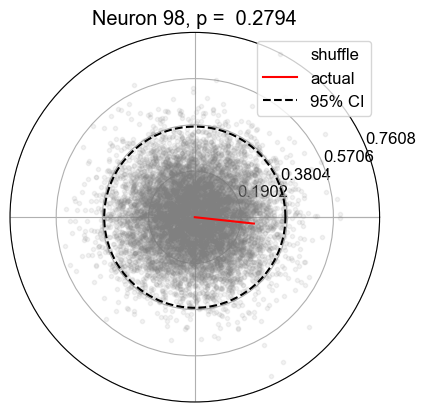

meta NOT subset; don't know how to subset; dropped


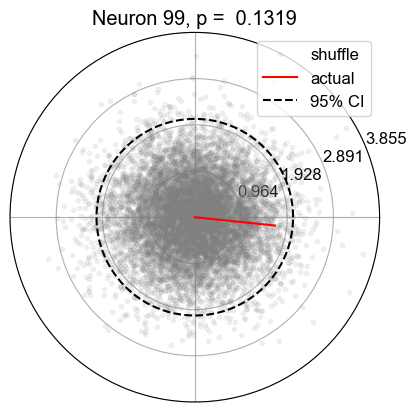

meta NOT subset; don't know how to subset; dropped


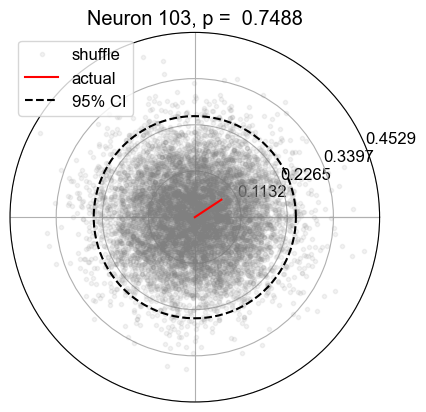

meta NOT subset; don't know how to subset; dropped


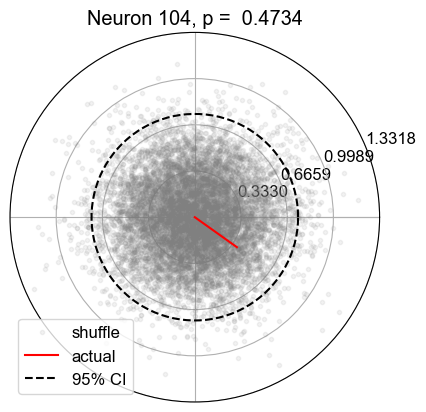

meta NOT subset; don't know how to subset; dropped


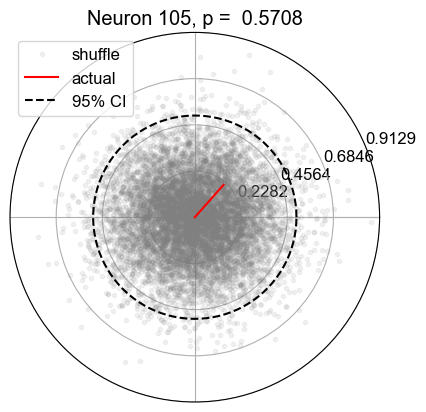

In [97]:
pvalues, OSunits_narrow, OSunits_noCorrection, meanVector, meanShuffledVectors = analyzeMEA.wheel.permuteOS(trialRates_narrow,np.unique(goodSpikes))

In [98]:
print(OSunits_narrow)
mv_narrow = (np.arctan2(meanVector[:,1],meanVector[:,0]),(meanVector[:,0]**2 + meanVector[:,1]**2)**0.5)

[9]


Without multiple comparison correction:
7 of 39 units are OS
Units [ 8  9 58 73 75 86 90]

With HS correction:
1 of 39 units are OS
Units [86]


meta NOT subset; don't know how to subset; dropped


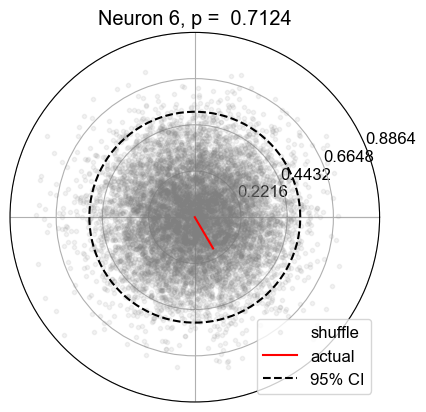

meta NOT subset; don't know how to subset; dropped


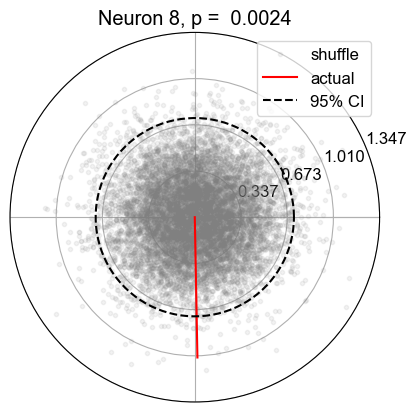

meta NOT subset; don't know how to subset; dropped


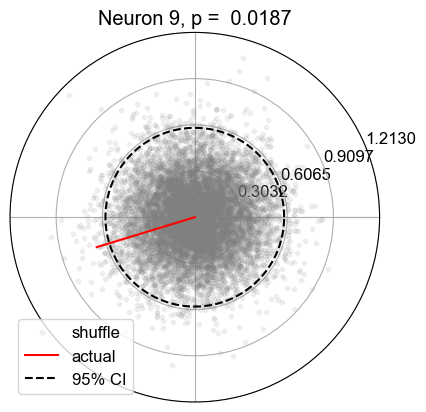

meta NOT subset; don't know how to subset; dropped


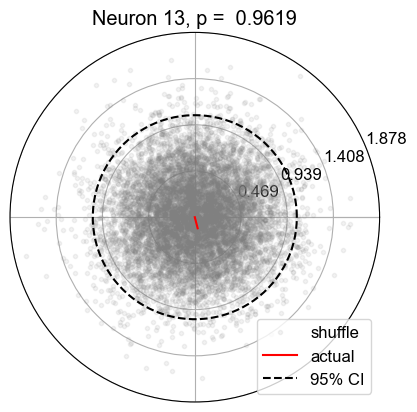

meta NOT subset; don't know how to subset; dropped


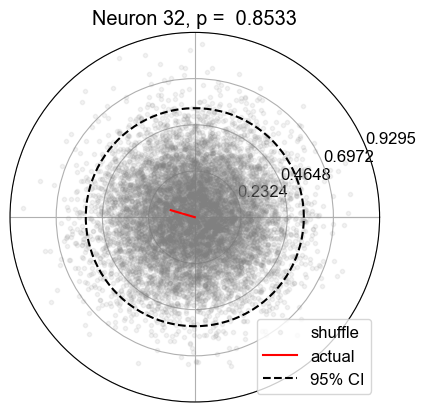

meta NOT subset; don't know how to subset; dropped


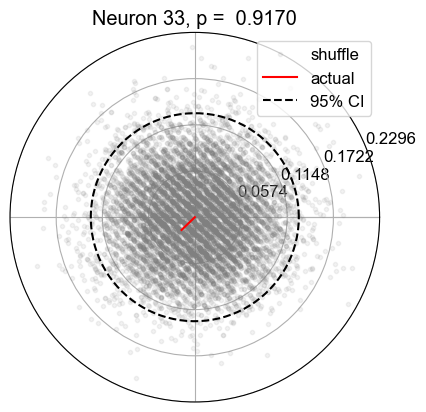

meta NOT subset; don't know how to subset; dropped


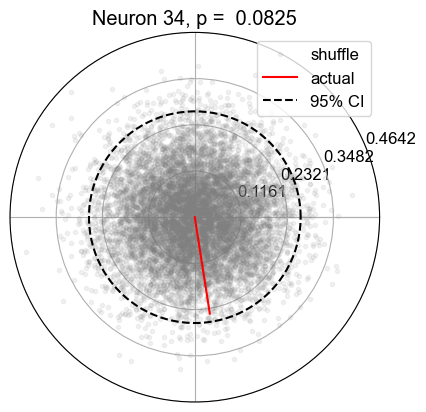

meta NOT subset; don't know how to subset; dropped


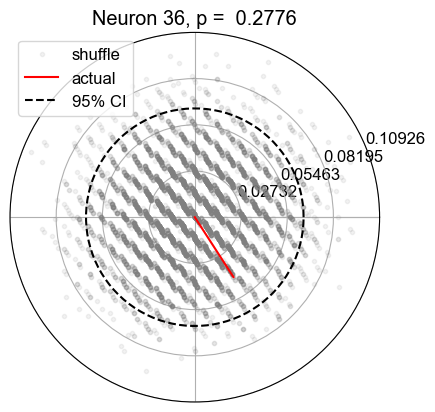

meta NOT subset; don't know how to subset; dropped


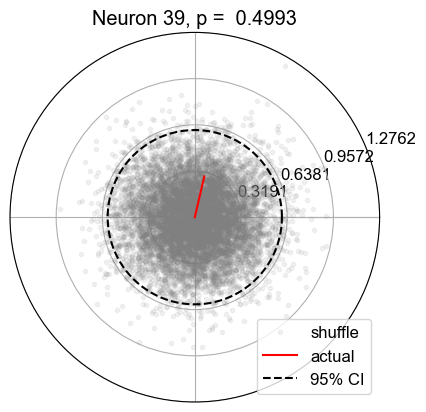

meta NOT subset; don't know how to subset; dropped


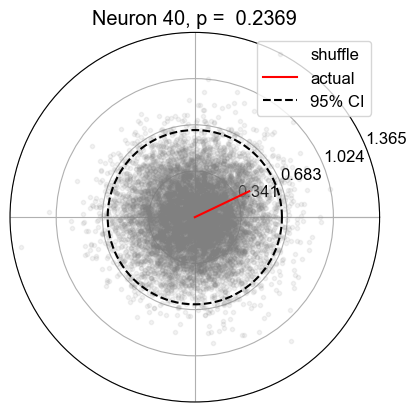

meta NOT subset; don't know how to subset; dropped


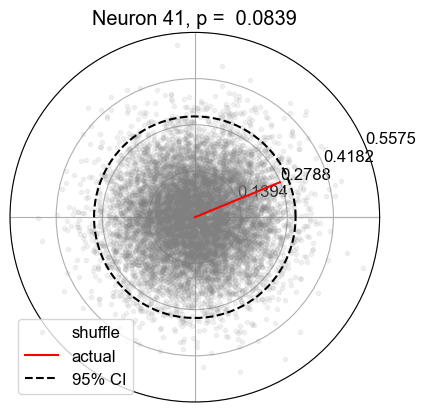

meta NOT subset; don't know how to subset; dropped


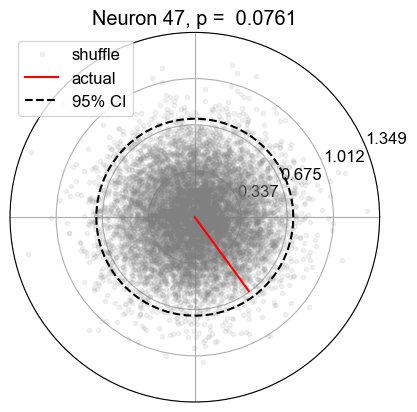

meta NOT subset; don't know how to subset; dropped


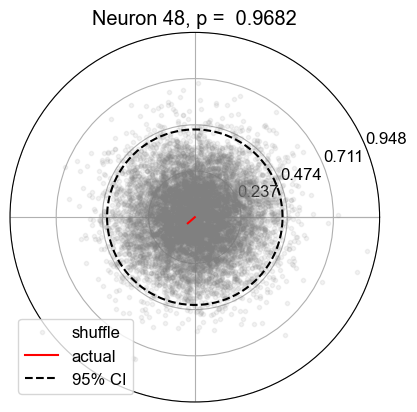

meta NOT subset; don't know how to subset; dropped


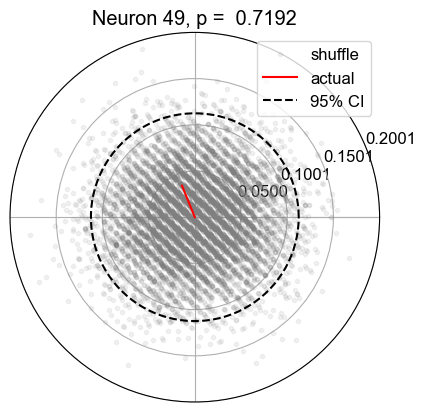

meta NOT subset; don't know how to subset; dropped


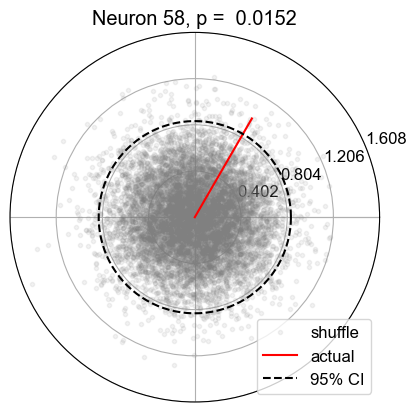

meta NOT subset; don't know how to subset; dropped


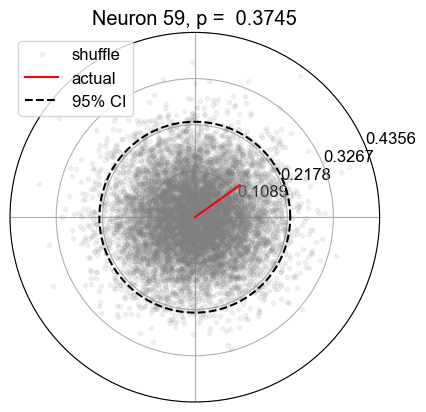

meta NOT subset; don't know how to subset; dropped


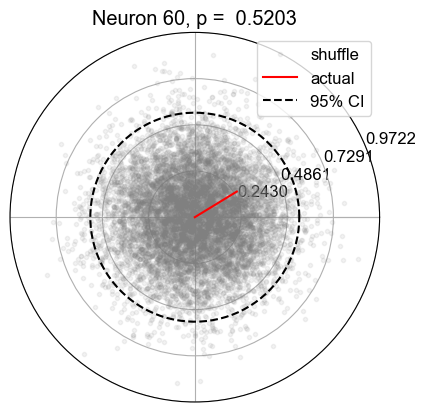

meta NOT subset; don't know how to subset; dropped


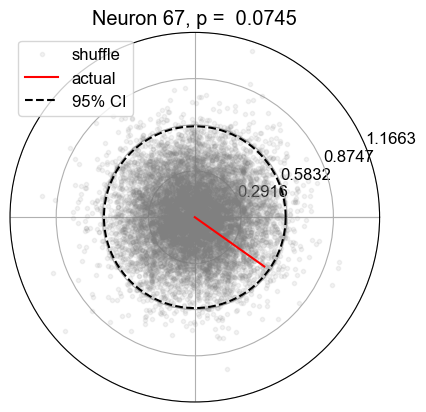

meta NOT subset; don't know how to subset; dropped


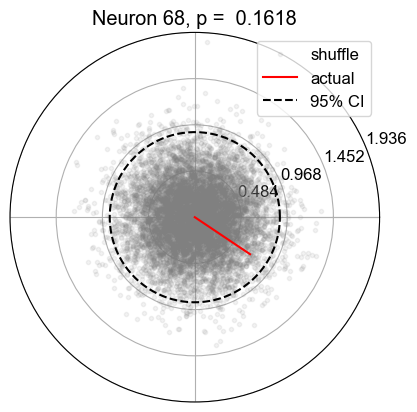

meta NOT subset; don't know how to subset; dropped


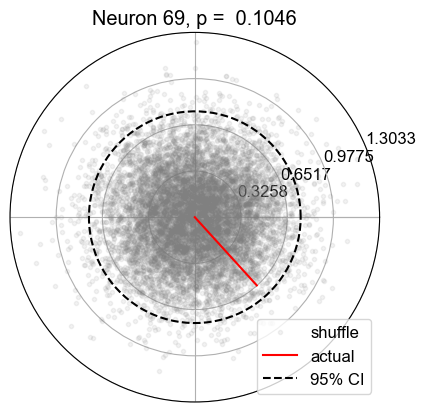

meta NOT subset; don't know how to subset; dropped


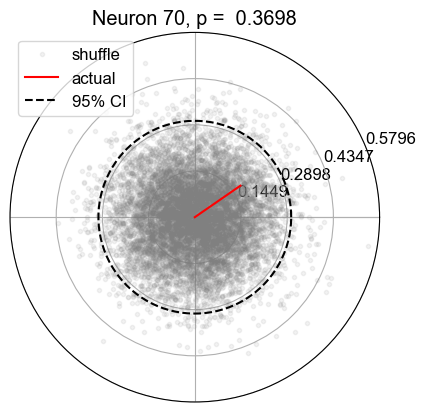

meta NOT subset; don't know how to subset; dropped


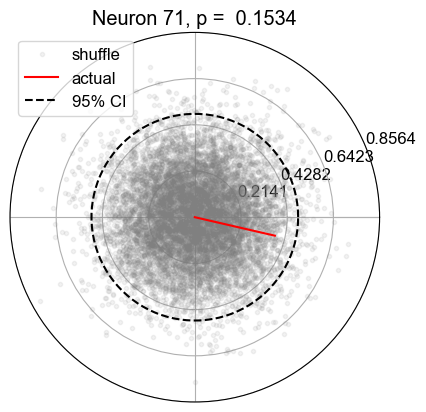

meta NOT subset; don't know how to subset; dropped


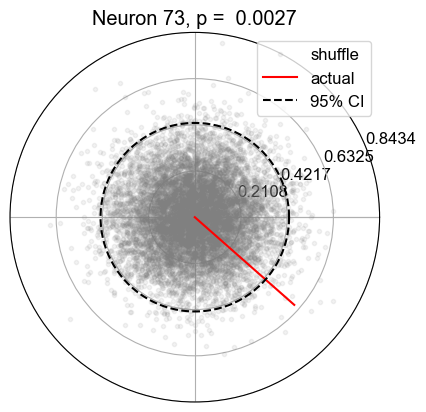

meta NOT subset; don't know how to subset; dropped


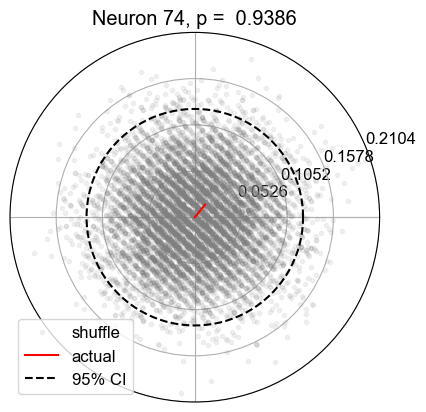

meta NOT subset; don't know how to subset; dropped


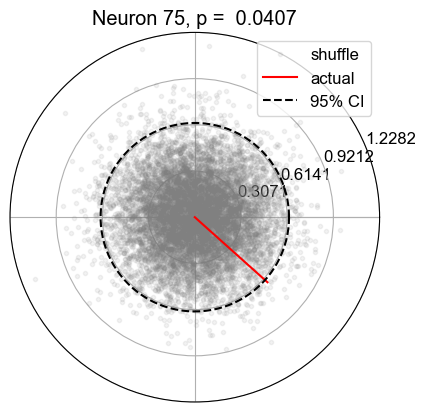

meta NOT subset; don't know how to subset; dropped


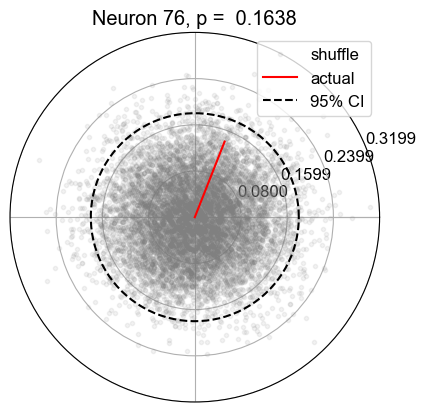

meta NOT subset; don't know how to subset; dropped


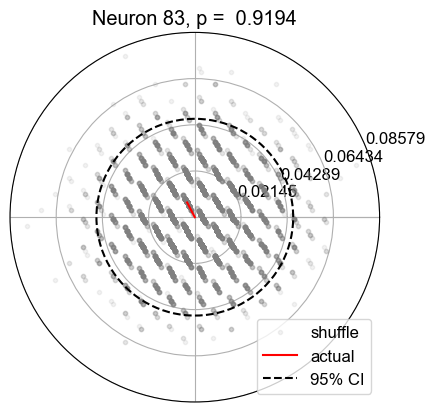

meta NOT subset; don't know how to subset; dropped


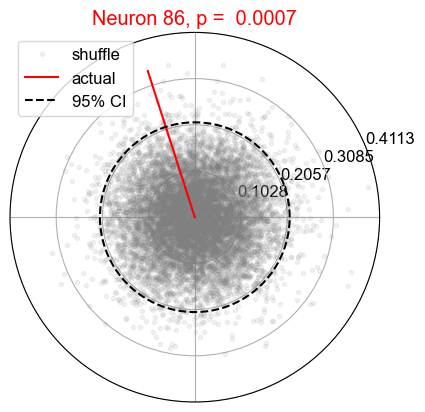

meta NOT subset; don't know how to subset; dropped


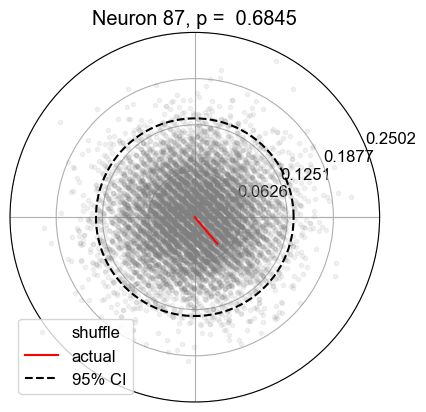

meta NOT subset; don't know how to subset; dropped


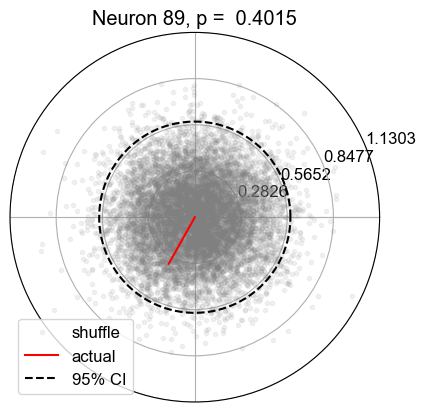

meta NOT subset; don't know how to subset; dropped


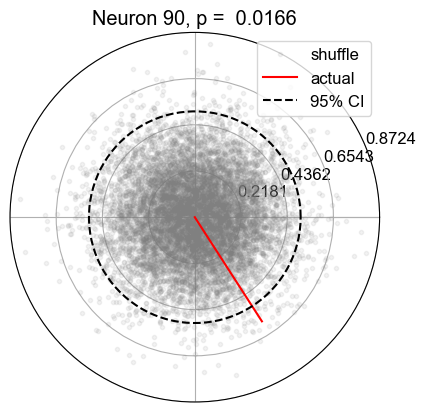

meta NOT subset; don't know how to subset; dropped


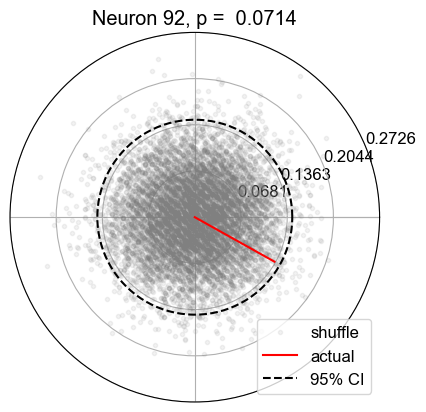

meta NOT subset; don't know how to subset; dropped


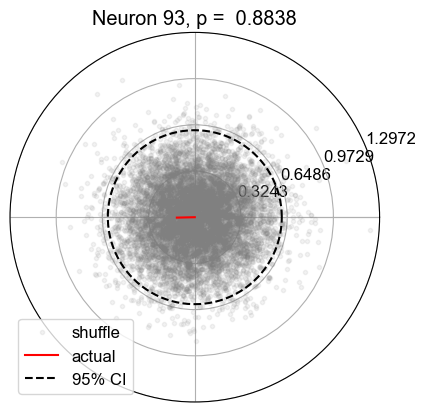

meta NOT subset; don't know how to subset; dropped


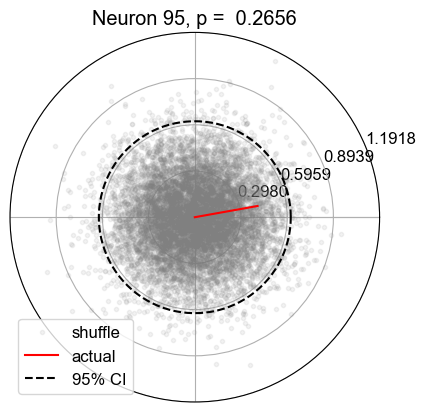

meta NOT subset; don't know how to subset; dropped


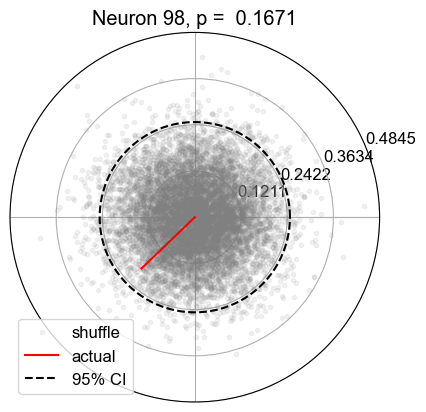

meta NOT subset; don't know how to subset; dropped


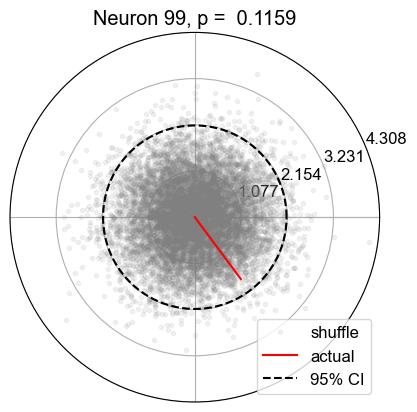

meta NOT subset; don't know how to subset; dropped


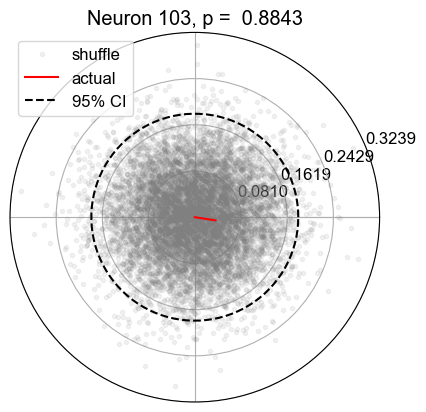

meta NOT subset; don't know how to subset; dropped


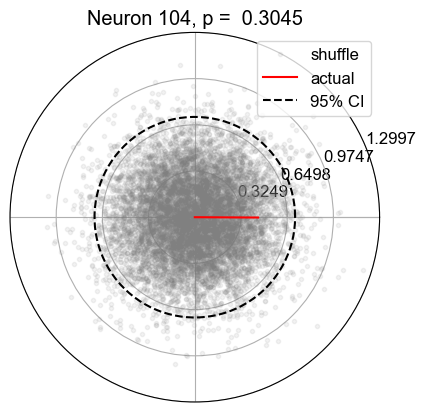

meta NOT subset; don't know how to subset; dropped


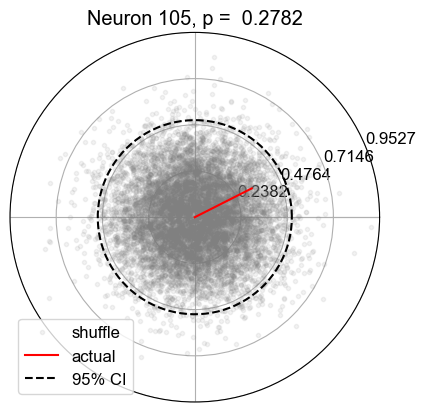

In [99]:
pvalues, OSunits_wide, OSunits_noCorrection, meanVector, meanShuffledVectors = analyzeMEA.wheel.permuteOS(trialRates_wide,np.unique(goodSpikes))

In [90]:
print(OSunits_wide)
mv_wide = (np.arctan2(meanVector[:,1],meanVector[:,0]),(meanVector[:,0]**2 + meanVector[:,1]**2)**0.5)

[  8  39  40  41  47  48  58  59  60  67  68  69  70  71  73  75  76  90
  92  98  99 104 105]


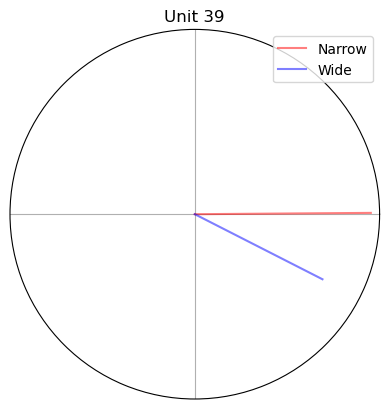

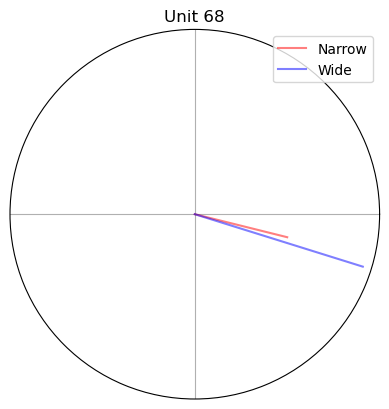

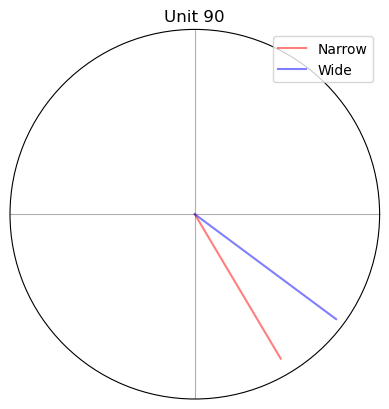

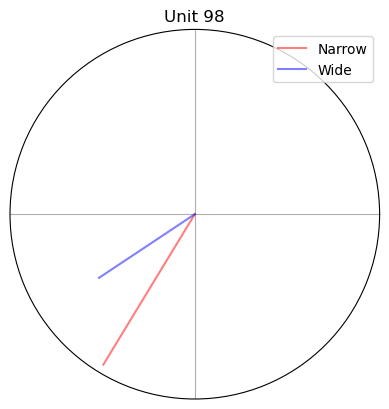

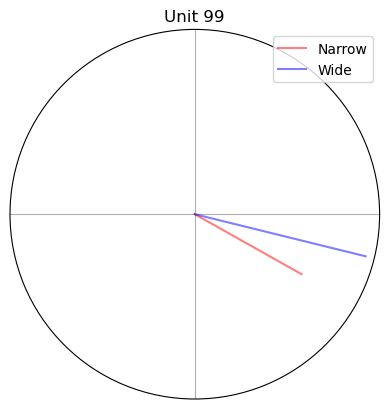

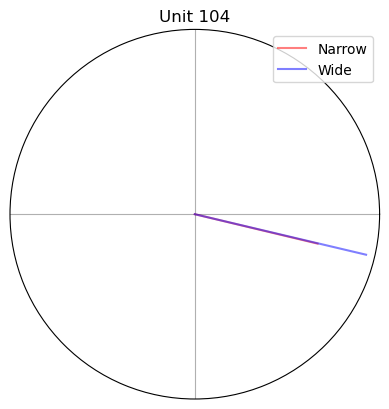

In [117]:
OSunits_narrow_ind = np.array([n in OSunits_narrow for n in np.unique(goodSpikes)])
OSunits_wide_ind = np.array([n in OSunits_wide for n in np.unique(goodSpikes)])

for unit in range(len(np.unique(goodSpikes))):
    if unit in np.where(np.bitwise_and(OSunits_narrow_ind,OSunits_wide_ind))[0]: ## OS both narrow and wide
        plt.figure()
        ax = plt.axes(polar=True)
        ax.plot([0,mv_narrow[0][unit]],[0,mv_narrow[1][unit]],color='r',label='Narrow',alpha=0.5)
        ax.plot([0,mv_wide[0][unit]],[0,mv_wide[1][unit]],color='b',label='Wide',alpha=0.5)
        ax.set_title('Unit {}'.format(np.unique(goodSpikes)[unit]))
        ax.set_rticks([])
        ax.set_xticks(np.arange(0,2*np.pi,np.pi/2))
        ax.set_xticklabels([])
        ax.legend()
        plt.show()
        plt.close()

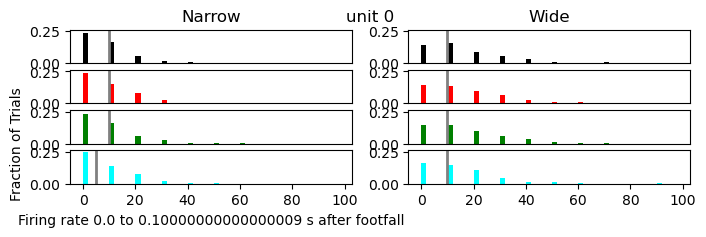

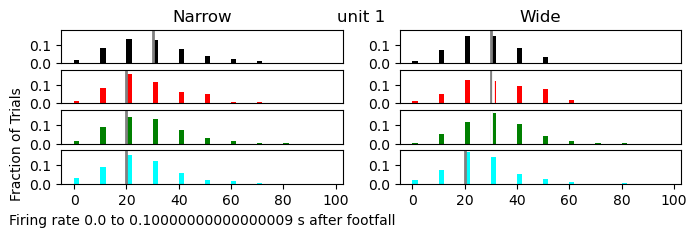

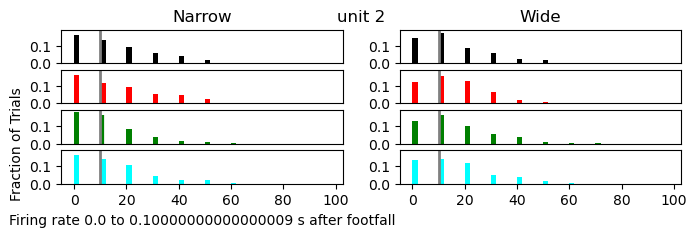

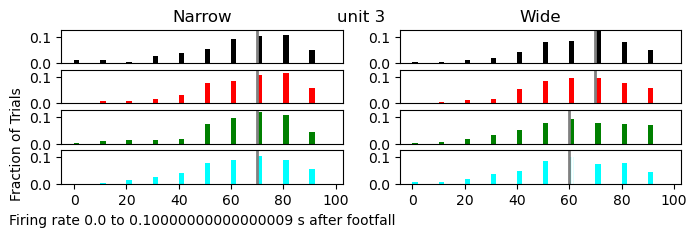

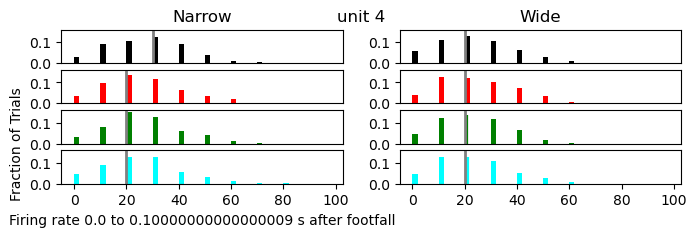

...

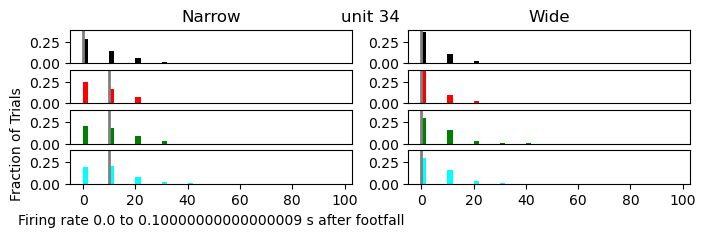

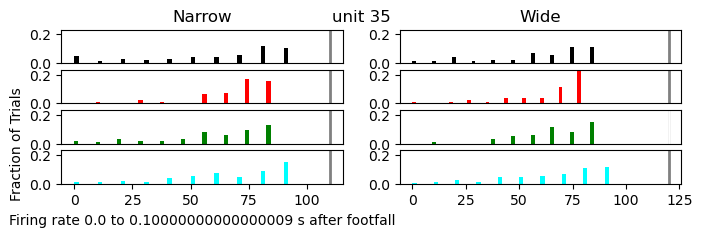

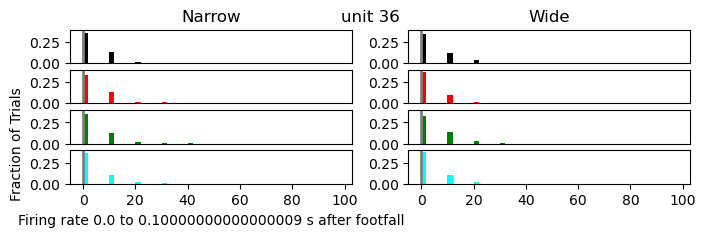

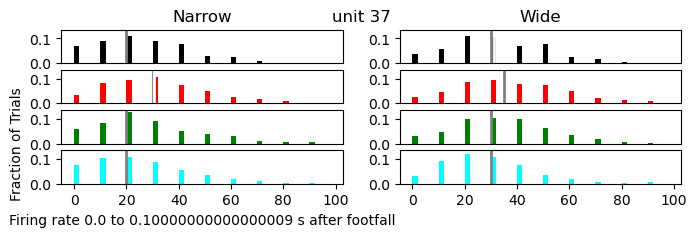

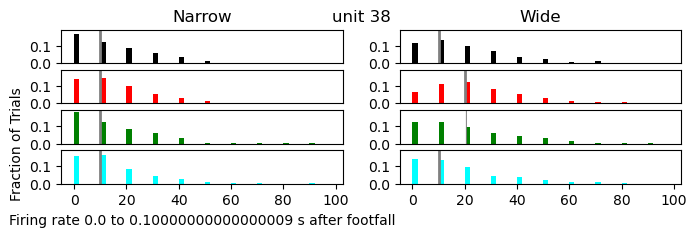

In [118]:
for unit in range(len(np.unique(goodSpikes))):

    f, ax = plt.subplots(4,2,figsize=[8,2])
    colors=['k','r','g','cyan']
    y_maxes = []
    for ori in [1,2,3,4]:
        ax[ori-1,0].hist(trialRates_narrow[ori][:,unit],np.arange(0,100,2),color=colors[ori-1],density=True)
        ax[ori-1,0].axvline(np.median(trialRates_narrow[ori][:,unit]),color='gray',lw=2)
        ax[ori-1,0].axvline(np.mean(trialRates_narrow[ori][:,unit]),color='white',lw=2)
        
        ax[ori-1,1].hist(trialRates_wide[ori][:,unit],np.arange(0,100,2),color=colors[ori-1],density=True)
        ax[ori-1,1].axvline(np.median(trialRates_wide[ori][:,unit]),color='gray',lw=2)
        ax[ori-1,1].axvline(np.mean(trialRates_wide[ori][:,unit]),color='white',lw=2)
        
        y_maxes.append(ax[ori-1,0].set_ylim()[1])
        y_maxes.append(ax[ori-1,1].set_ylim()[1])
    for ori in [1,2,3,4]:
        ax[ori-1,0].set_ylim([0,max(y_maxes)])
        ax[ori-1,1].set_ylim([0,max(y_maxes)])
    ax[0,0].set_xticks([])
    ax[1,0].set_xticks([])
    ax[2,0].set_xticks([])
    ax[0,1].set_xticks([])
    ax[1,1].set_xticks([])
    ax[2,1].set_xticks([])
    ax[1,0].set_ylabel('Fraction of Trials',ha='right')
    ax[3,0].set_xlabel('Firing rate {} to {} s after footfall'.format(psth_orient_narrow[ori]['xaxis'][window[0]]-1,psth_orient_narrow[ori]['xaxis'][window[1]]-1))
    f.suptitle('unit {}'.format(unit))
    ax[0,0].set_title('Narrow')
    ax[0,1].set_title('Wide')
    plt.show()
    plt.close()

Text(0, 0.5, 'Mean Firing Rate (Hz)')

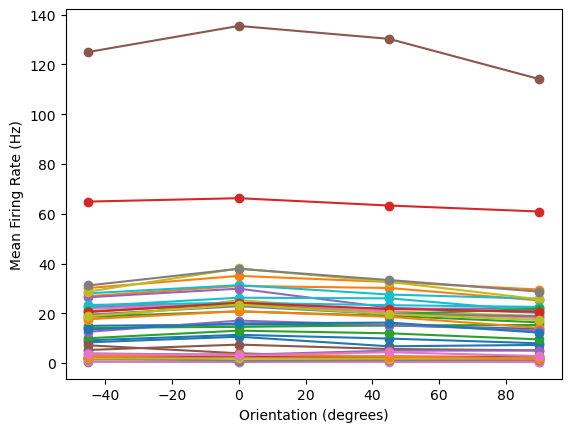

In [119]:
ax = plt.axes()
oris = [-45, 0, 45, 90]
for unit in range(len(np.unique(goodSpikes))):
    resps = []

    for ori in [1,2,3,4]:
        resps.append(np.mean(trialRates_wide[ori][:,unit]))
    ax.plot(oris,resps,marker='o')
ax.set_xlabel('Orientation (degrees)')
ax.set_ylabel('Mean Firing Rate (Hz)')    

0 0.8781909106126546 4.600313479623823
1 0.9467440448073418 16.41065830721003
2 0.9528317317521982 10.902306648575307
3 0.9984890495704092 37.991099809281636
4 0.9244669790494638 15.397329942784486
5 0.9493474894934749 0.982083609820836
6 0.9655525675502623 1.7252820172528198
7 0.7497686851033207 0.338420703384207
8 0.9082988695891923 9.93006993006993
9 0.9885413265690535 17.25705329153605
10 0.9902760588993006 4.485733244857332
11 0.926995321337083 14.043419267299864
12 0.9847865933490442 7.137042062415197
13 0.8412328412328415 0.5340114431023523
14 0.8220335813918701 4.818817546090273
15 0.8010910251574154 1.5130324221233313
16 0.9078690334635637 4.686520376175547
17 0.9905472636815917 7.367706919945725
18 0.9117277298850575 7.789968652037617
19 0.9948578342407743 6.489028213166144
20 0.7969020107360568 1.9200626959247646
21 0.922735944338458 3.900949796472184
22 0.961551724137931 3.056426332288401
23 0.8527882374036219 0.2606484424666242
24 0.9363920980686126 4.655172413793103
25 0.

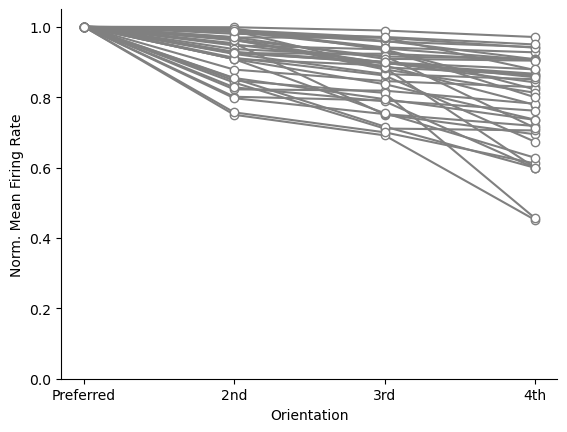

In [164]:
ax = plt.axes()
oris = [-45, 0, 45, 90]
for unit in range(len(np.unique(goodSpikes))):
    resps = []

    for ori in [1,2,3,4]:
        resps.append(np.mean(trialRates_narrow[ori][:,unit]))
    ax.plot([1,2,3,4],np.sort(resps)[::-1]/np.max(resps),marker='o',color='gray',markerfacecolor='white')
    print(unit,np.sort(resps)[::-1][1]/np.max(resps),np.sort(resps)[::-1][1])
ax.set_ylabel('Norm. Mean Firing Rate')    
ax.set_xticks([1,2,3,4])
ax.set_xticklabels(['Preferred','2nd','3rd','4th'])
ax.set_ylim([0,1.05])
ax.set_xlabel('Orientation')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
print(len(np.unique(goodSpikes)))
plt.savefig('Preferred_Oris_Mean_Rate.pdf',transparent=True,bbox_inches='tight')

In [155]:
## narrow Gratings
pvalues = []
for unit in range(len(np.unique(goodSpikes))):
    print(unit,scipy.stats.kruskal(trialRates_narrow[1][:,unit],trialRates_narrow[2][:,unit],trialRates_narrow[3][:,unit],trialRates_narrow[4][:,unit])[1])
    pvalues.append(scipy.stats.kruskal(trialRates_narrow[1][:,unit],trialRates_narrow[2][:,unit],trialRates_narrow[3][:,unit],trialRates_narrow[4][:,unit])[1])
    
import statsmodels.stats.multitest
print(np.sum(np.array(pvalues) < 0.05))
OSunits = np.where(statsmodels.stats.multitest.multipletests(pvalues)[0])[0]
print(OSunits)
print(len(OSunits))
print(len(np.unique(goodSpikes)))

0 0.08780754577008348
1 0.0005517233859833348
2 1.6776990631957973e-08
3 0.2553316793229686
4 0.023456581033419136
5 0.4244733572629712
6 0.10476799968404121
7 0.0820950589531178
8 3.52938980994192e-05
9 0.09997680370972231
10 0.3899392191961064
11 0.06482216326191298
12 0.6422748028324645
13 0.2261813458926272
14 0.004736489434184712
15 0.04746480999299216
16 0.0002718636151414641
17 0.04354385796214575
18 7.467466753318932e-07
19 0.002628546377784215
20 0.024903132891429338
21 0.702471925130325
22 0.5296288834271587
23 0.32581132254274153
24 0.001305259809520645
25 0.237409763738794
26 0.3528485923435653
27 1.1591572929710857e-06
28 0.006306367666994931
29 0.2596007416259366
30 0.058333121375140205
31 0.29940563061523084
32 0.3704173142489936
33 0.041155992426976595
34 3.625282642988324e-11
35 4.3388317275579404e-05
36 0.11316360855480077
37 0.005108441133874886
38 0.32792566976281984
18
[ 1  2  8 16 18 24 27 34 35]
9
39


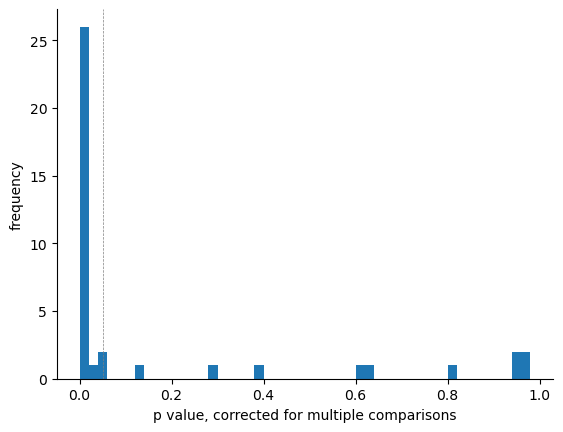

In [165]:

ax = plt.axes()
ax.hist(statsmodels.stats.multitest.multipletests(pvalues)[1],np.arange(0,1,0.02))
ax.axvline(0.05,color='gray',ls='--',lw=0.5)
ax.set_xlabel('p value, corrected for multiple comparisons')
ax.set_ylabel('frequency')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

In [168]:
OSunits_narrow

array([ 9, 39, 60, 68, 86, 87, 98, 99])

9 0.9528317317521982 10.902306648575307
39 0.9082988695891923 9.93006993006993
60 0.9078690334635637 4.686520376175547
68 0.9117277298850575 7.789968652037617
86 0.7566137566137566 2.727272727272727
87 0.8276763886519983 1.5956770502225046
98 0.9080274550110622 4.8374253483742535
99 0.9704199259661147 61.95141065830721
39


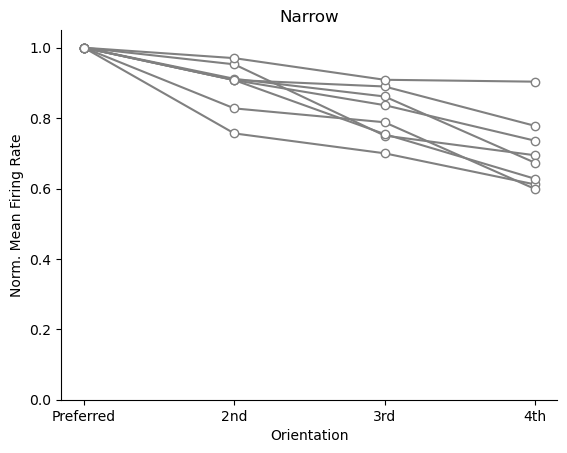

In [169]:
ax = plt.axes()
oris = [-45, 0, 45, 90]
for i, unit in enumerate(np.unique(goodSpikes)):
    if unit in OSunits_narrow:
        resps = []

        for ori in [1,2,3,4]:
            resps.append(np.mean(trialRates_narrow[ori][:,i]))
        ax.plot([1,2,3,4],np.sort(resps)[::-1]/np.max(resps),marker='o',color='gray',markerfacecolor='white')
        print(unit,np.sort(resps)[::-1][1]/np.max(resps),np.sort(resps)[::-1][1])
ax.set_ylabel('Norm. Mean Firing Rate')    
ax.set_xticks([1,2,3,4])
ax.set_xticklabels(['Preferred','2nd','3rd','4th'])
ax.set_ylim([0,1.05])
ax.set_xlabel('Orientation')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
print(len(np.unique(goodSpikes)))
ax.set_title('Narrow')
plt.savefig('Preferred_Oris_Mean_Rate_OSTuned_narrowGratings.pdf',transparent=True,bbox_inches='tight')

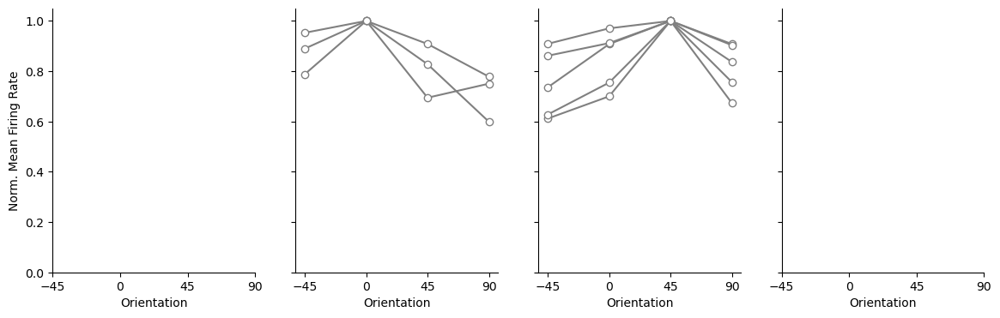

In [171]:
f, ax = plt.subplots(1,4,figsize=[14,4])
oris = [-45, 0, 45, 90]
for i, unit in enumerate(np.unique(goodSpikes)):
    if unit in OSunits_narrow:
        resps = []
        for ori in [1,2,3,4]:
            resps.append(np.mean(trialRates_narrow[ori][:,i]))
        ax[np.argmax(resps)].plot([-45,0,45,90],resps/np.max(resps),marker='o',color='gray',markerfacecolor='white')
ax[0].set_ylabel('Norm. Mean Firing Rate')    
#ax.set_ylim([0,1.05])
for a in range(4):
    ax[a].set_xlabel('Orientation')
    ax[a].spines['top'].set_visible(False)
    ax[a].spines['right'].set_visible(False)
    ax[a].set_ylim([0,1.05])
    ax[a].set_xticks([-45,0,45,90])
    if a > 0:
        ax[a].set_yticklabels([])
plt.savefig('Oris_Mean_Rate_OSTuned_narrowGratings.pdf',transparent=True,bbox_inches='tight')

In [172]:
## wide Gratings
pvalues = []
for unit in range(len(np.unique(goodSpikes))):
    print(unit,scipy.stats.kruskal(trialRates_wide[1][:,unit],trialRates_wide[2][:,unit],trialRates_wide[3][:,unit],trialRates_wide[4][:,unit])[1])
    pvalues.append(scipy.stats.kruskal(trialRates_wide[1][:,unit],trialRates_wide[2][:,unit],trialRates_wide[3][:,unit],trialRates_wide[4][:,unit])[1])
    
import statsmodels.stats.multitest
print(np.sum(np.array(pvalues) < 0.05))
OSunits = np.where(statsmodels.stats.multitest.multipletests(pvalues)[0])[0]
print(OSunits)
print(len(OSunits))
print(len(np.unique(goodSpikes)))

0 2.300470581283995e-05
1 8.221377729814777e-11
2 0.008316246646768442
3 0.004027406575307425
4 0.9343889368831291
5 0.03558594653601017
6 0.00031408970365688854
7 0.1574271753670774
8 3.774710811423992e-06
9 0.0007996155423988929
10 2.7394819967283875e-06
11 8.212067978748851e-10
12 0.00038660662856171516
13 0.3244401096573606
14 1.5138231697497463e-08
15 0.0008336188432703024
16 0.00014239974263308714
17 1.396880620880017e-06
18 5.378142670898575e-09
19 3.302194726609815e-11
20 9.082507354306951e-07
21 2.275187860363805e-08
22 1.9204897365748568e-08
23 0.13016975779469353
24 1.0436477226747917e-06
25 3.611766489437372e-13
26 0.725123783835715
27 4.84316118702458e-06
28 0.6739689420301231
29 0.3594202718494847
30 0.00022037221570608045
31 0.0002589625528288273
32 0.09227038332878558
33 0.001509772630536881
34 3.305357746232966e-14
35 2.2634219257583338e-17
36 0.0005250013972648933
37 5.942855588881225e-14
38 0.00041976143143080004
31
[ 0  1  3  6  8  9 10 11 12 14 15 16 17 18 19 20 21

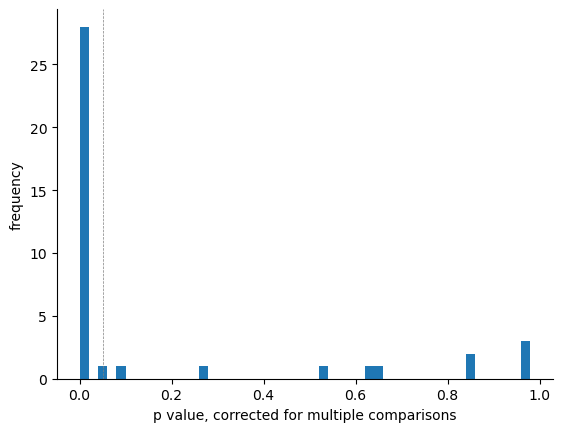

In [173]:

ax = plt.axes()
ax.hist(statsmodels.stats.multitest.multipletests(pvalues)[1],np.arange(0,1,0.02))
ax.axvline(0.05,color='gray',ls='--',lw=0.5)
ax.set_xlabel('p value, corrected for multiple comparisons')
ax.set_ylabel('frequency')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

6 0.9269216205982581 7.11576193590582
8 0.8824332938712321 16.899934597776323
9 0.9500061117222833 9.813131313131313
39 0.8769094453304979 10.787878787878787
40 0.9482519515030727 16.595959595959595
41 0.8415489055139928 4.4141414141414135
47 0.9453383239354461 16.958796599084366
48 0.9921152983845687 9.08436886854153
58 0.8514308114464916 14.205362982341398
59 0.8528765432098766 2.51010101010101
60 0.9246935088398501 10.414141414141413
67 0.9434473507712945 15.333333333333334
68 0.926401412146367 14.11111111111111
69 0.9411100022460305 14.7678221059516
70 0.9114018087855295 4.1010101010101
71 0.9814007907689821 8.838383838383837
73 0.9054531522710825 4.637017658600392
75 0.9681242411612272 9.705689993459776
76 0.7234726688102895 1.4715500327011117
86 0.9833887043189368 1.935905820797907
90 0.9574468085106382 10.0
92 0.9003159557661928 1.2424242424242424
95 0.947534655202667 12.949640287769782
98 0.9972457627118645 2.9715909090909087
99 0.9884098505124841 72.49836494440811
104 0.996776

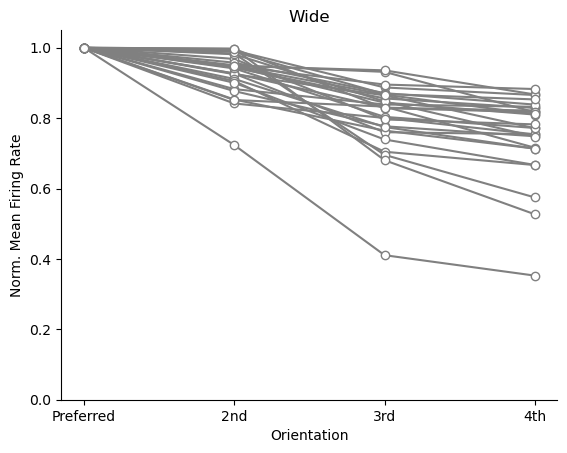

In [174]:
ax = plt.axes()
oris = [-45, 0, 45, 90]
for i, unit in enumerate(np.unique(goodSpikes)):
    if unit in OSunits_wide:
        resps = []

        for ori in [1,2,3,4]:
            resps.append(np.mean(trialRates_wide[ori][:,i]))
        ax.plot([1,2,3,4],np.sort(resps)[::-1]/np.max(resps),marker='o',color='gray',markerfacecolor='white')
        print(unit,np.sort(resps)[::-1][1]/np.max(resps),np.sort(resps)[::-1][1])
ax.set_ylabel('Norm. Mean Firing Rate')    
ax.set_xticks([1,2,3,4])
ax.set_xticklabels(['Preferred','2nd','3rd','4th'])
ax.set_ylim([0,1.05])
ax.set_xlabel('Orientation')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
print(len(np.unique(goodSpikes)))
ax.set_title('Wide')
plt.savefig('Preferred_Oris_Mean_Rate_OSTuned_wideGratings.pdf',transparent=True,bbox_inches='tight')

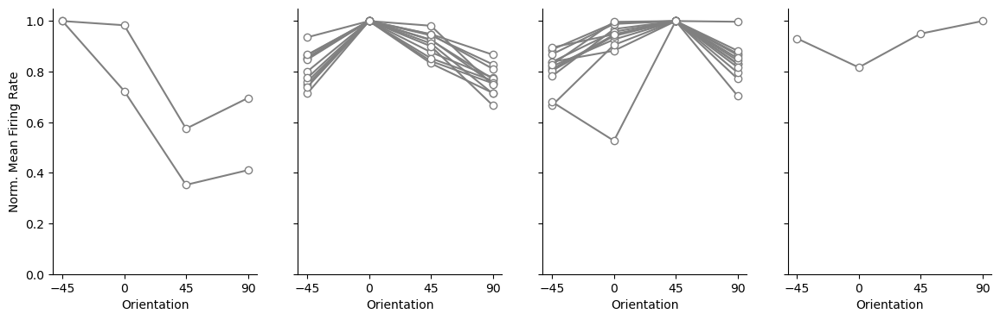

In [176]:
f, ax = plt.subplots(1,4,figsize=[14,4])
oris = [-45, 0, 45, 90]
for i, unit in enumerate(np.unique(goodSpikes)):
    if unit in OSunits_wide:
        resps = []
        for ori in [1,2,3,4]:
            resps.append(np.mean(trialRates_wide[ori][:,i]))
        ax[np.argmax(resps)].plot([-45,0,45,90],resps/np.max(resps),marker='o',color='gray',markerfacecolor='white')
ax[0].set_ylabel('Norm. Mean Firing Rate')    
#ax.set_ylim([0,1.05])
for a in range(4):
    ax[a].set_xlabel('Orientation')
    ax[a].spines['top'].set_visible(False)
    ax[a].spines['right'].set_visible(False)
    ax[a].set_ylim([0,1.05])
    ax[a].set_xticks([-45,0,45,90])
    if a > 0:
        ax[a].set_yticklabels([])
plt.savefig('Oris_Mean_Rate_OSTuned_wideGratings.pdf',transparent=True,bbox_inches='tight')

In [244]:
speedFiles = glob.glob("*pixelDistance.npy")

In [245]:
speed = []
for file in speedFiles:
    speed.append(np.load(file))
speed = np.concatenate(speed)/5.8*200/10 # converting to cm/second

speed_pd = pd.DataFrame(speed)
speed_MA20 = speed_pd[0].rolling(20).median().fillna(method='ffill').fillna(method='bfill')


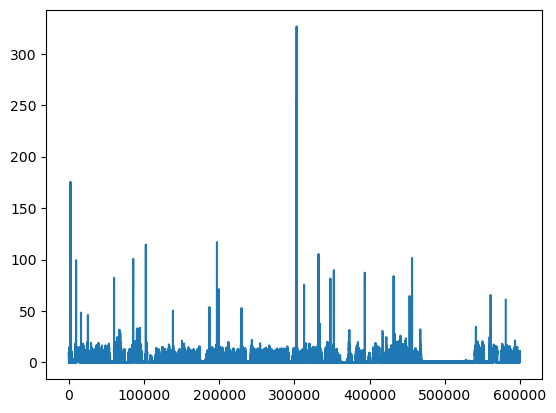

In [227]:
plt.plot(speed)

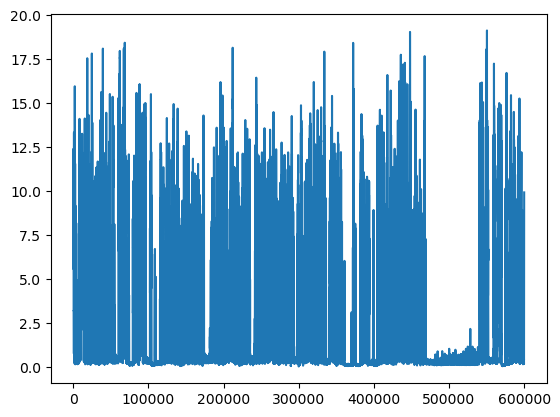

In [228]:
plt.plot(speed_MA20)

In [229]:
i

539982

In [230]:
i = 0
speed_sweeps = []
for sweep, frames in enumerate(frameSamples_sweeps):
    speed_sweeps.append(np.zeros(ventralTrigger_sweeps[sweep].shape))
    for frame0, frame1 in zip(frames[:-1],frames[1:]):           
        speed_sweeps[sweep][frame0:frame1] = speed_MA20[i]
        i += 1
                        

In [231]:
frameSamples_sweeps[0][-1]

5999898

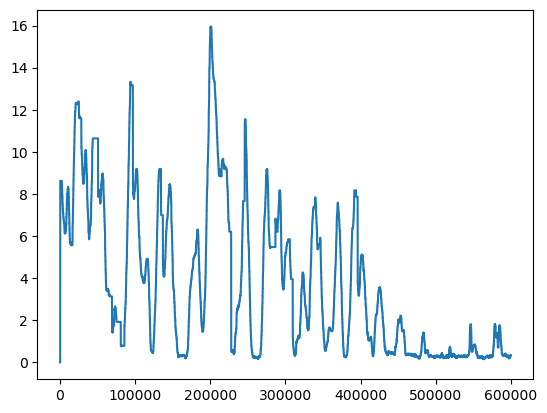

In [236]:
plt.plot(speed_sweeps[0][:600000])

In [237]:
testSingleTrialPSTH = analyzeMEA.rastPSTH.singleSweepPSTH(0.5,goodsamples_sweeps,goodspikes_sweeps,)

In [238]:
testSingleTrialPSTH['psths'].shape

(600, 10, 39)

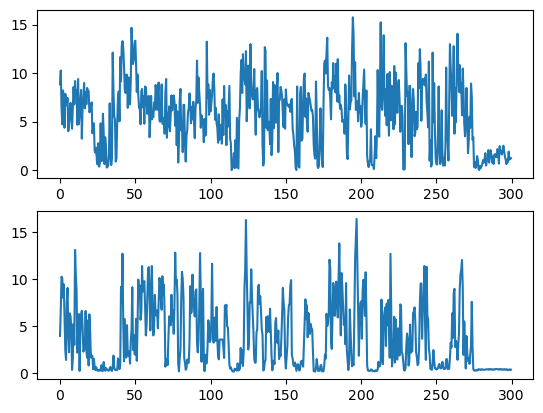

In [239]:
f, ax = plt.subplots(2,1)
ax[0].plot(testSingleTrialPSTH['xaxis'],testSingleTrialPSTH['psths'][:,0,:].mean(axis=-1))
xaxis_speed = np.arange(0,len(speed_sweeps[0])/20000,1/200)
ax[1].plot(xaxis_speed[::100],np.convolve(speed_MA20[:len(xaxis_speed)],np.ones(100)/100,mode='same')[::100])

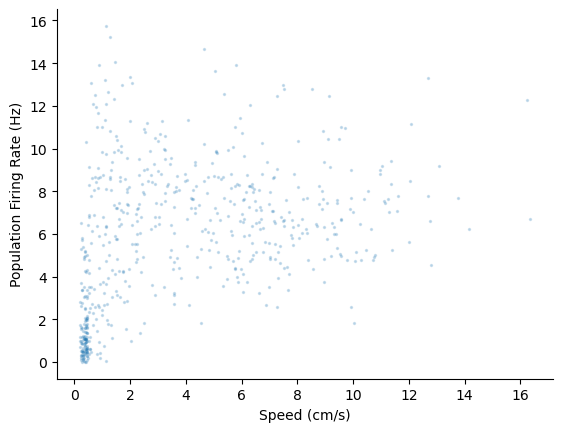

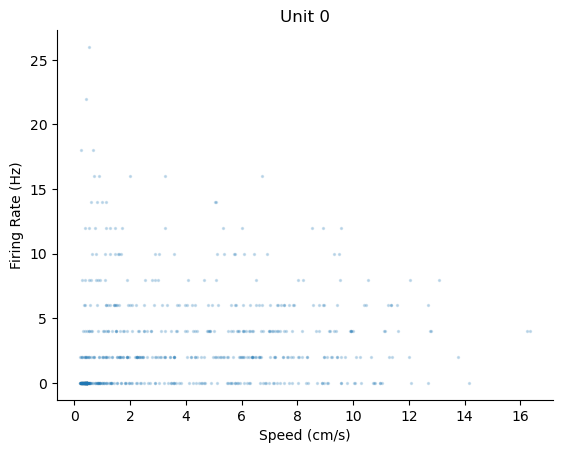

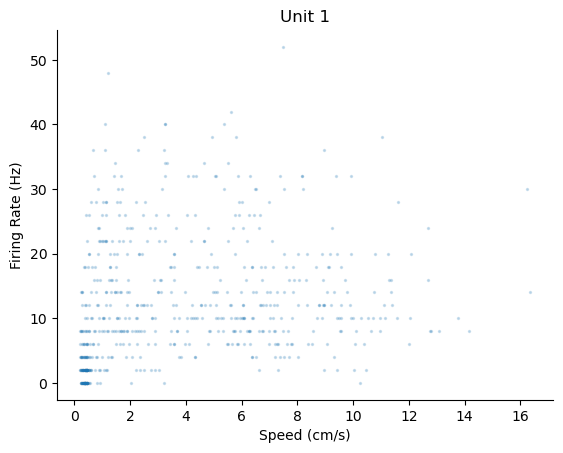

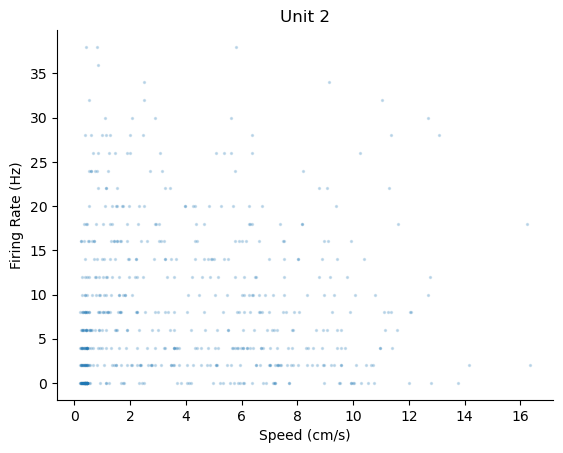

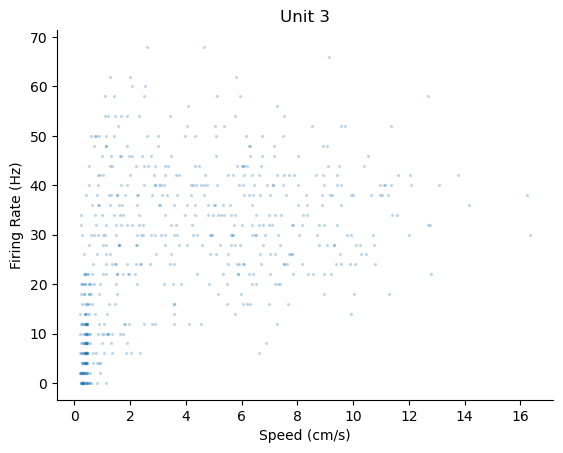

...

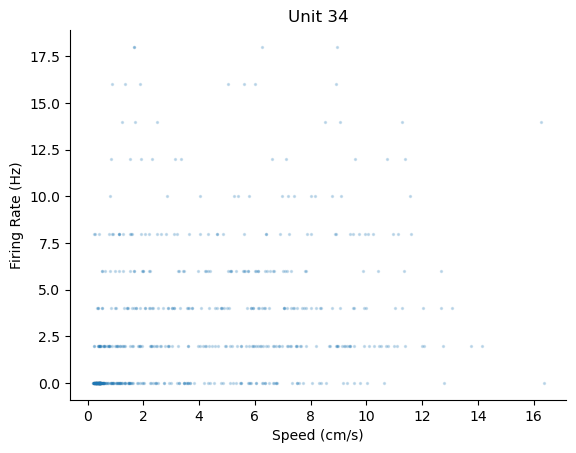

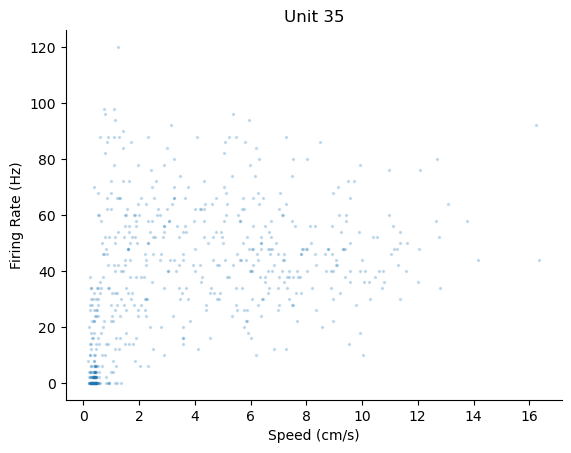

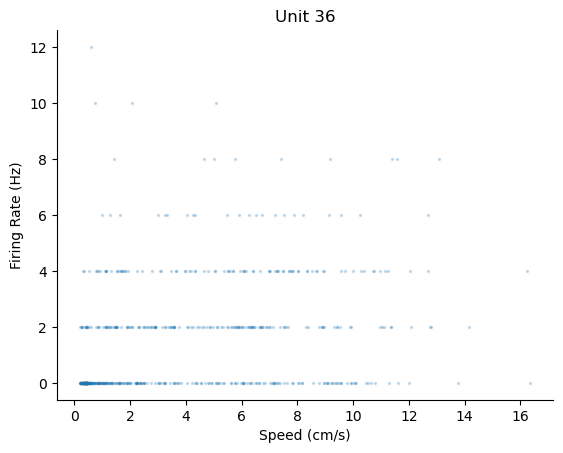

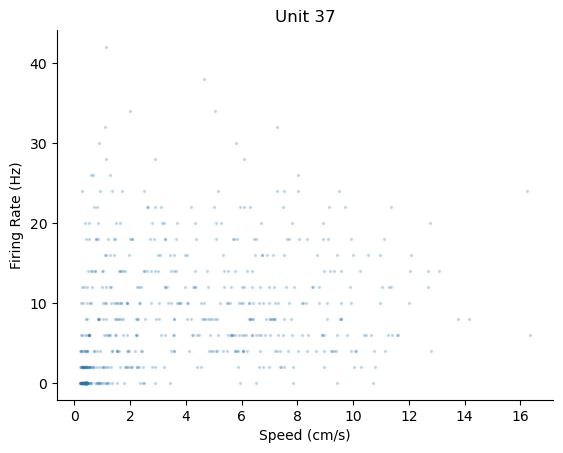

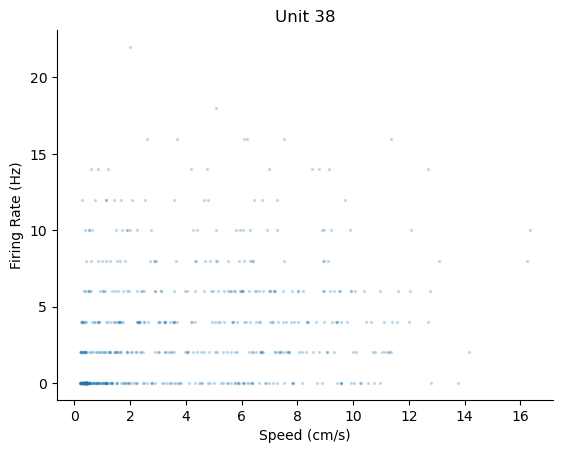

In [224]:
plt.scatter(np.convolve(speed_MA20[:len(xaxis_speed)],np.ones(100)/100,mode='same')[::100],testSingleTrialPSTH['psths'][:,0,:].mean(axis=-1),2,alpha=0.2)
plt.xlabel('Speed (cm/s)')
plt.ylabel('Population Firing Rate (Hz)')
sns.despine()
plt.show()
plt.close()

for unit in range(len(np.unique(goodSpikes))):
    plt.scatter(np.convolve(speed_MA20[:len(xaxis_speed)],np.ones(100)/100,mode='same')[::100],testSingleTrialPSTH['psths'][:,0,unit],2,alpha=0.2)
    plt.xlabel('Speed (cm/s)')
    plt.ylabel('Firing Rate (Hz)')
    plt.title('Unit {}'.format(unit))
    sns.despine()
    plt.show()
    plt.close()


In [240]:
footfalls[:50]

array([  21,   74,  150,  173,  225,  391,  462,  482,  617,  749,  809,
        913, 1125, 1244, 1328, 1418, 1532, 1712, 1753, 1806, 1932, 1968,
       2034, 2121, 2190, 2409, 2436, 2781, 2833, 2937, 2960, 3189, 3428,
       3626, 3652, 3735, 3876, 3971, 4233, 4475, 7086, 8058, 8082, 8103,
       8130, 8203, 8258, 8282, 8325, 8358], dtype=int64)

In [241]:
np.convolve(speed_MA20[:len(xaxis_speed)],np.ones(200),mode='same')/20

array([36.77517858, 37.18685403, 37.5995687 , ...,  2.08235617,
        2.0616921 ,  2.04146453])

In [242]:
np.convolve(speed_sweeps[0],np.ones(20000),mode='same')

array([71932.28381764, 71940.39323027, 71948.5026429 , ...,
        4012.53544409,  4012.12216279,  4011.70888149])

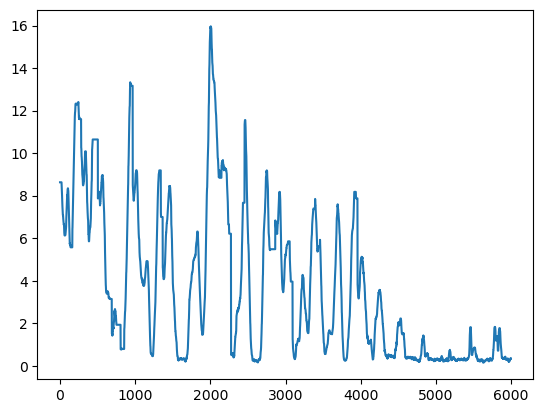

In [243]:
plt.plot(speed_MA20[:6000])

In [321]:
ventralTrigger_sweeps[3].shape

(5999998,)